In [1]:
# import necessary packages
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

In [2]:
# set the parameters for figure
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(8,8))
#plt.rcParams['figure.figsize'] = (6,6)

In [3]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


# Load raw data

In [4]:
adata = sc.read_10x_h5('project/filtered_feature_bc_matrix.h5', gex_only=False)
adata

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 52081 × 194756
    var: 'gene_ids', 'feature_types', 'genome'

In [5]:
adata.var_names_make_unique()
adata

AnnData object with n_obs × n_vars = 52081 × 194756
    var: 'gene_ids', 'feature_types', 'genome'

In [6]:
adata.obs['samp'] = [idx.split('-')[1] for idx in adata.obs_names]

In [7]:
adata.obs['samp'].value_counts()

5    10062
1     8442
2     8341
6     8246
4     6319
3     5626
8     2355
7     1649
9     1041
Name: samp, dtype: int64

In [8]:
sample_map = {'1': 'S1D1',
 '2': 'S1D2',
 '3': 'S1D3',
 '4': 'S2D1',
 '5': 'S2D4',
 '6': 'S2D5',
 '7': 'S3D1',
 '8': 'S3D6',
 '9': 'S3D7',              
}

adata.obs['sample'] = [sample_map[s] for s in adata.obs['samp']]
del adata.obs['samp']

In [9]:
adata.obs['sample'].value_counts()

S2D4    10062
S1D1     8442
S1D2     8341
S2D5     8246
S2D1     6319
S1D3     5626
S3D6     2355
S3D1     1649
S3D7     1041
Name: sample, dtype: int64

In [10]:
adata_s2d1 = adata[adata.obs['sample'].isin(['S2D1'])].copy()

In [11]:
adata_atac = adata_s2d1[:,adata_s2d1.var['feature_types'].isin(['Peaks'])].copy()
adata_gex = adata_s2d1[:,adata_s2d1.var['feature_types'].isin(['Gene Expression'])].copy()
adata_atac
adata_gex

AnnData object with n_obs × n_vars = 6319 × 36601
    obs: 'sample'
    var: 'gene_ids', 'feature_types', 'genome'

In [12]:
adata_gex.var_names_make_unique()

# Test R methods

Note: you might have to set your `.libPaths()` variable to only track the libraries from your conda environment. This can be done by writing something like the following into a jupyter cell:

```
%R .libPaths(.libPaths()c[3,2])
```

The `c[3,2]` should be altered here to give priority to the relevant libraries. Note that the first library is given priority (in this example, the library originally in 3rd position in the `.libPaths()` output.

In [13]:
import rpy2.rinterface_lib.callbacks
import logging
from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [14]:
%R library(scran)

'scran','scuttle','SingleCe...,...,'datasets','methods','base'


# QC

QC is done mainly by filtering jointly on the number of counts, the number of genes, and considering the fraction of mitochondrial reads

In [15]:
# Compute QC metrics
adata_gex.var["mt"] = adata_gex.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata_gex, qc_vars=["mt"], inplace=True)

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


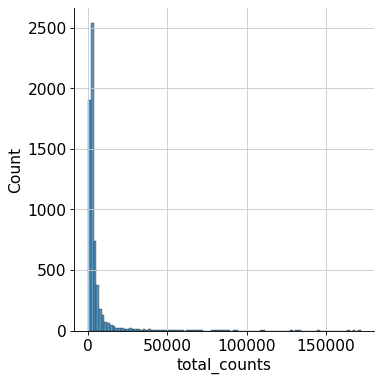

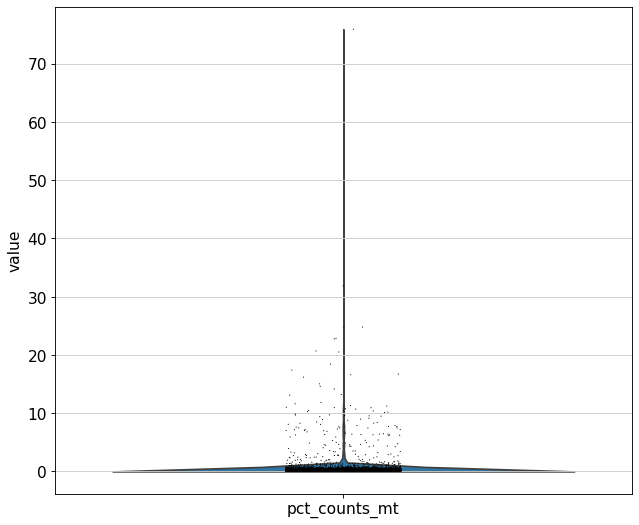

In [16]:
t1 = sns.displot(adata_gex.obs['total_counts'], bins=100, kde=False)
t2 = sc.pl.violin(adata_gex, 'pct_counts_mt')

Note there is quite low MT read fraction (mostly <5%), so might not need to filter on this, unless this coincides with low count depth and low number of genes.

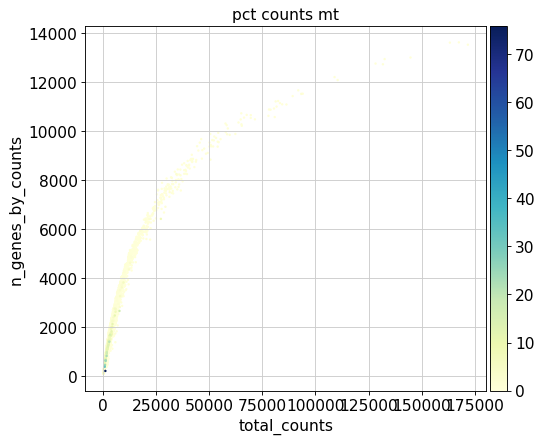

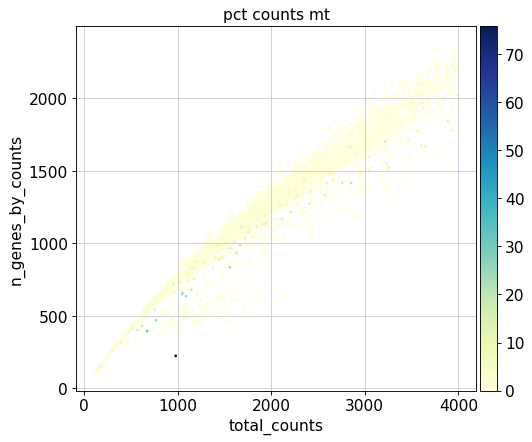

In [17]:
#Data quality summary plots
plt.rcParams['figure.figsize'] = (6,6)
p1 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt')
p2 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<4000], 'total_counts', 'n_genes_by_counts', color='pct_counts_mt')

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


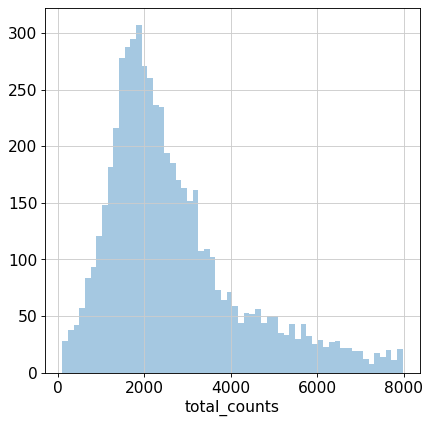

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


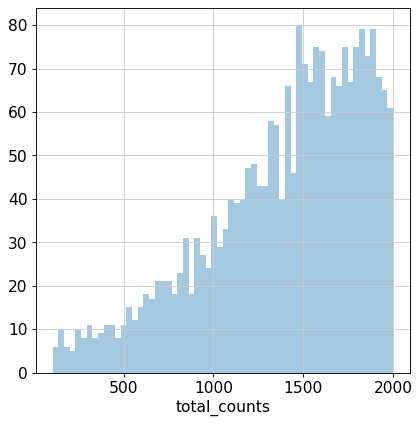

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


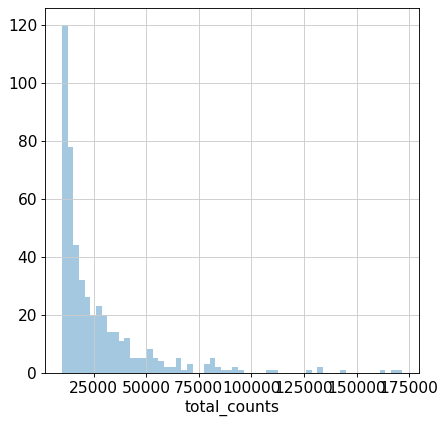

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


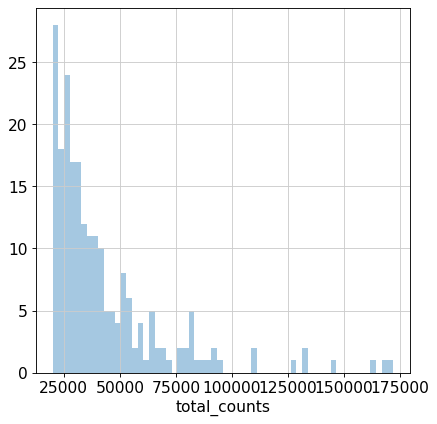

In [18]:
#Thresholding decision: counts
# Here we check the univariate distributions for low-quality outlier peaks. We especially zoom in on lower values
p3 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<8000], kde=False, bins=60)
plt.show()

p4 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<2000], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>10000], kde=False, bins=60)
plt.show()

p6 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>20000], kde=False, bins=60)
plt.show()

Thresholding options:

Lower bound:
- 250
- 750 -> use this
- 1000

Upper bound:
- 25,000 -> go for this
- 32,000
- 51,000

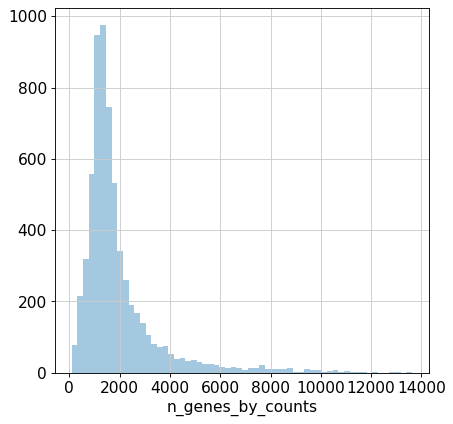

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


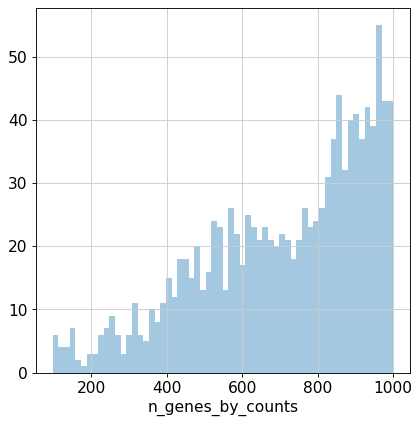

In [19]:
#Thresholding decision: genes

p7 = sns.distplot(adata_gex.obs['n_genes_by_counts'], kde=False, bins=60)
plt.show()

p8 = sns.distplot(adata_gex.obs['n_genes_by_counts'][adata_gex.obs['n_genes_by_counts']<1000], kde=False, bins=60)
plt.show()


Gene thresholding options:
- 300 -> try this first
- 600

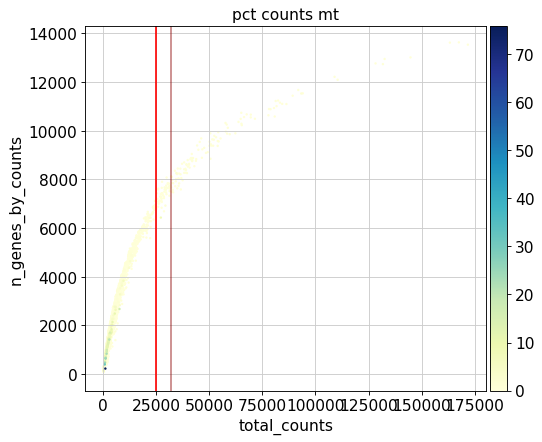

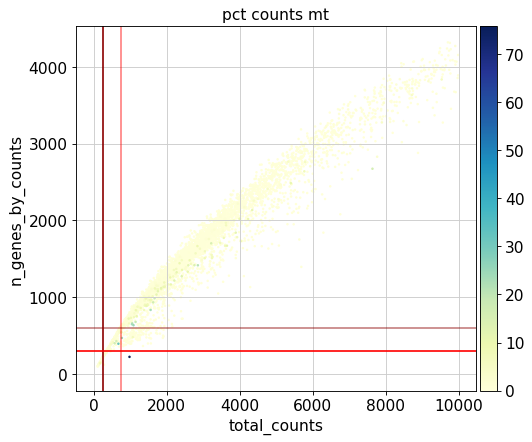

In [20]:
# Visualize the chosen thresholds jointly, before filtering out cells
counts_upper = 25000
counts_upper_alt = 32000
counts_lower = 750
counts_lower_alt = 250
genes_lower = 300
genes_lower_alt = 600

p9 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt', show=False)
p9.axline((counts_upper,0),(counts_upper,1), color='red')
p9.axline((counts_upper_alt,0),(counts_upper_alt,1), color='darkred', alpha=0.5)
plt.show()

count_lim = 10000
p10 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<count_lim], 'total_counts', 'n_genes_by_counts', color='pct_counts_mt', show=False)
p10.axline((counts_lower,0),(counts_lower,1), color='red', alpha=0.5)
p10.axline((counts_lower_alt,0),(counts_lower_alt,1), color='darkred')
p10.axline((0,genes_lower),(1,genes_lower), color='red')
p10.axline((0,genes_lower_alt),(1,genes_lower_alt), color='darkred', alpha=0.5)
plt.show()

Final thresholding decisions:
- Counts lower: 750 (but 250 might work too)
- Counts upper: 25k is fine
- Genes: 300 is final
- no MT threshold is needed

These thresholds were chosen to preserve the group of cells moving away from the main distribution at around 620 counts, but still remove most higher MT fraction cells. Using a less permissive upper count threshold is fine, as these cells are often challenging to annotate and might be doublets.

In [21]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_counts = 750)
print('Number of cells after min count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, max_counts = 25000)
print('Number of cells after max count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_genes = 300)
print('Number of cells after gene filter: {:d}'.format(adata_gex.n_obs))

Total number of cells: 6319
Number of cells after min count filter: 6079
Number of cells after max count filter: 5907
Number of cells after gene filter: 5906


In [22]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_gex.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_gex, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_gex.n_vars))

Total number of genes: 36601
Number of genes after cell filter: 17431


# Normalization

In [23]:
#Perform a clustering for scran normalization in clusters
adata_pp = adata_gex.copy()
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.leiden(adata_pp, key_added='groups', resolution=0.5)

In [24]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata_gex.X.T.A

In [25]:
%%R -i data_mat -i input_groups -o size_factors

size_factors = sizeFactors(computeSumFactors(SingleCellExperiment(list(counts=data_mat)), clusters=input_groups, min.mean=0.1))

In [26]:
#Delete adata_pp
del adata_pp

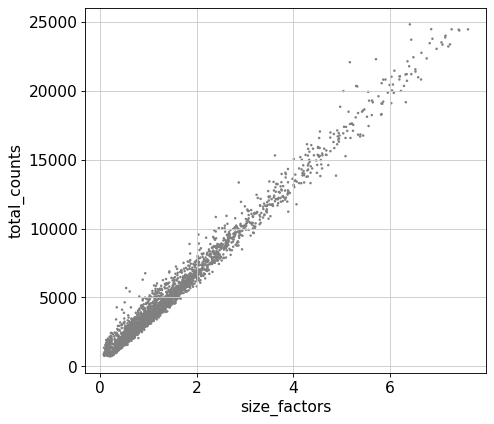

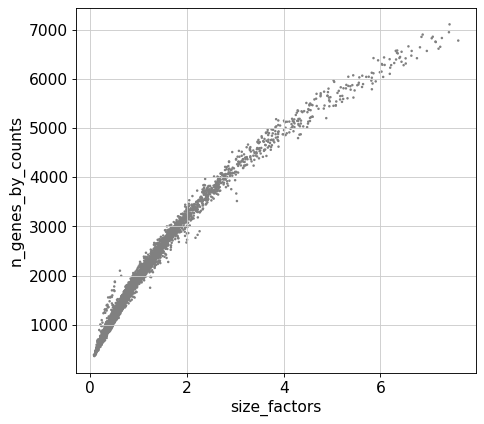

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


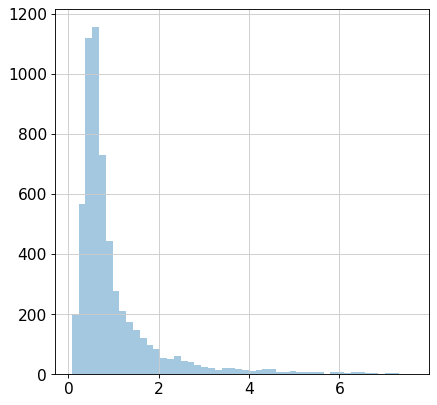

In [27]:
# Visualize the estimated size factors
adata_gex.obs['size_factors'] = size_factors

sc.pl.scatter(adata_gex, 'size_factors', 'total_counts')
sc.pl.scatter(adata_gex, 'size_factors', 'n_genes_by_counts')

sns.distplot(size_factors, bins=50, kde=False)
plt.show()

No size factorss are below 0, and the range of size factors is manageable (not >10, and mostly <4)

In [28]:
#Keep the count data in a counts layer
adata_gex.layers["counts"] = adata_gex.X.copy()

#Normalize adata 
adata_gex.X /= adata_gex.obs['size_factors'].values[:,None]
sc.pp.log1p(adata_gex)

#Transform back into a sparse matrix
adata_gex.X = sp.sparse.csr_matrix(adata_gex.X)

#Store the full data set in 'raw' as log-normalised data for statistical testing
adata_gex.raw = adata_gex

# HVGs

In [29]:
sc.pp.highly_variable_genes(adata_gex, flavor='cell_ranger', n_top_genes=4000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata_gex.var['highly_variable'])))


 Number of highly variable genes: 4000


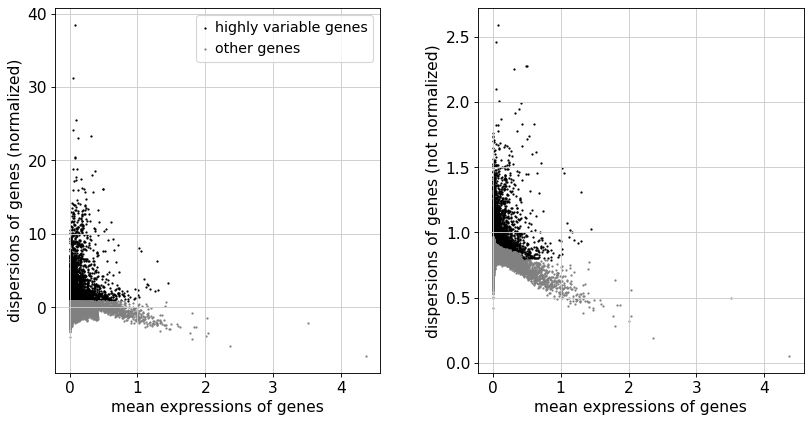

In [30]:
sc.pl.highly_variable_genes(adata_gex)

# Visualization

In [31]:
# Calculate the visualizations
sc.pp.pca(adata_gex, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_gex)
sc.tl.umap(adata_gex)

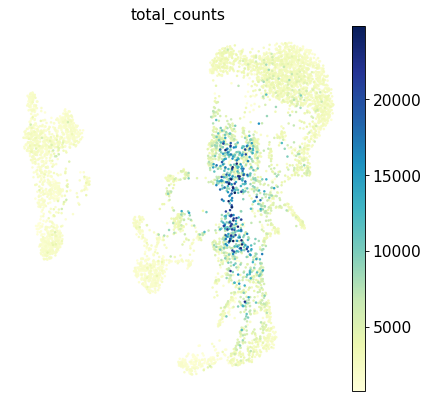

In [32]:
sc.pl.umap(adata_gex, color='total_counts')

We see a high count area aggregated in the middle of the UMAP... this can be problematic, but we can deal with this later as well.

# CC scoring

In [33]:
cc_genes_file = '~/gene_lists/Macosko_cell_cycle_genes.txt'

In [34]:
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

s_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, s_genes)]
g2m_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, g2m_genes)]

sc.tl.score_genes_cell_cycle(adata_gex, s_genes=s_genes_ens, g2m_genes=g2m_genes_ens)

... storing 'phase' as categorical


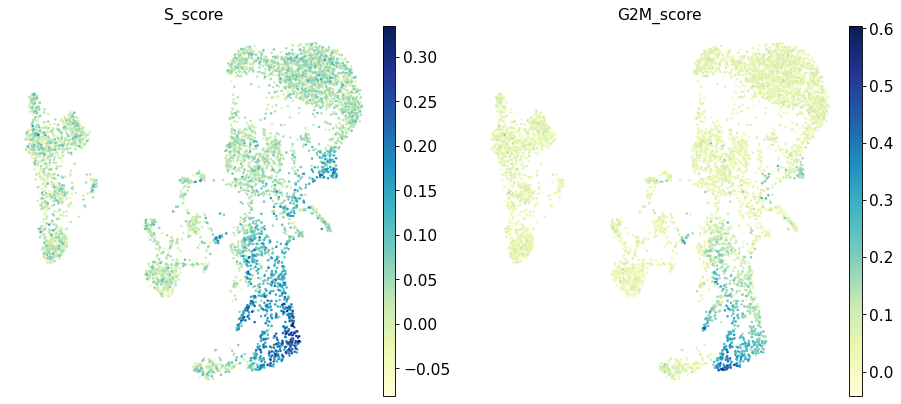

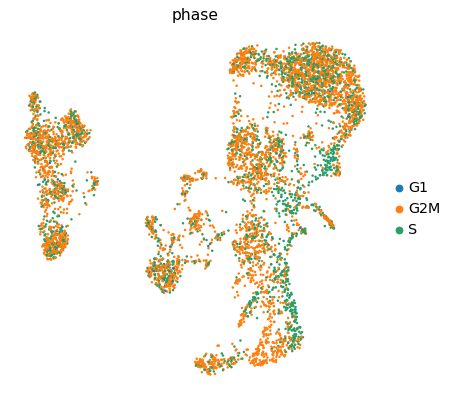

In [35]:
sc.pl.umap(adata_gex, color=['S_score', 'G2M_score'], use_raw=False)
sc.pl.umap(adata_gex, color='phase', use_raw=False)

There is 1 cluster with a clear cell cycle separation, this is likely cycling erythroblasts. This gives the first hint at where the erythrocyte differentiation trajectory is.

# Clustering

Let the fun begin! First step, cluster at several resolutions and select the resolution that broadly captures the structure you see in the UMAP. Try to avoid getting into detailed substructure already at this early stage.

In [36]:
sc.tl.leiden(adata_gex, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_gex, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_gex, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_gex, resolution=1, key_added='leiden_res1')

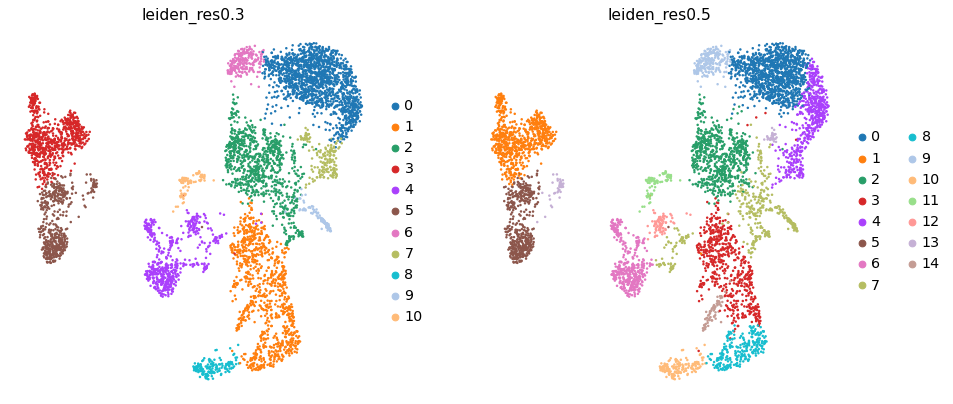

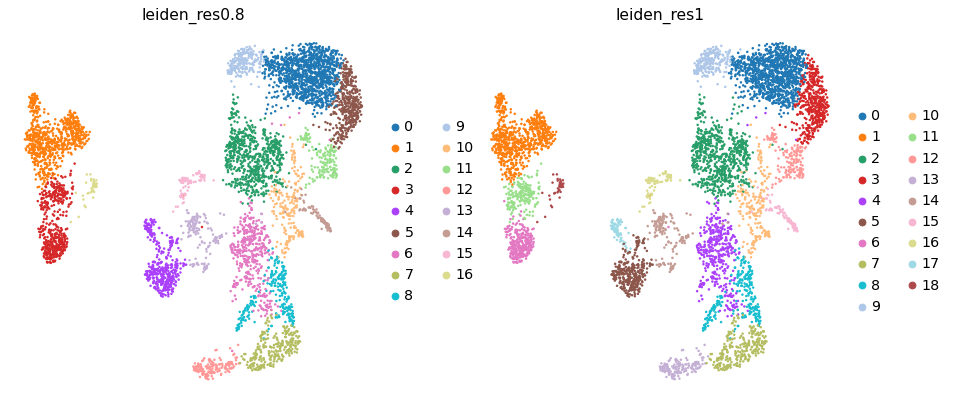

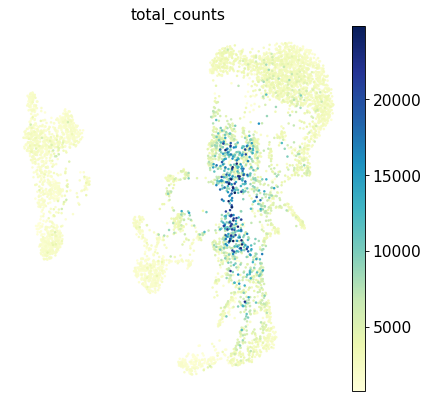

In [37]:
sc.pl.umap(adata_gex, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_gex, color=['leiden_res0.8', 'leiden_res1'])
sc.pl.umap(adata_gex, color='total_counts')

Check which clusters have the problematic aggregation of high-count cells... these might be difficult to annotate and could be doublets.

# Doublet detection

Doublet detection to gain extra evidence for which cells are actually two separate cells that happen to be assigned to the same barcode (doublets).

In [38]:
test_dat = adata_gex.copy()
test_dat.X = adata_gex.raw.X

In [39]:
sc.external.pp.scrublet(test_dat)

/srv/conda/envs/saturn/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.56
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.9%


In [40]:
sc.external.pl.scrublet_score_distribution(test_dat)

(<Figure size 640x240 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

The distribution of simulated doublets show that potentially a score over 0.25 is already indicative of a doublet. Note that not all doublets will be detectable in this way and it will be more valuable to remove entire clusters based on these scores.

In [41]:
adata_gex.obs['doublet_score'] = test_dat.obs['doublet_score']
adata_gex.obs['predicted_doublet'] = test_dat.obs['predicted_doublet'].astype(str)

In [42]:
del test_dat

... storing 'predicted_doublet' as categorical


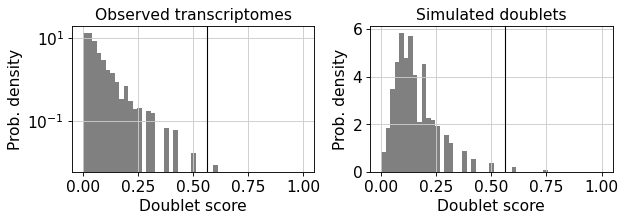

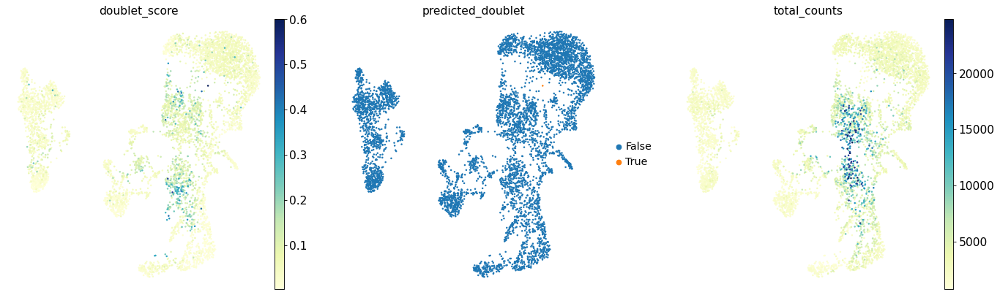

In [43]:
sc.pl.umap(adata_gex, color=['doublet_score', 'predicted_doublet', 'total_counts'])

# Marker genes

In [44]:
marker_genes = {
    'CD14+ Mono': ['FCN1', 'CD14'],
    'CD16+ Mono': ['TCF7L2', 'FCGR3A', 'LYN'],
    'ID2-hi myeloid prog': ['CD14', 'ID2', 'VCAN', 'S100A9', 'CLEC12A', 'KLF4', 'PLAUR'],
    'cDC1': ['CLEC9A', 'CADM1'],
    'cDC2': ['CLEC10A', 'FCER1A', 'CST3', 'COTL1', 'LYZ', 'DMXL2'], # Note: DMXL2 should be negative
    'Normoblast': ['SLC4A1', 'SLC25A37', 'HBB', 'HBA2', 'HBA1', 'TFRC'],
    'Erythroblast': ['MKI67', 'HBA1', 'HBB'],
    'Proerythroblast': ['CDK6', 'SYNGR1', 'HBM', 'GYPA'], # Note HBM and GYPA are negative markers
    'NK': ['GNLY', 'NKG7', 'CD247', 'GRIK4', 'FCER1G', 'TYROBP', 'KLRG1', 'FCGR3A'],
    'ILC': ['ID2', 'PLCG2', 'GNLY', 'SYNE1'],
    'Lymph prog': ['IGLL1', 'VPREB1', 'MME', 'EBF1', 'SSBP2', 'BACH2', 'CD79B', 'IGHM', 'PAX5', 'PRKCE', 'DNTT'],
    'Naive CD20+ B': ['MS4A1', 'IL4R', 'IGHD', 'FCRL1', 'IGHM'],
    'B1 B': ['MS4A1', 'SSPN', 'ITGB1', 'EPHA4', 'COL4A4', 'PRDM1', 'ZNF215', 'IRF4', 'CD38', 'XBP1', 'PAX5', 'BCL11A', 'BLK', 'IGHD', 'IGHM'], # Note IGHD and IGHM are negative markers
    'Transitional B': ['MME', 'CD38', 'CD24', 'ACSM3', 'MSI2'],
    'Plasma cells': ['MZB1', 'HSP90B1', 'FNDC3B', 'PRDM1', 'IGKC', 'JCHAIN'],
    'Plasmablast': ['XBP1', 'RF4', 'PRDM1', 'PAX5'],  # Note PAX5 is a negative marker
    'CD4+ T activated': ['CD4', 'IL7R', 'TRBC2', 'ITGB1'],
    'CD4+ T naive': ['CD4', 'IL7R', 'TRBC2', 'CCR7'],
    'CD8+ T': ['CD8A', 'CD8B', 'GZMB', 'GZMA', 'CCL5', 'GZMK', 'GZMH', 'GZMA'],
    'T activation': ['CD69', 'CD38'], # CD69 much better marker!
    'T naive': ['LEF1', 'CCR7', 'TCF7'],
    'pDCs': ['GZMB', 'IL3RA', 'COBLL1', 'TCF4'],
    'G/M prog': ['MPO', 'BCL2', 'KCNQ5', 'CSF3R', 'PRTN3'],
    'HSC': ['NRIP1', 'MECOM', 'PROM1', 'CD34', 'NKAIN2'],
    'MK/E prog': ['ZNF385D', 'ITGA2B', 'RYR3', 'PLCB1'] # Note PLCB1 is a negative marker
}


In [45]:
sc.tl.rank_genes_groups(adata_gex, groupby='leiden_res0.5', key_added='rank_genes_res0.5')

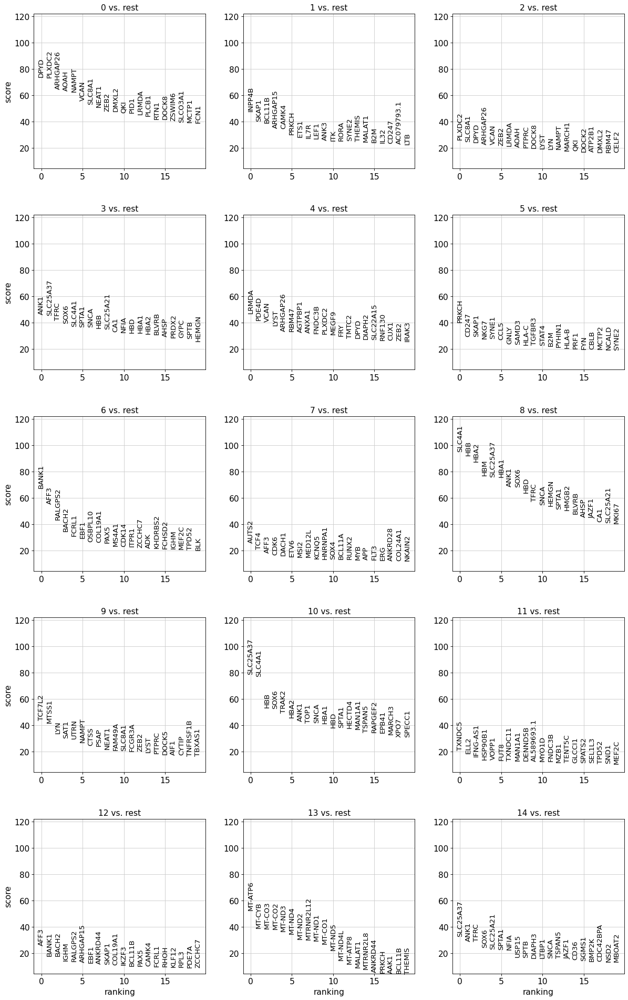

In [46]:
sc.pl.rank_genes_groups(adata_gex, key='rank_genes_res0.5', ncols=3, fontsize=12)

## Literature markers

In [47]:
from matplotlib import colors

In [48]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

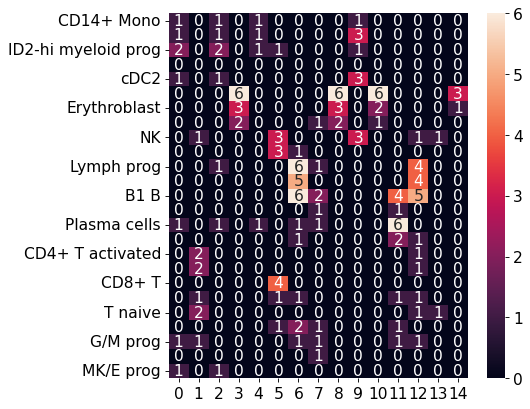

In [49]:
sns.heatmap(sc.tl.marker_gene_overlap(adata_gex, reference_markers=marker_genes, key='rank_genes_res0.5'), annot=True)
plt.show()

First overview of clusters suggests:
- 0: ID2-hi myeloid prog
- 1: CD4+ T
- 2: ID2-hi myeloid prog
- 3: Erythrocyte development
- 4: -
- 5: NK, ILC, CD8+ T
- 6: B cells / lymph prog.
- 7: B1 B
- 8: Erythrocyte development
- 9: CD16+ Mono, cDC2, NK
- 10: Erythrocyte development
- 11: B1 B, Plasma cells
- 12: B cells / lymph prog.
- 13: -
- 14: Erythrocyte development

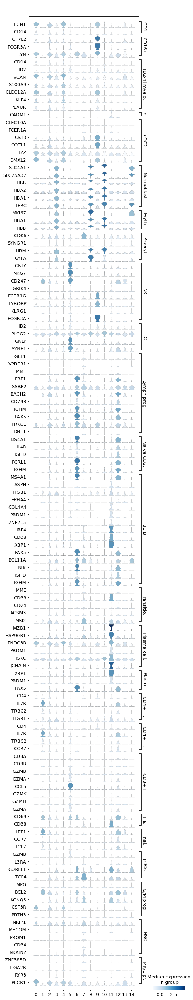

In [50]:
# Look at the marker genes in a concise manner
filt_marker_genes = dict()
for key,val in marker_genes.items():
    filt_vals = [i for i in val if i in adata_gex.var_names]
    filt_marker_genes[key] = filt_vals

adata_plot = adata_gex.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_genes, groupby='leiden_res0.5', use_raw=False, swap_axes=True)

Cluster: CD14+ Mono


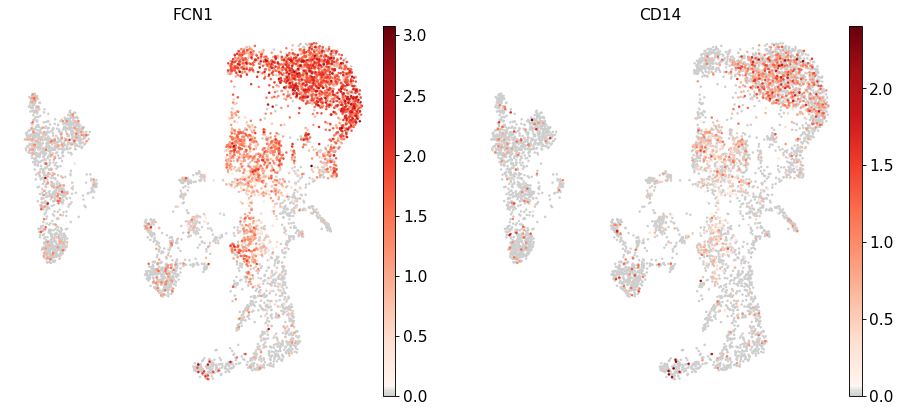

Cluster: CD16+ Mono


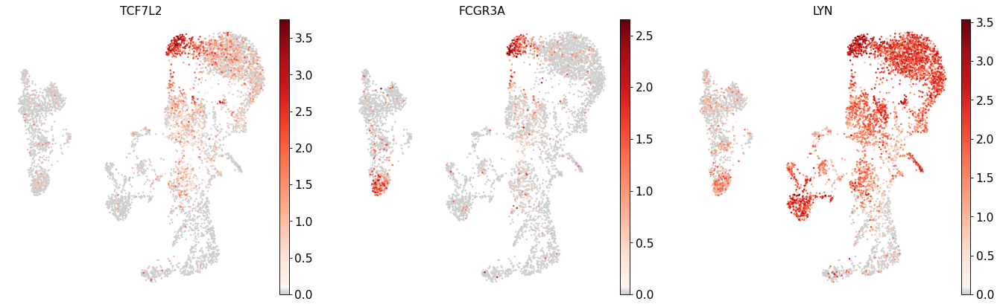

Cluster: ID2-hi myeloid prog


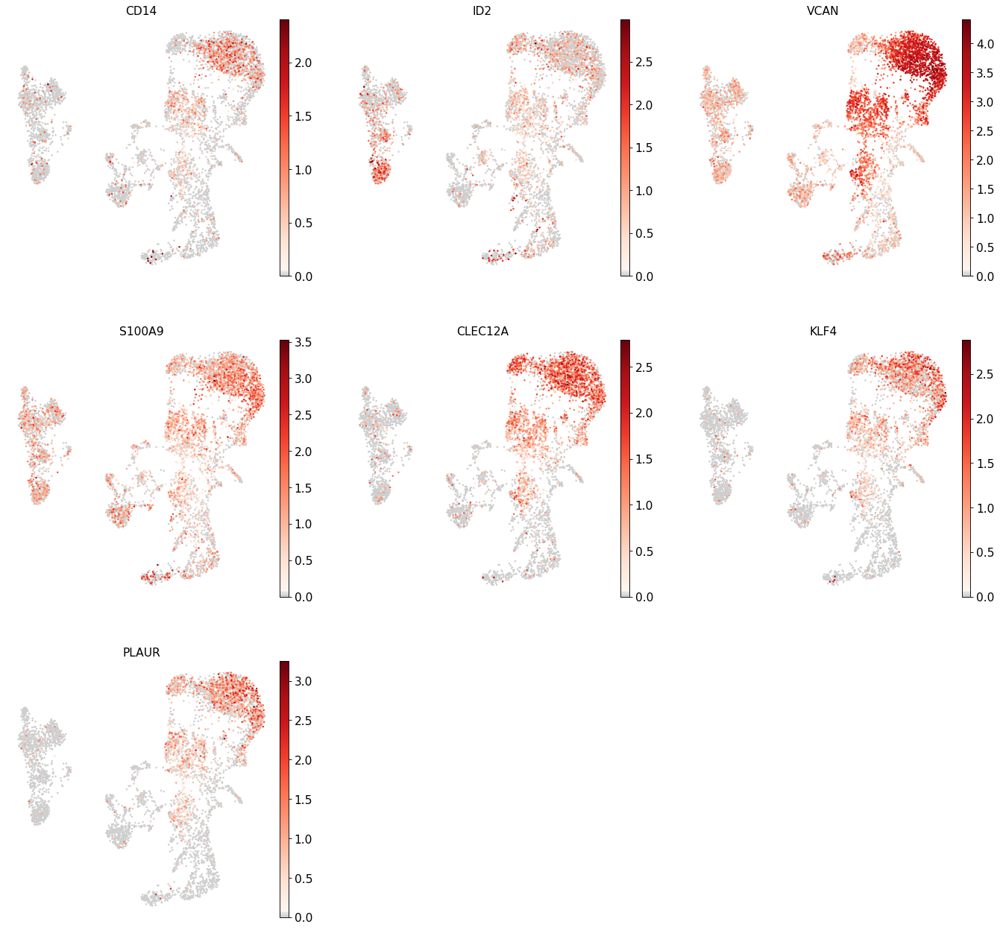

Cluster: cDC1


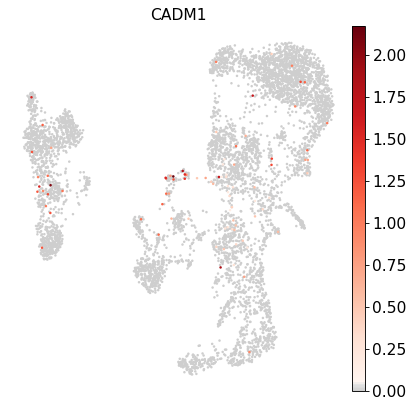

Cluster: cDC2


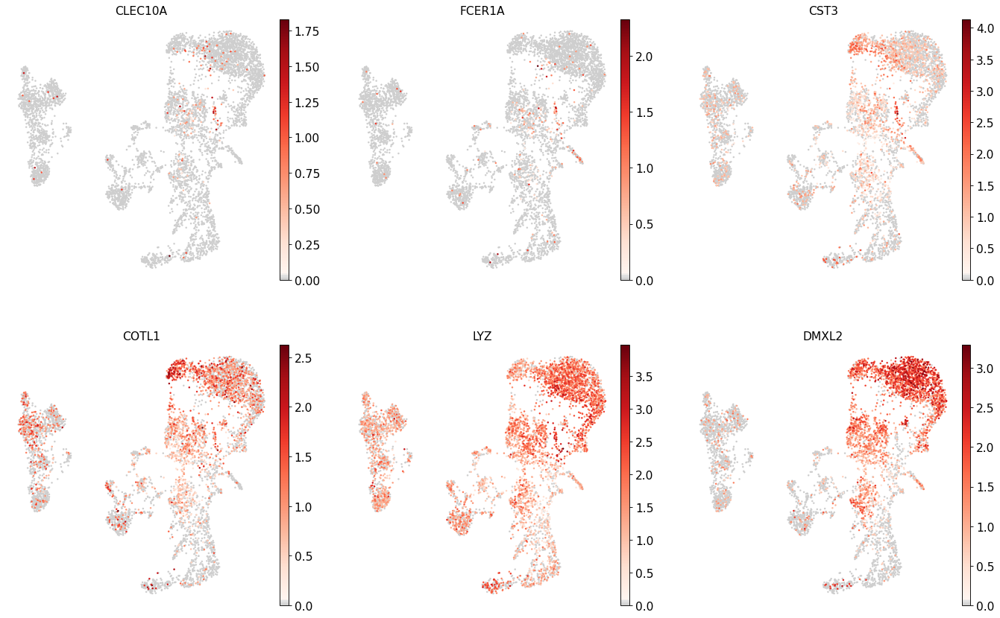

Cluster: Normoblast


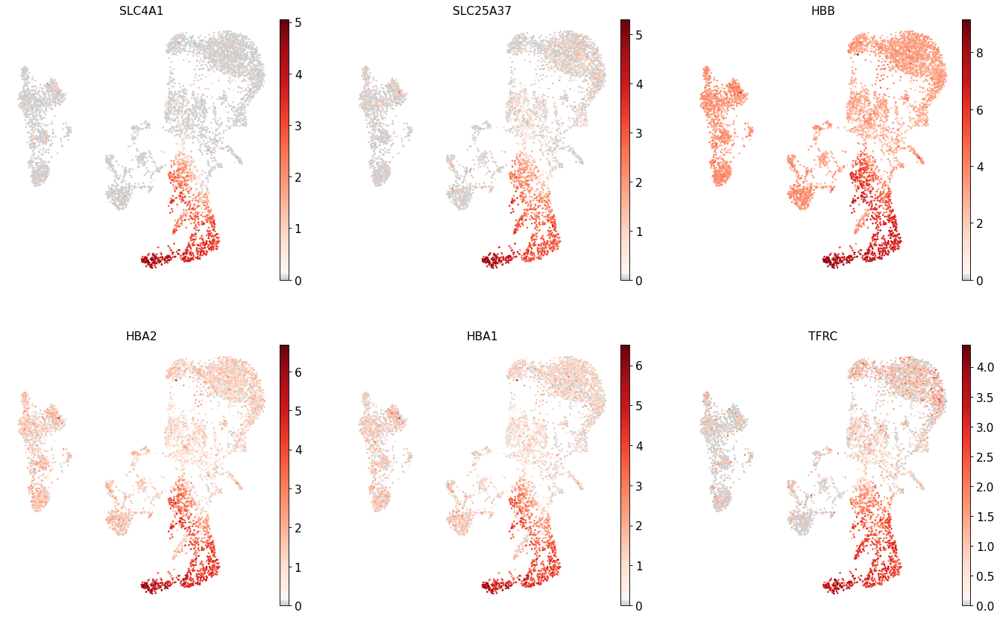

Cluster: Erythroblast


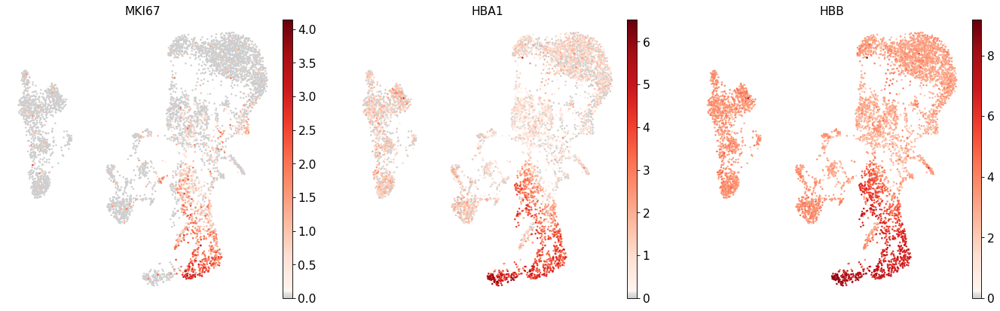

Cluster: Proerythroblast


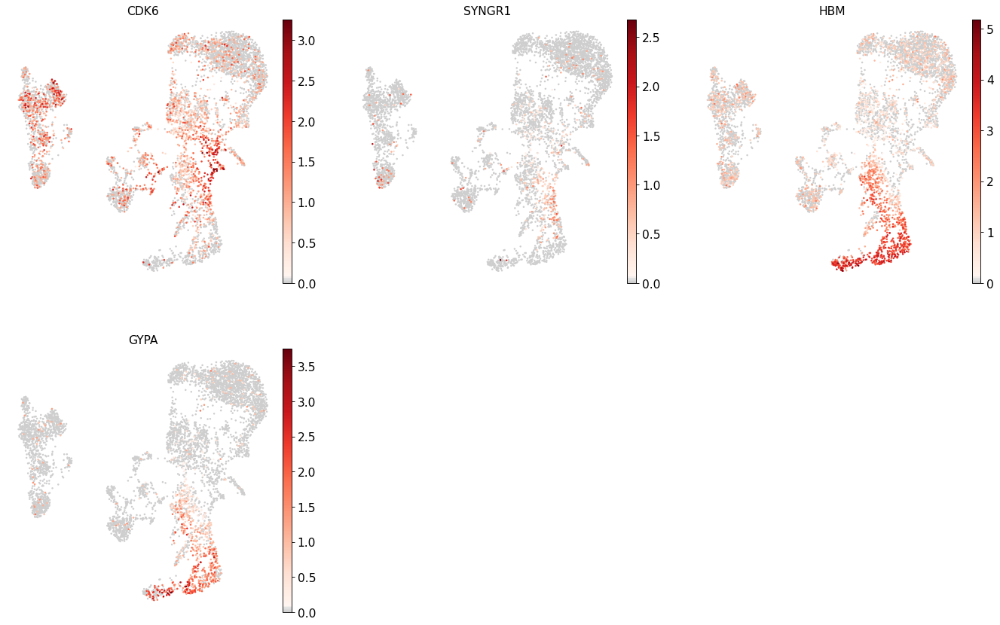

Cluster: NK


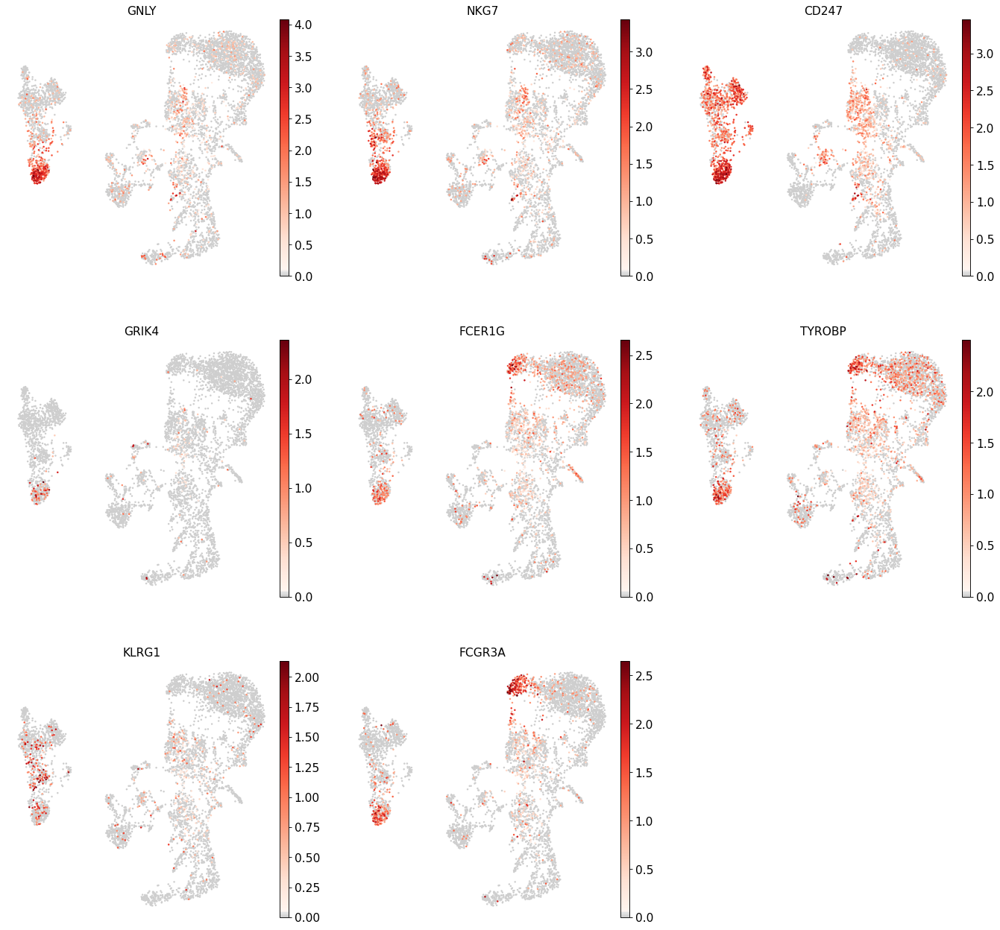

Cluster: ILC


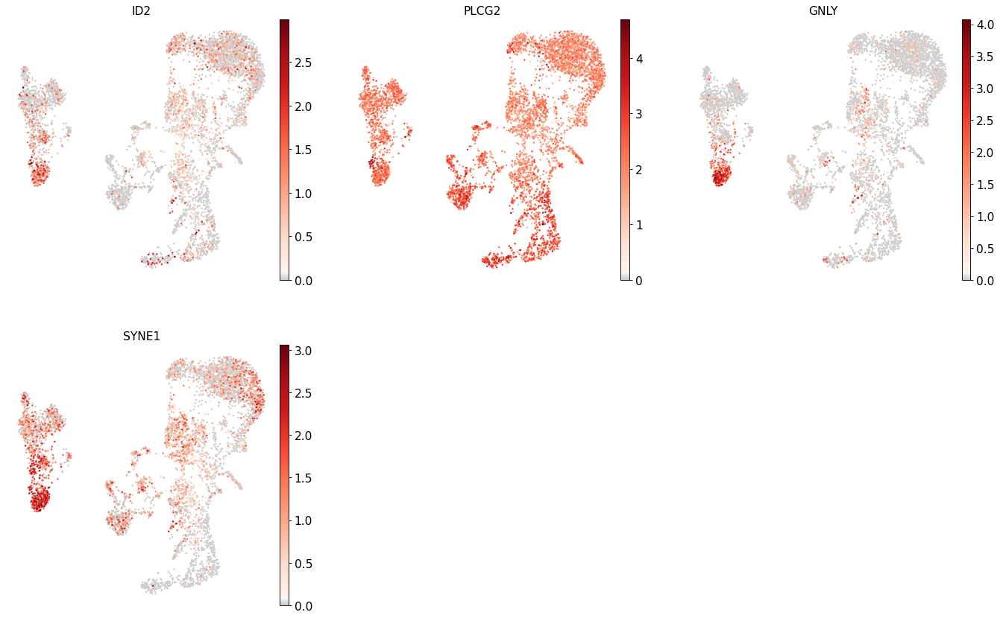

Cluster: Lymph prog


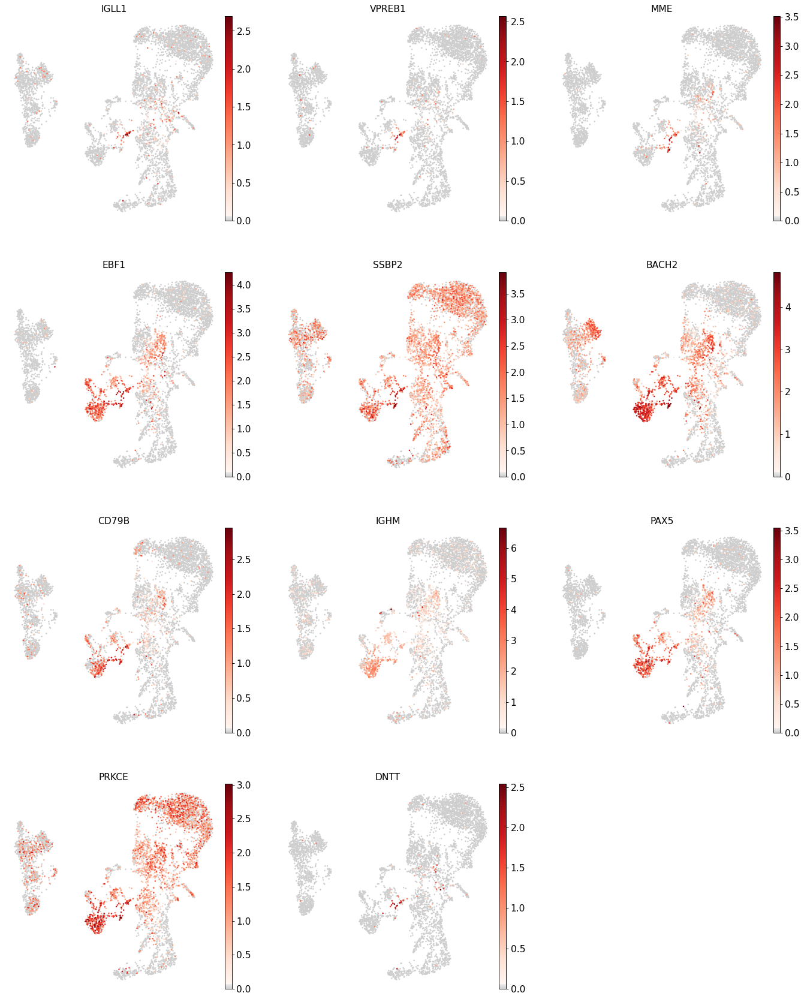

Cluster: Naive CD20+ B


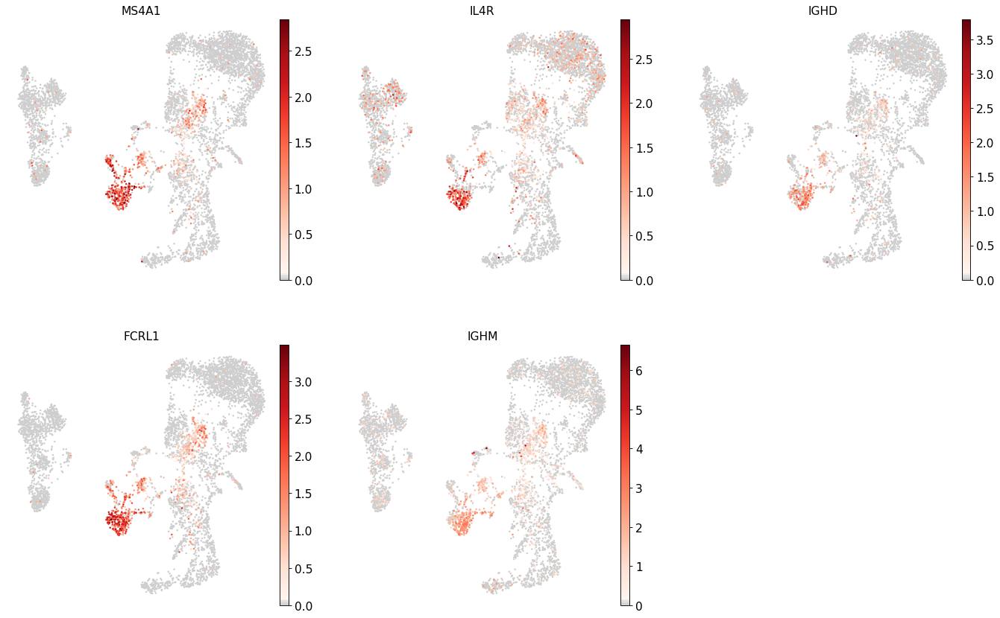

Cluster: B1 B


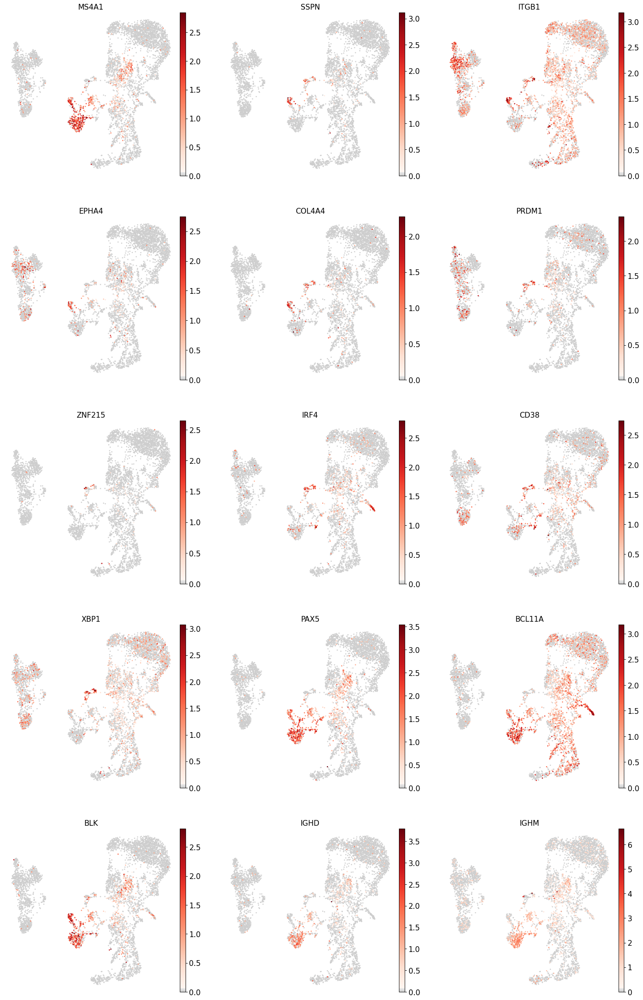

Cluster: Transitional B


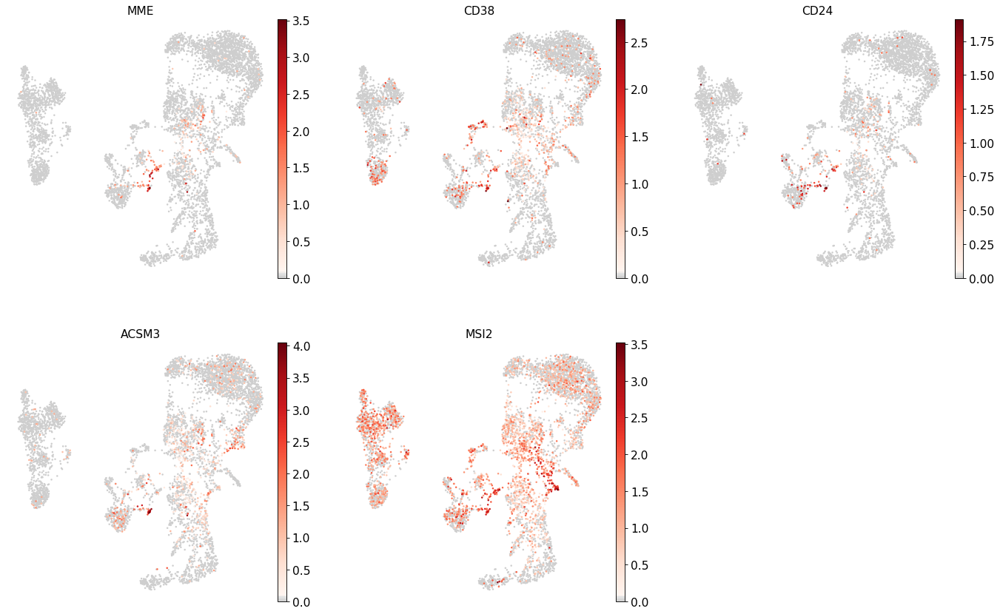

Cluster: Plasma cells


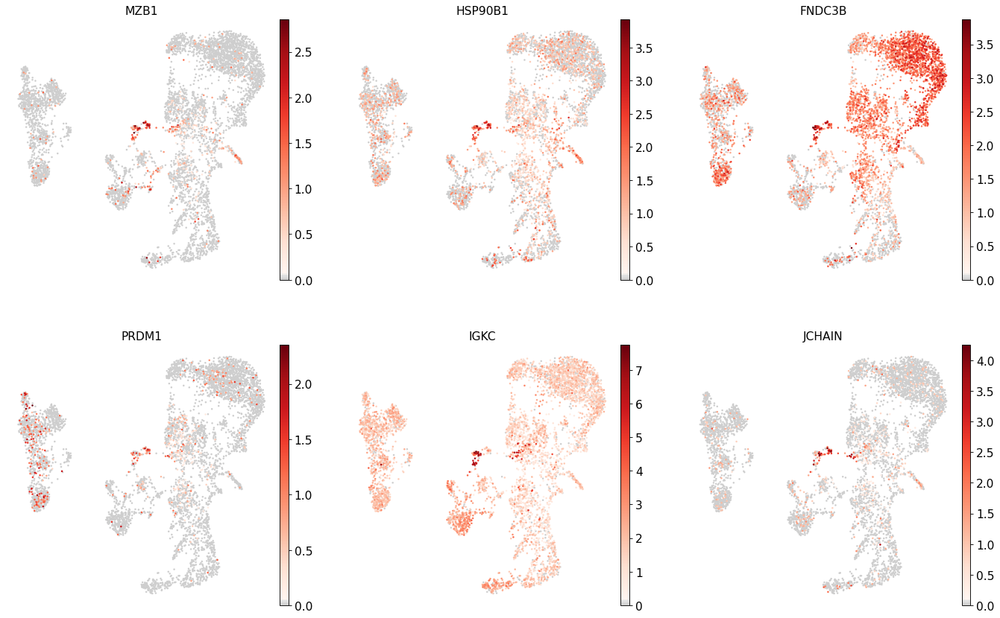

Cluster: Plasmablast


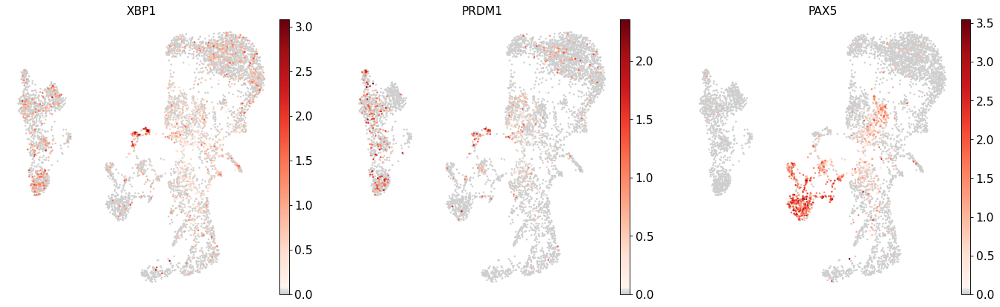

Cluster: CD4+ T activated


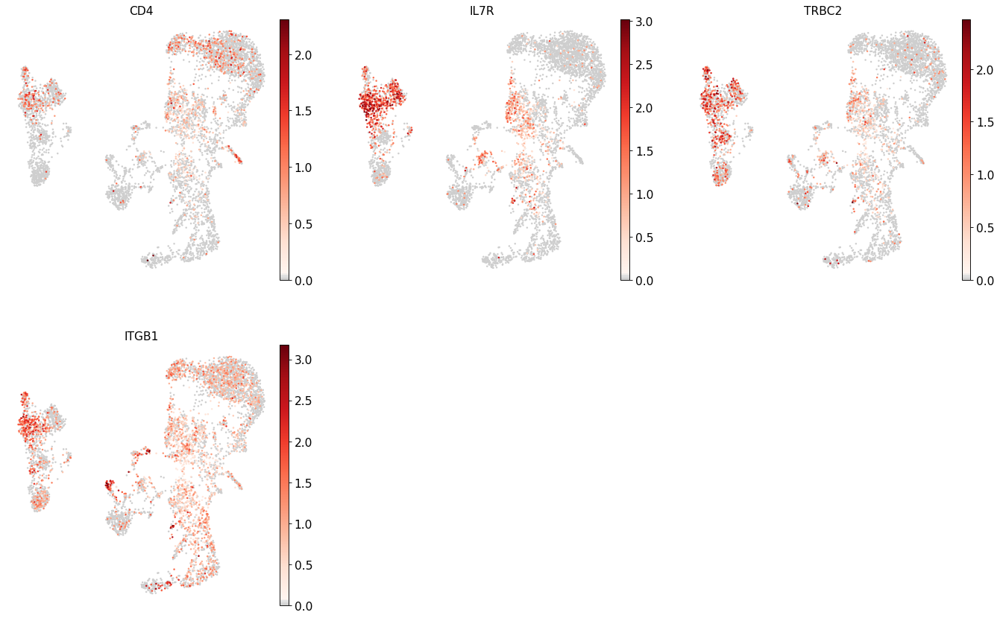

Cluster: CD4+ T naive


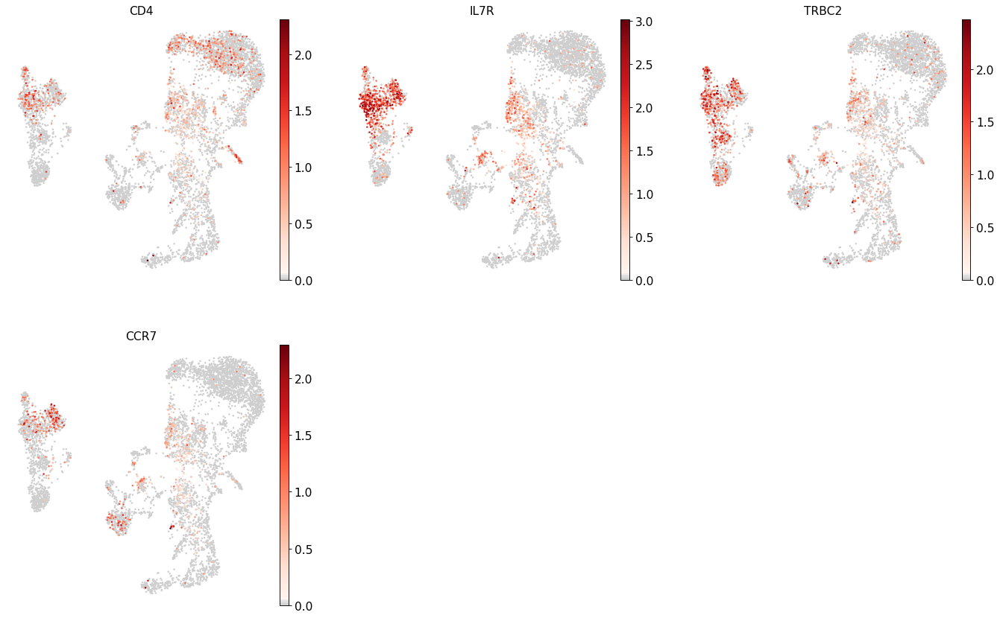

Cluster: CD8+ T


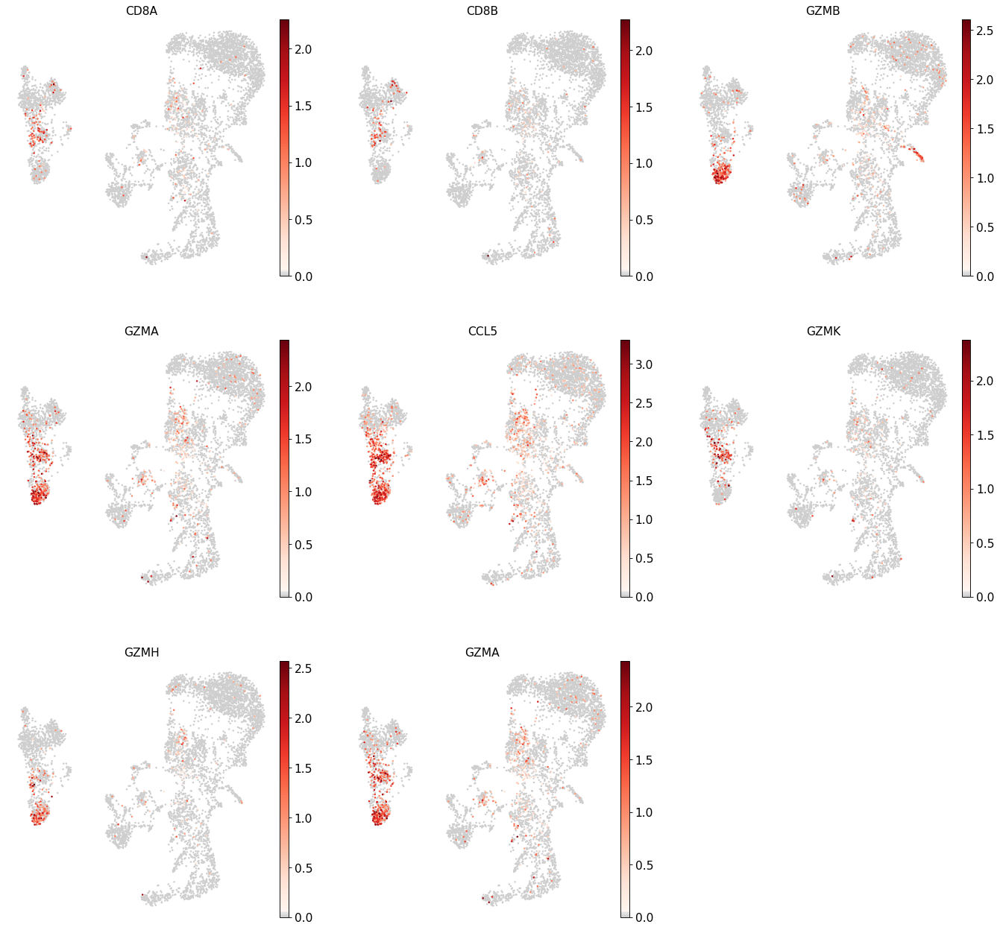

Cluster: T activation


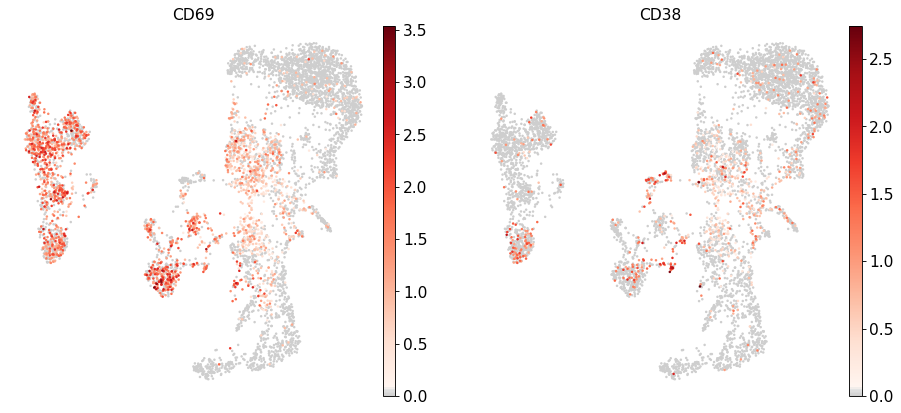

Cluster: T naive


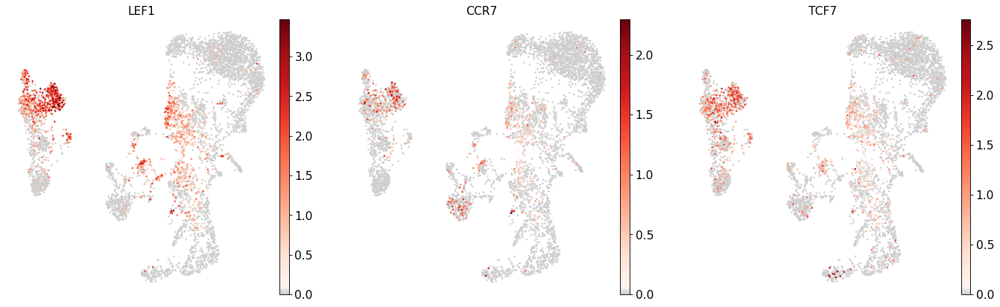

Cluster: pDCs


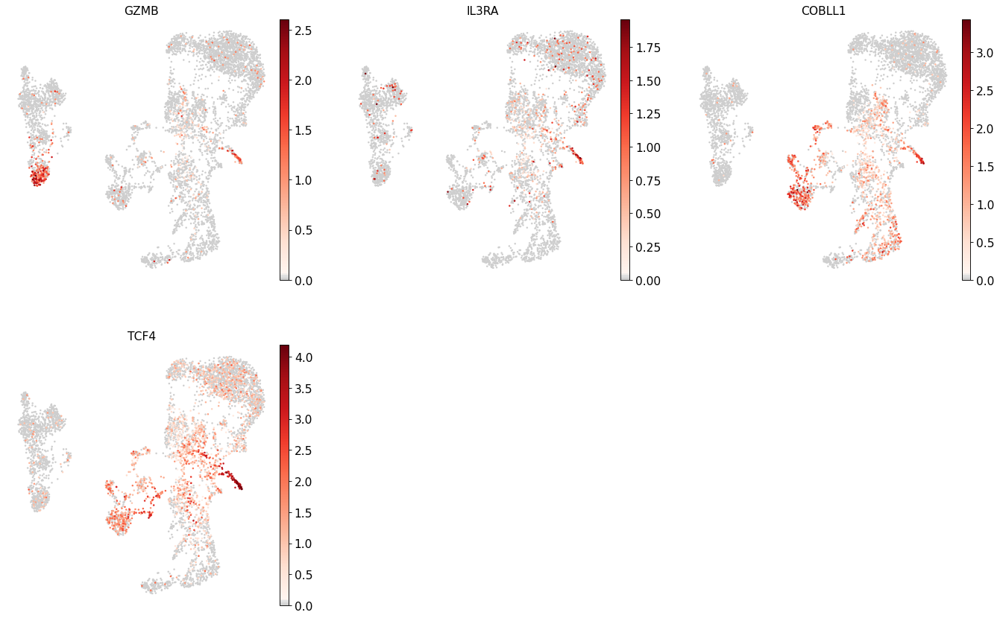

Cluster: G/M prog


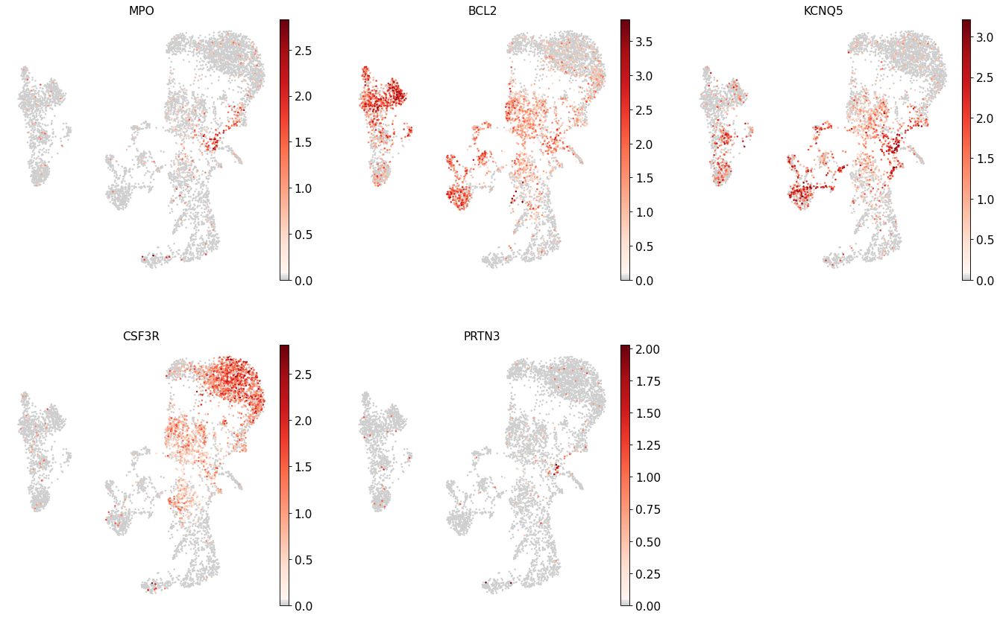

Cluster: HSC


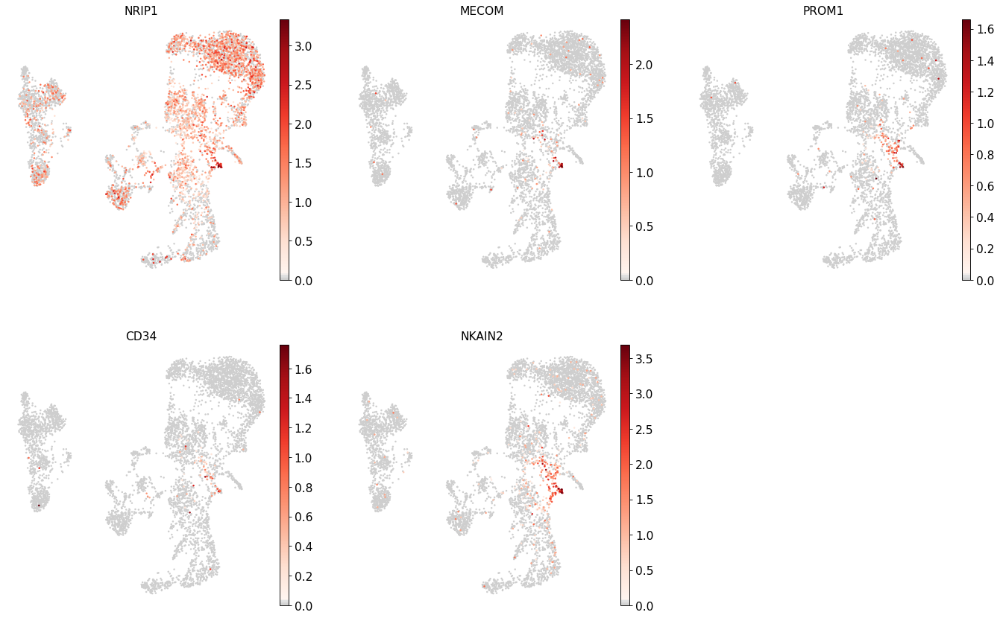

Cluster: MK/E prog


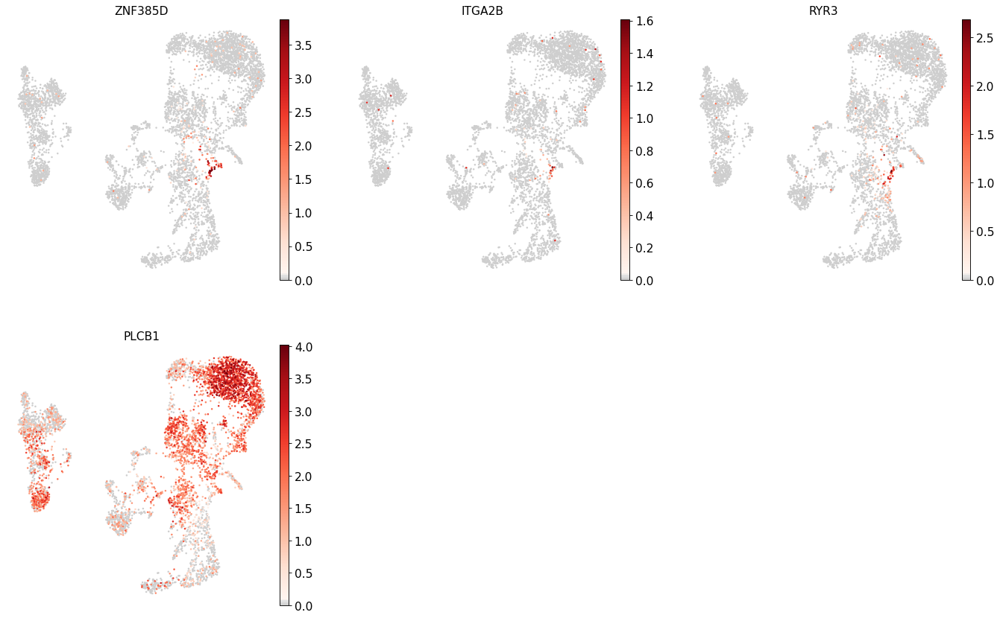

In [51]:
# Look at marker expression 
# Note that some markers are meant to be negative! (DMXL2, HBM, GYPA, IGHD, IGHM for some cell types)
for i in marker_genes.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_genes[i] if i in adata_gex.var_names]
    sc.pl.umap(adata_gex, color=genes_to_plot, ncols=3, use_raw=False, cmap=mymap)

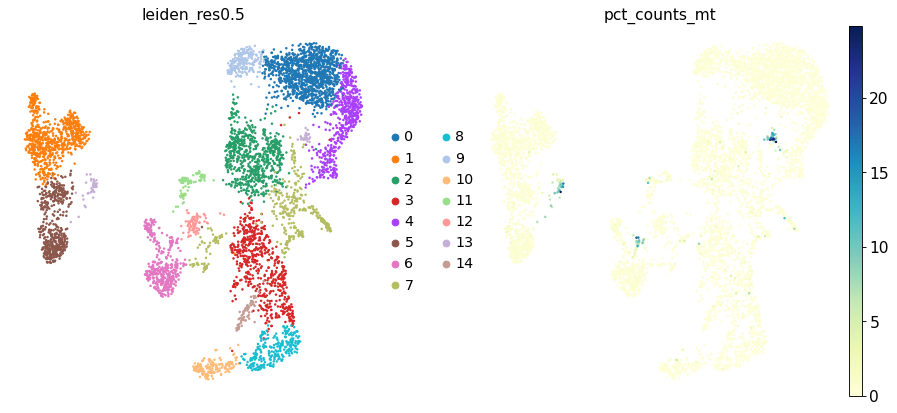

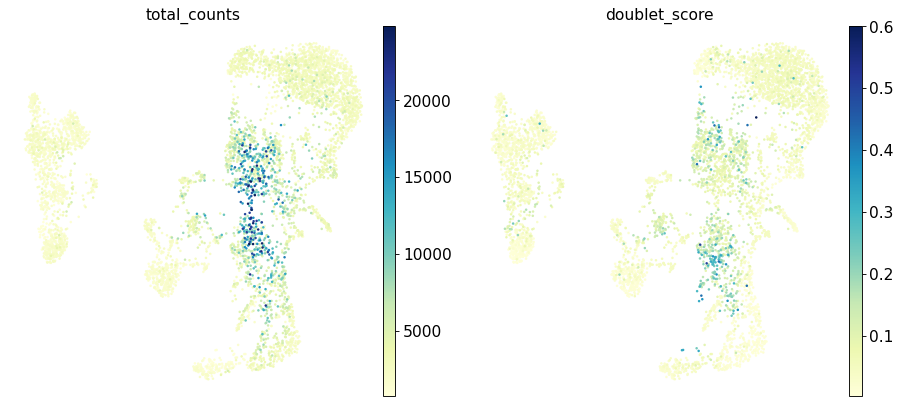

In [52]:
# Check some technical markers to assess potential doublet or low quality clusters
sc.pl.umap(adata_gex, color=['leiden_res0.5', 'pct_counts_mt'])
sc.pl.umap(adata_gex, color=['total_counts', 'doublet_score'])

The doublet score seems to be more apparent in clusters 3 and 2, thus there are potentially doublet sub-clusters.

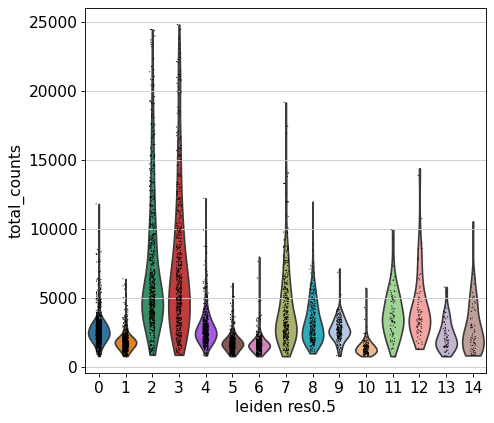

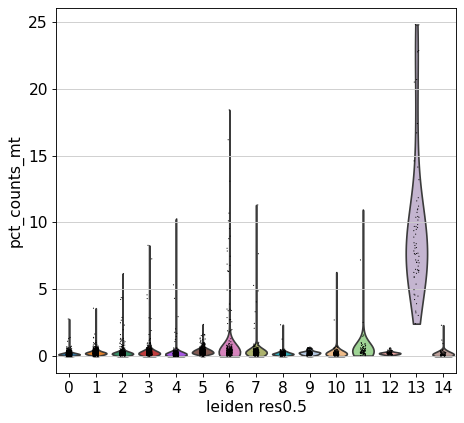

In [53]:
sc.pl.violin(adata_gex, keys='total_counts', groupby='leiden_res0.5')
sc.pl.violin(adata_gex, keys='pct_counts_mt', groupby='leiden_res0.5')

Clusters 2 and 3 are potentially doublets

Marker genes suggest:
- 0: ID2-hi myeloid prog
- 1: CD4+ T
- 2: ID2-hi myeloid prog
- 3: Erythrocyte development
- 4: G/M prog
- 5: NK, ILC, CD8+ T
- 6: B cells / lymph prog.
- 7: B1 B
- 8: Erythrocyte development
- 9: CD16+ Mono, cDC2, NK
- 10: Erythrocyte development
- 11: B1 B, Plasma cells
- 12: B cells / lymph prog.
- 13: -
- 14: Erythrocyte development

Sub-clustering

Based on the UMAP above, we will sub-cluster the clusters that seem to have sub-structures, or multiple cell identities 
Clusters 1,3,4,5,6,7,12
- 0: Monocytes?
- 1: CD4+ T
- 3: ID2-myeloid prog, Erythroblast development
- 4: G/M prog
- 5: NK/ILC, CD8+ T
- 6: B cells
- 7: G/M prog, HSC, MK/E prog
- 12: B cells / lymph prog.

Note. Clusters 2 and 3 likely include doublet sub-clusters, which we need to check further later using gene expression features for the genes that are often differentially expressed in doublets.


# Subclustering

## T cells - cluster 1

### Cluster 1

In [54]:
orig_key = 'leiden_res0.5'
new_key = 'leiden_res0.5_tsub'
new_rg_key = 'rg_res0.5_tsub'
sub_key = '1'

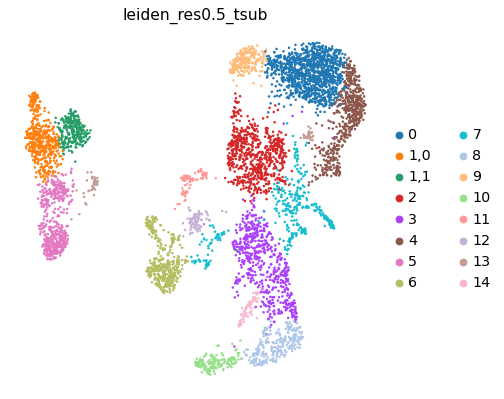

0      1132
2       706
3       586
4       541
5       482
1,0     475
6       421
7       369
1,1     269
8       257
9       224
10      153
11       81
12       79
13       66
14       65
Name: leiden_res0.5_tsub, dtype: int64

In [55]:
sc.tl.leiden(adata_gex, restrict_to=('leiden_res0.5', [sub_key]), key_added=new_key, resolution=0.15)
sc.pl.umap(adata_gex, color=new_key)

#sc.tl.leiden(adata_gex, restrict_to=('leiden_res0.5', [sub_key]), key_added=new_key, resolution=0.1)
#sc.pl.umap(adata_gex, color=new_key)

adata_gex.obs[new_key].value_counts()

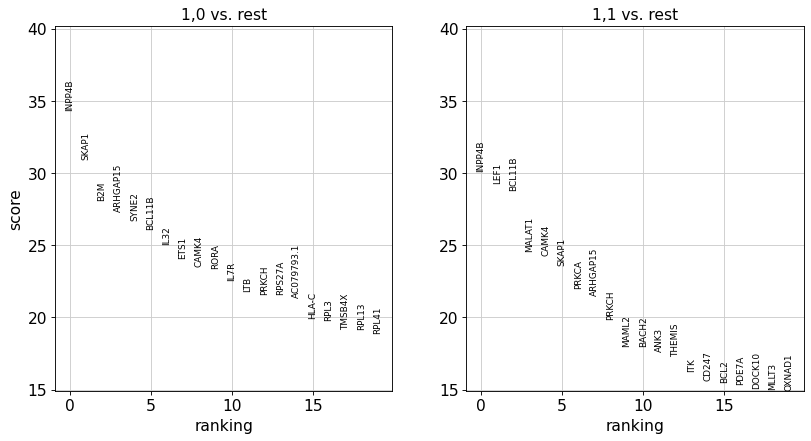

In [56]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

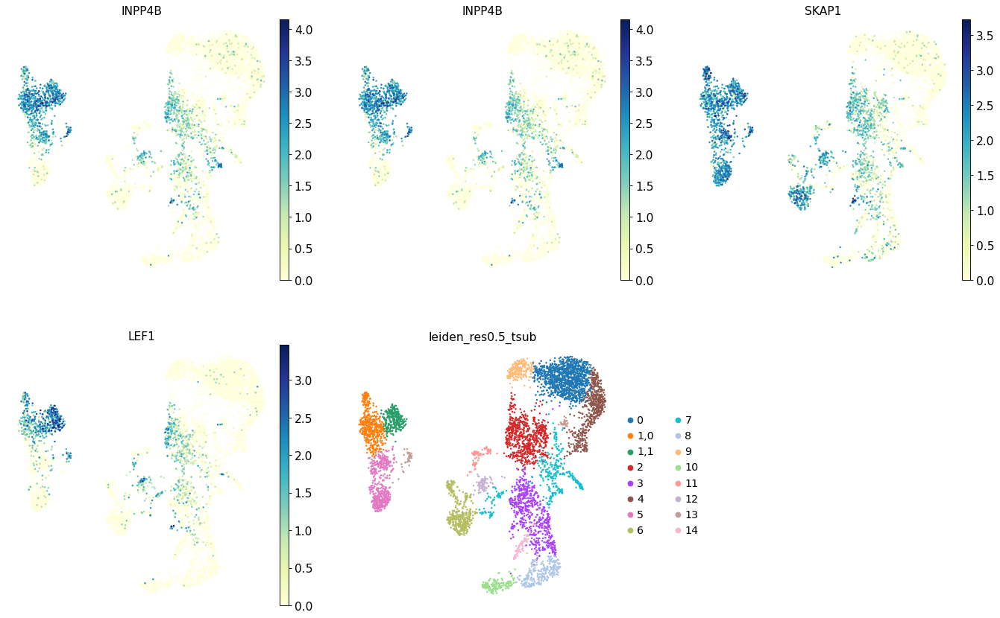

In [57]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

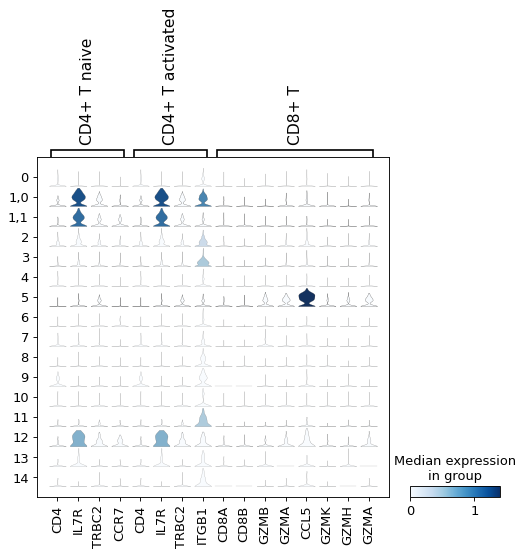

In [58]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD4+ T naive','CD4+ T activated','CD8+ T']}, groupby=new_key)

Looks like 1,0 is closer to CD4+ activated and 1,1 is more CD4+ naive (from the ITGB1)

### Summary

- CD4+ T cell subtypes:
  - 1,0: CD4+ T activated
  - 1,1: CD4+ T naive

## Monocytes & DCs - clusters 0,2,4, and 9

### Cluster 0

This is here to show when to decide against subclustering!

In [59]:
orig_key = 'leiden_res0.5_tsub'
new_key = 'leiden_res0.5_msub'
new_rg_key = 'rg_res0.5_msub'
sub_key = '0'

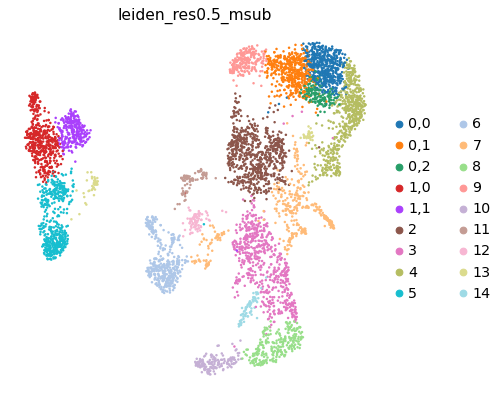

2      706
3      586
4      541
0,0    513
5      482
1,0    475
0,1    463
6      421
7      369
1,1    269
8      257
9      224
0,2    156
10     153
11      81
12      79
13      66
14      65
Name: leiden_res0.5_msub, dtype: int64

In [60]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.5)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

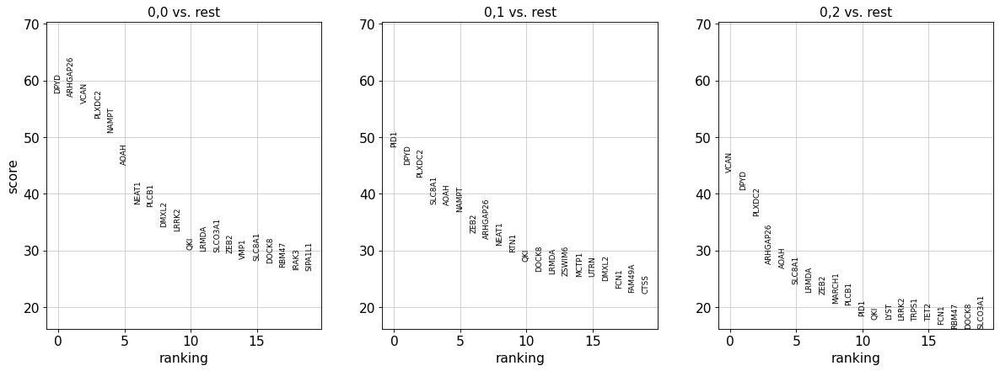

In [61]:
num_subclusts = 3
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

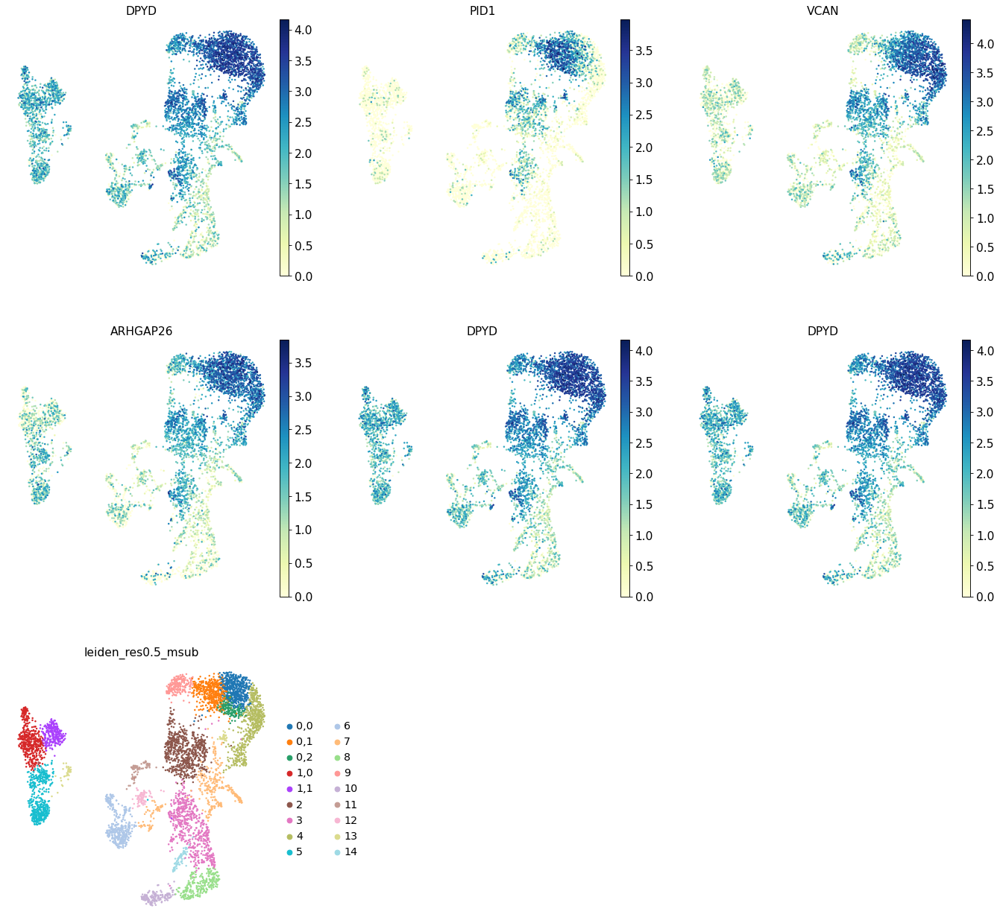

In [62]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [63]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

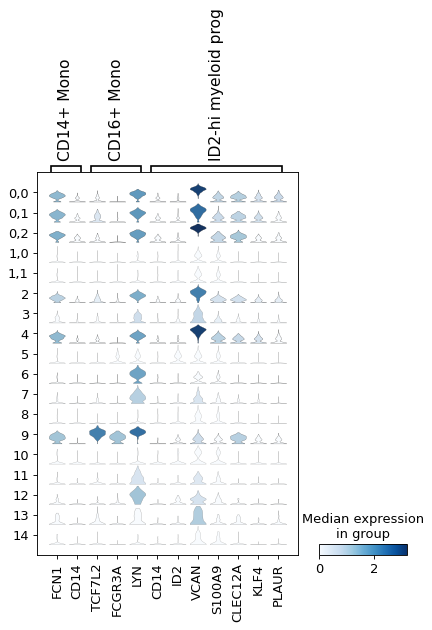

In [64]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD14+ Mono','CD16+ Mono', 'ID2-hi myeloid prog']}, groupby=new_key)

No notable marker gene differences in cluster 0. There are only some gradients, which we can leave here.
- 0: CD14+ Mono

### Cluster 2

In [65]:
# ignore the previous sub-clustering with the key 'leiden_res0.5_msub', and instead use 'leiden_res0.5_tsub'.
orig_key = 'leiden_res0.5_tsub'
new_key = 'leiden_res0.5_msub2'
new_rg_key = 'rg_res0.5_msub2'
sub_key = '2'

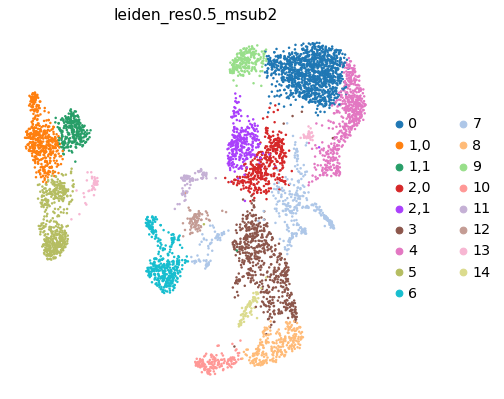

0      1132
3       586
4       541
5       482
1,0     475
6       421
2,0     396
7       369
2,1     310
1,1     269
8       257
9       224
10      153
11       81
12       79
13       66
14       65
Name: leiden_res0.5_msub2, dtype: int64

In [66]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.2)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

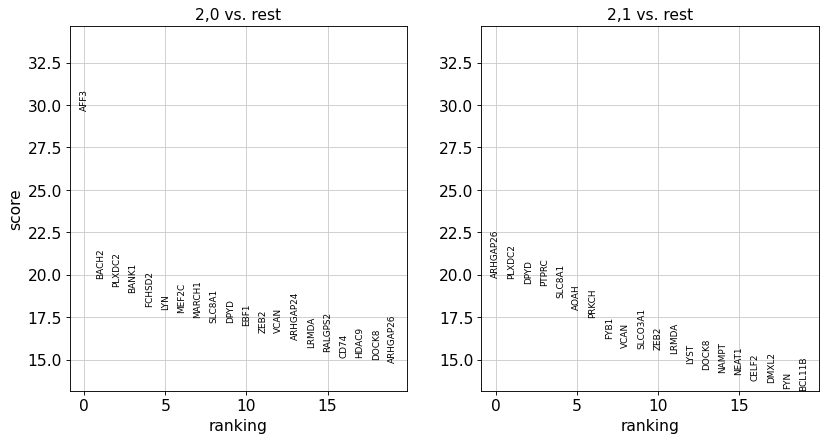

In [67]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

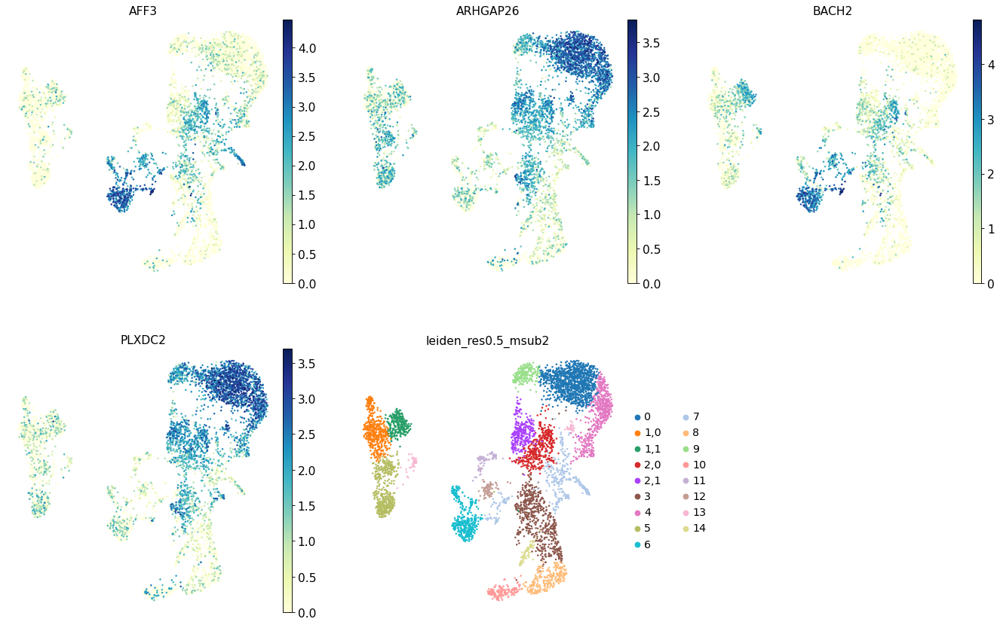

In [68]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [69]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

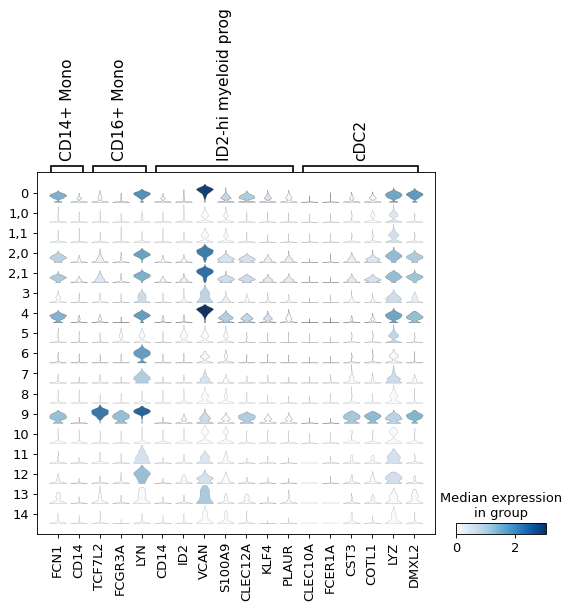

In [70]:
# cluster 11: CD16 + Monocytes, or CD14+Monocytes, cDC2, or ILC
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD14+ Mono','CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2']}, groupby=new_key)

This indicates that there is no clear difference between cluster 2's subclusters.
- 2: CD14+ Mono


### Cluster 4

In [71]:
orig_key = 'leiden_res0.5_tsub'
new_key = 'leiden_res0.5_msub3'
new_rg_key = 'rg_res0.5_msub3'
sub_key = '4'

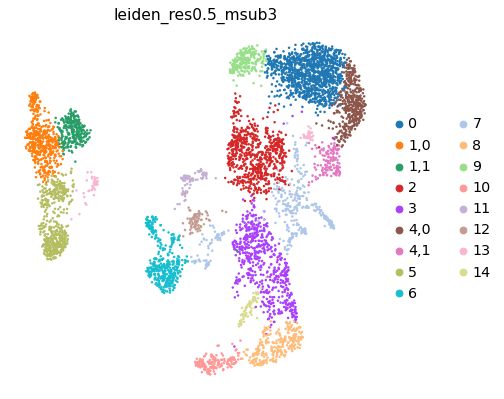

0      1132
2       706
3       586
5       482
1,0     475
6       421
4,0     408
7       369
1,1     269
8       257
9       224
10      153
4,1     133
11       81
12       79
13       66
14       65
Name: leiden_res0.5_msub3, dtype: int64

In [72]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.15)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

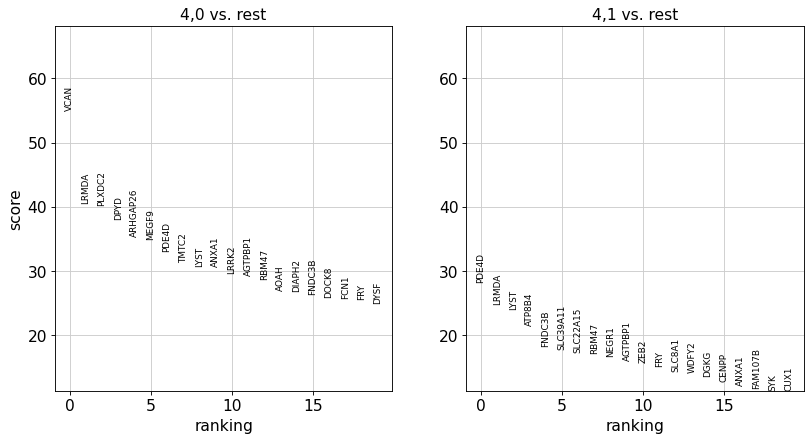

In [73]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

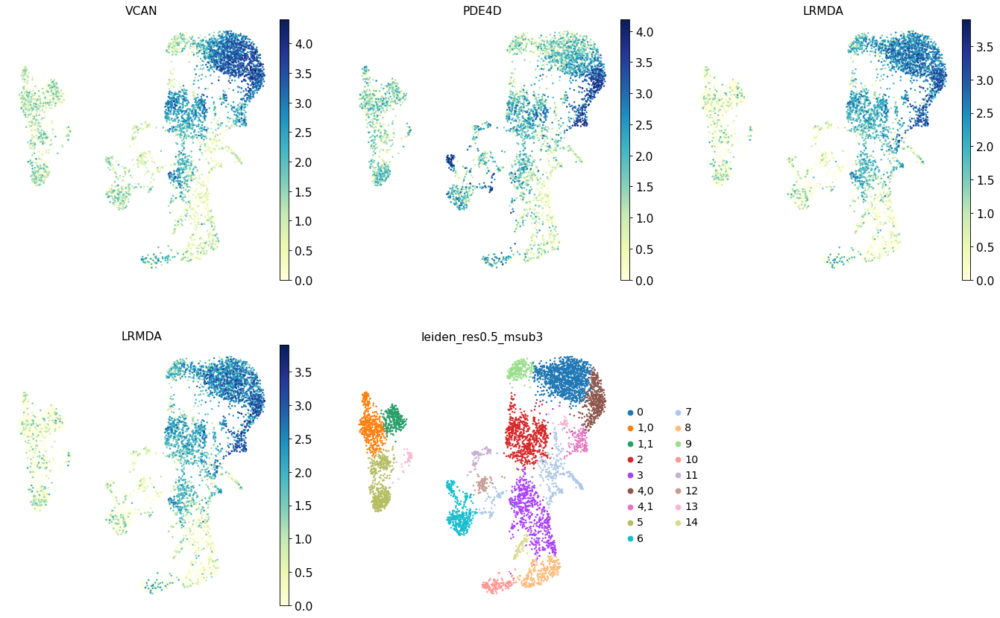

In [74]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [75]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

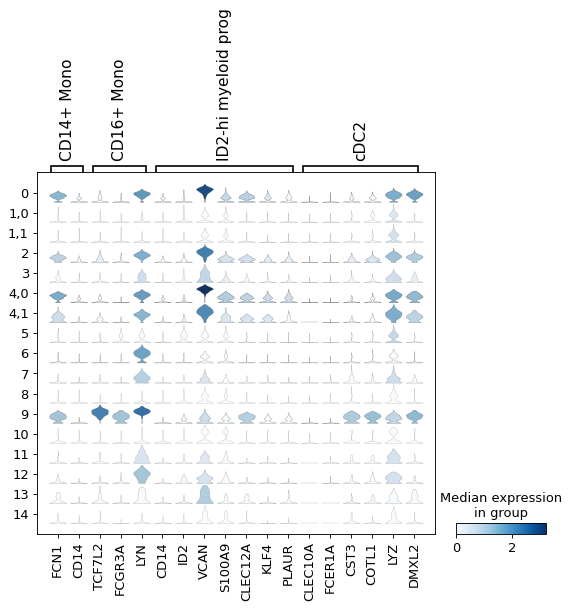

In [76]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD14+ Mono','CD16+ Mono','ID2-hi myeloid prog','cDC2']}, groupby=new_key)

This again indicates not that big difference between 4,0 and 4,1. Thus, we will not sub-cluster this cluster 4.
- 4: CD14+ Mono


### Cluster 9

In [77]:
orig_key = 'leiden_res0.5_tsub'
new_key = 'leiden_res0.5_msub4'
new_rg_key = 'rg_res0.5_msub4'
sub_key = '9'

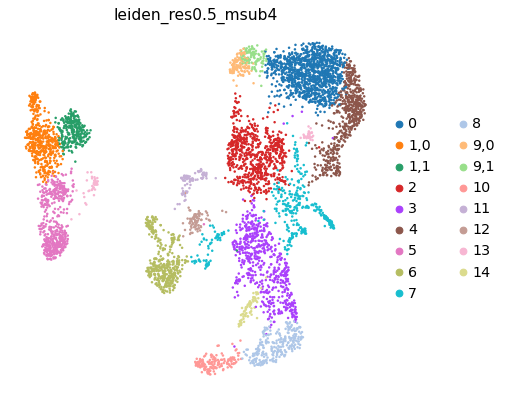

0      1132
2       706
3       586
4       541
5       482
1,0     475
6       421
7       369
1,1     269
8       257
10      153
9,0     120
9,1     104
11       81
12       79
13       66
14       65
Name: leiden_res0.5_msub4, dtype: int64

In [78]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.4)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

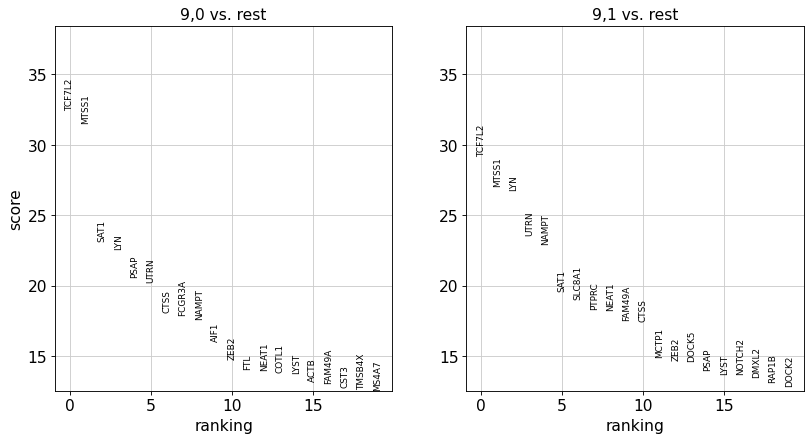

In [79]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

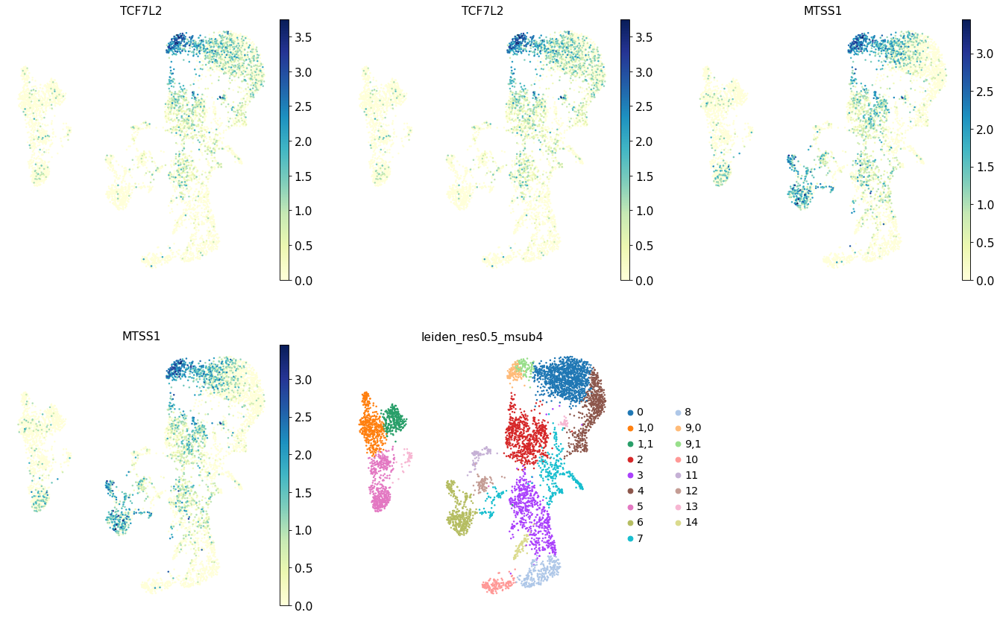

In [80]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [81]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

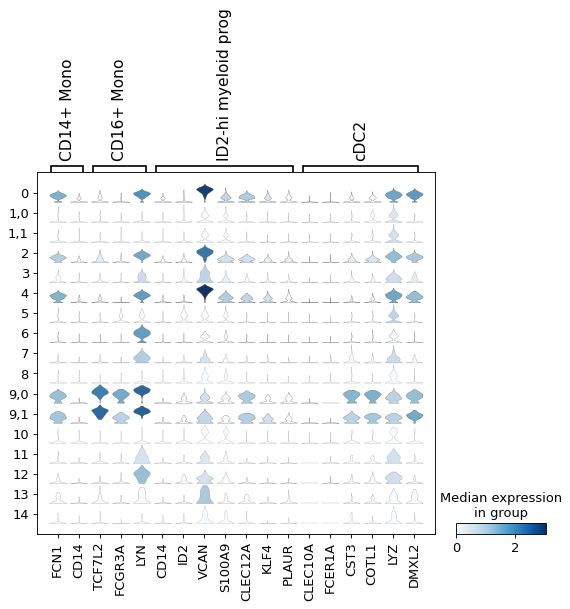

In [82]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD14+ Mono','CD16+ Mono','ID2-hi myeloid prog','cDC2']}, groupby=new_key)

We will not sub-cluster the cluster 9, and it's just CD16+ Mono
- 9: CD16+ Mono

### Summary

- 0: CD14+ Mono

- 2: CD14+ Mono (doublets?)
    
- 4: CD14+ Mono

- 9: CD16+ Mono

Some of the clusters should be doublets...


## B cells - cluster 6 and 7

### Cluster 6

In [83]:
orig_key = 'leiden_res0.5_tsub'
new_key = 'leiden_res0.5_bsub'
new_rg_key = 'rg_res0.5_bsub'
sub_key = '6'

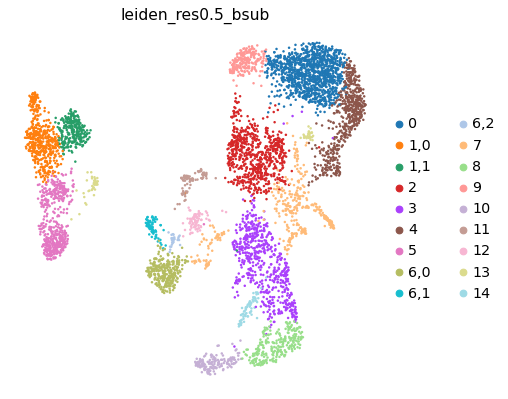

0      1132
2       706
3       586
4       541
5       482
1,0     475
7       369
6,0     316
1,1     269
8       257
9       224
10      153
11       81
12       79
6,1      76
13       66
14       65
6,2      29
Name: leiden_res0.5_bsub, dtype: int64

In [84]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.2)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

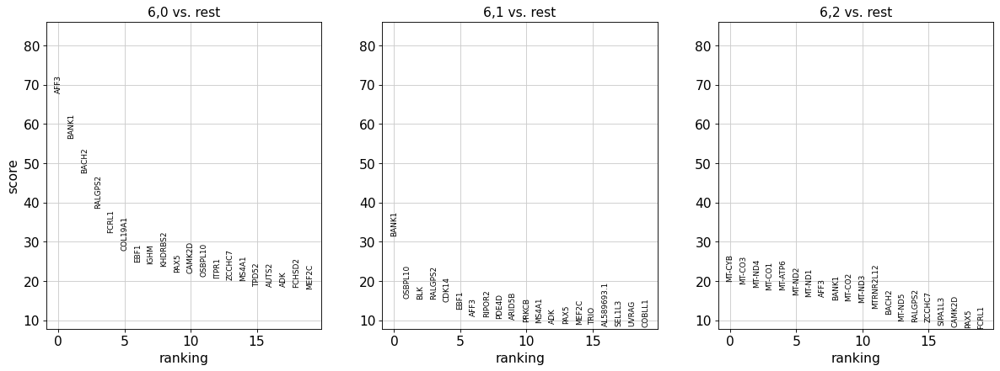

In [85]:
num_subclusts = 3
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

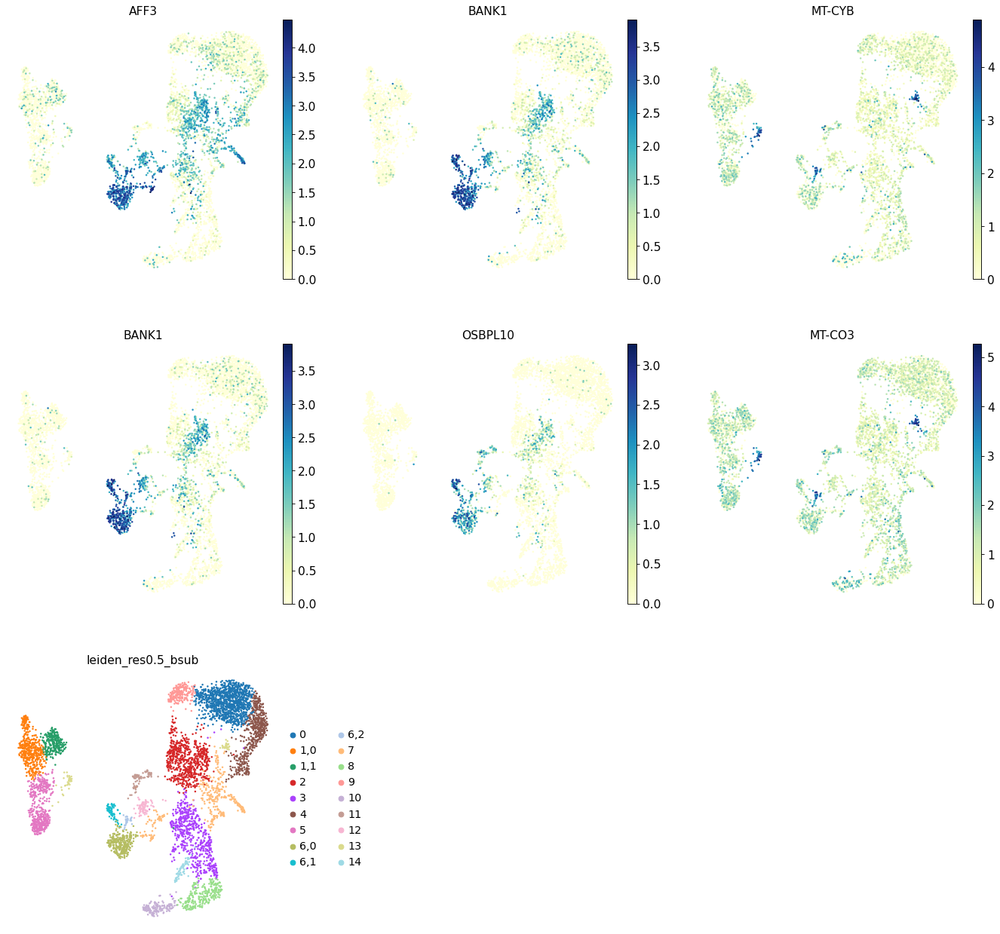

In [86]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [87]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

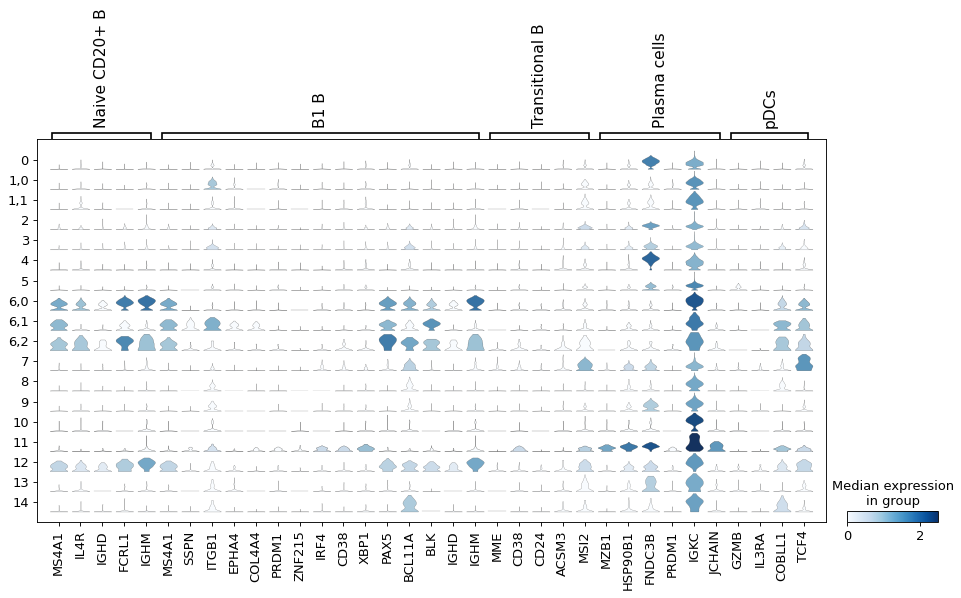

In [88]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Naive CD20+ B', 'B1 B', 
                                                                       'Transitional B', 'Plasma cells','pDCs']}, groupby=new_key)

This clearly separates two populations
- 6,0: Naive CD20+ B
- 6,1: B1 B (IGHD negative)
- 6,2: low quality B cells

### Cluster 7 - Transitional B, Lymph prog, HSC, etc.

In [89]:
orig_key = 'leiden_res0.5_bsub'
new_key = 'leiden_res0.5_bsub2'
new_rg_key = 'rg_res0.5_bsub2'
sub_key = '7'

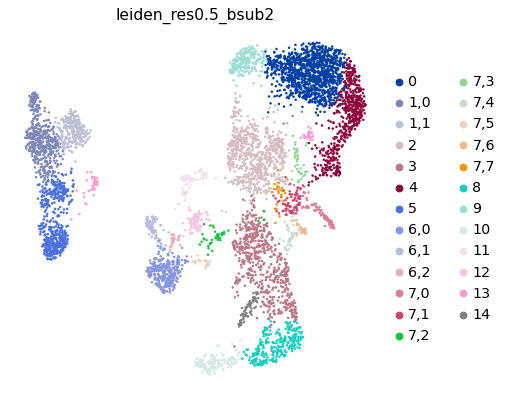

0      1132
2       706
3       586
4       541
5       482
1,0     475
6,0     316
1,1     269
8       257
9       224
10      153
7,0      94
11       81
12       79
6,1      76
7,1      72
13       66
14       65
7,2      40
7,3      39
7,4      38
7,5      31
7,6      30
6,2      29
7,7      25
Name: leiden_res0.5_bsub2, dtype: int64

In [90]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.4)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

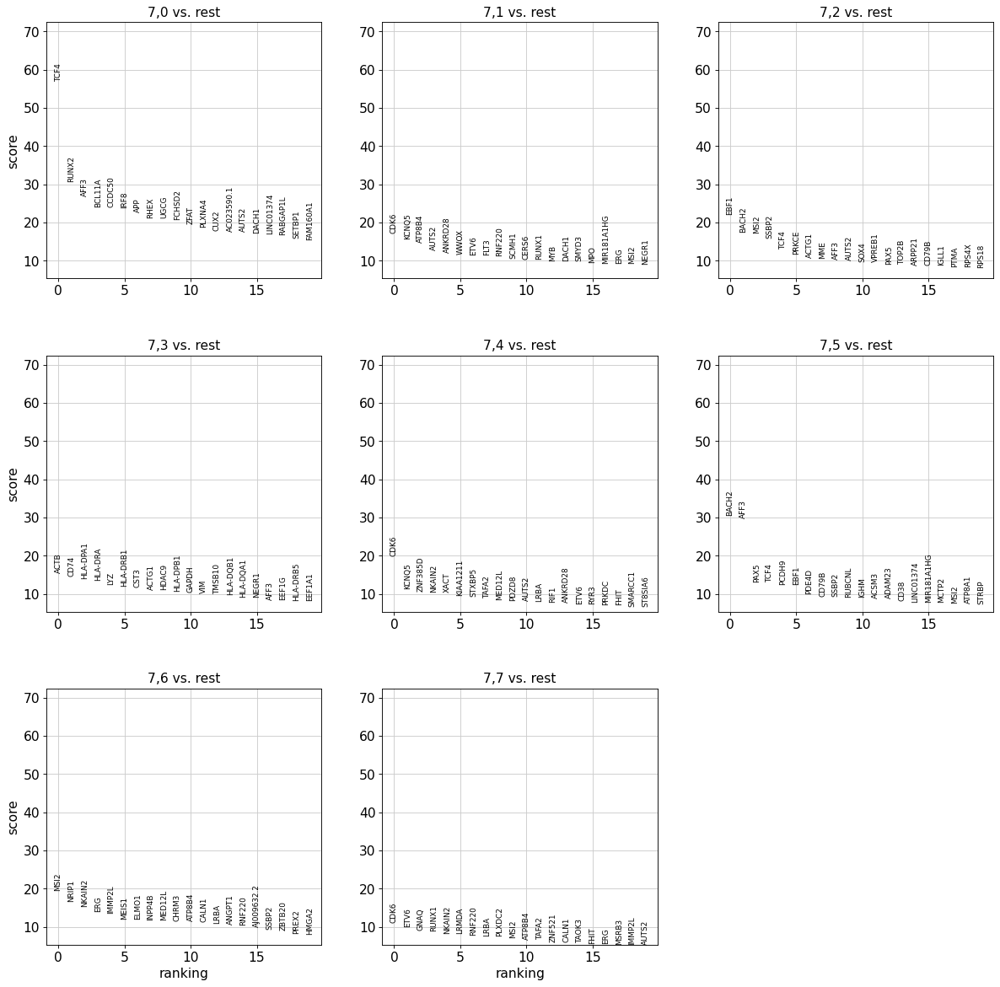

In [91]:
num_subclusts = 8
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

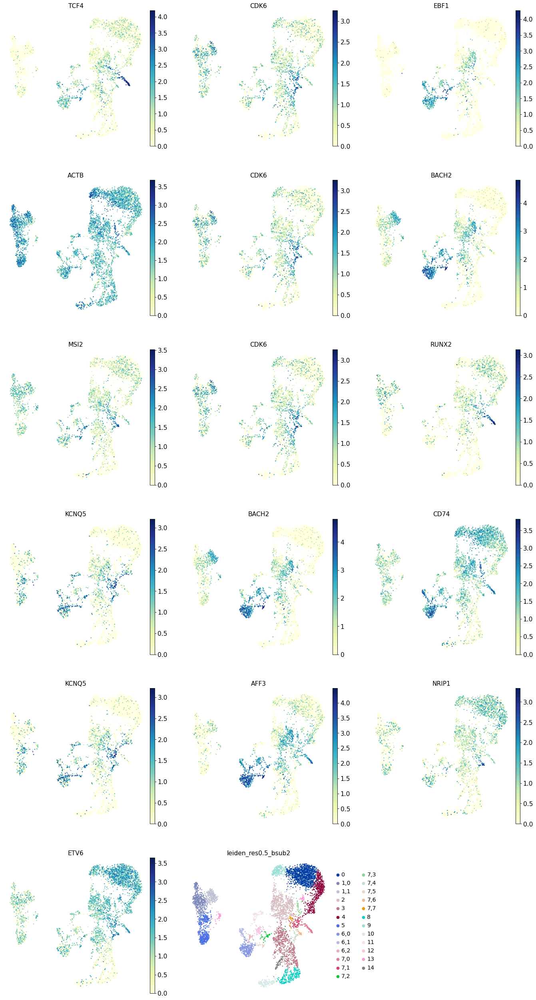

In [92]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [93]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

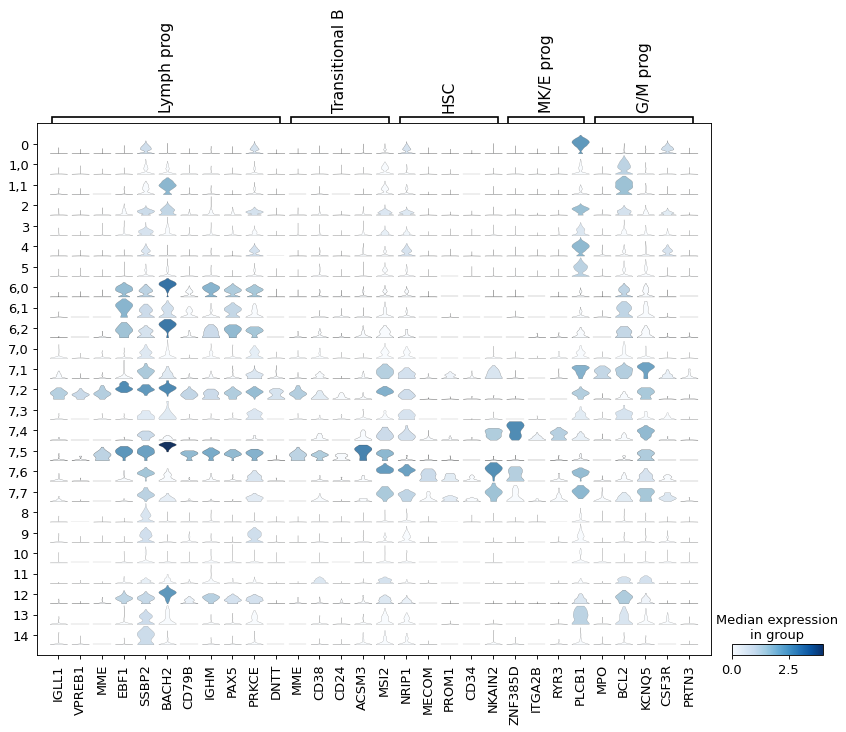

In [94]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Lymph prog','Transitional B','HSC','MK/E prog','G/M prog']}, groupby=new_key)

### Summary

8 subclusters: (as this was a huge cluster containing many cell types)
- 7,0: pDCs
- 7,1: G/M prog
- 7,2: Lymph prog
- 7,3: cDC2
- 7,4: MK/E prog
- 7,5: Transitional B (and Lymph prog?)
- 7,6: HSC
- 7,7: HSC

Merge the same clusters later on...

- 6,0: Naive CD20+ B
- 6,1: B1 B (IGHD negative)
- 6,2: low quality cells

## Erythrocyte precursors - cluster 3, 8, 10, 14

### Cluster 3

In [95]:
orig_key = 'leiden_res0.5_bsub2'
new_key = 'leiden_res0.5_epsub'
new_rg_key = 'rg_res0.5_epsub'
sub_key = '3'

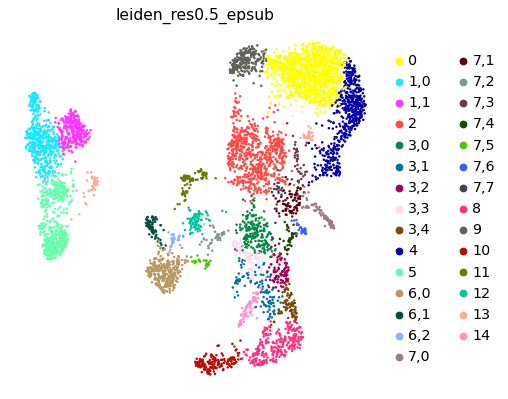

0      1132
2       706
4       541
5       482
1,0     475
6,0     316
1,1     269
8       257
9       224
3,0     191
10      153
3,1     117
3,2      97
7,0      94
3,3      94
3,4      87
11       81
12       79
6,1      76
7,1      72
13       66
14       65
7,2      40
7,3      39
7,4      38
7,5      31
7,6      30
6,2      29
7,7      25
Name: leiden_res0.5_epsub, dtype: int64

In [96]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.4)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

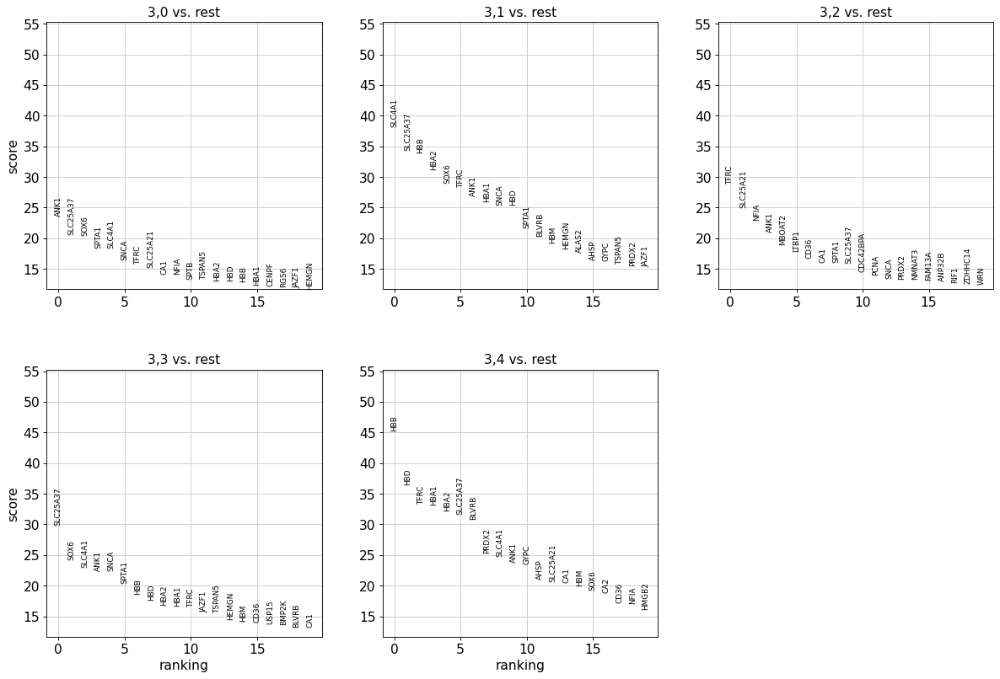

In [97]:
num_subclusts = 5
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

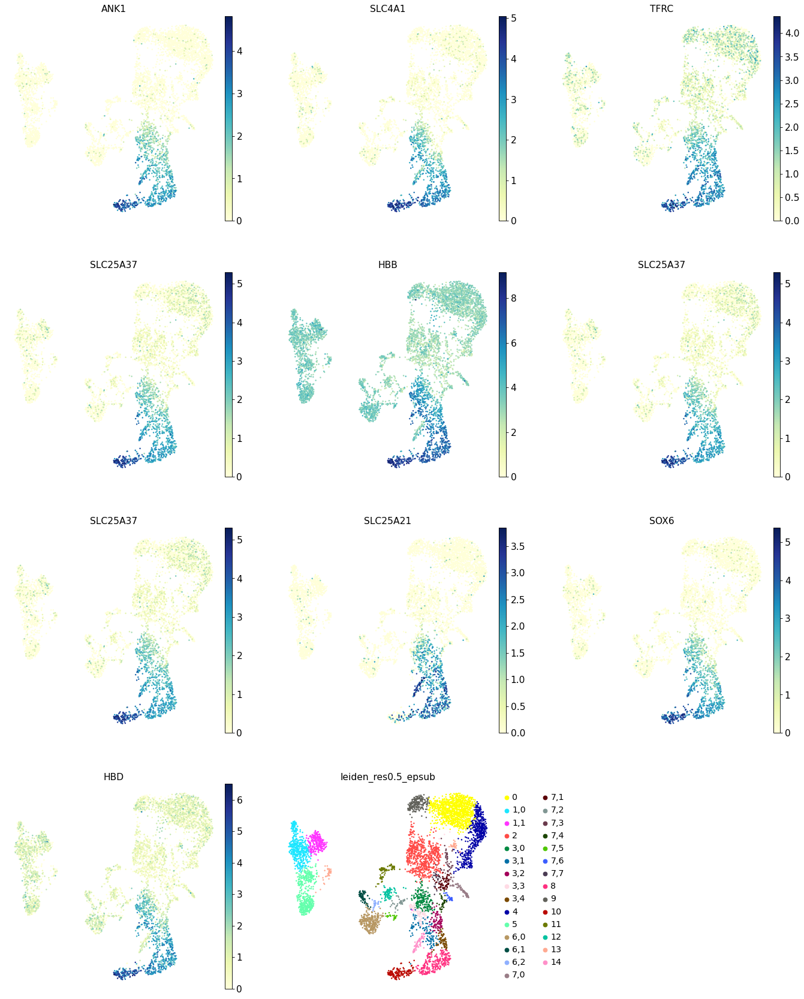

In [98]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

Now, let's check the cell-cycle for each sub-cluster.

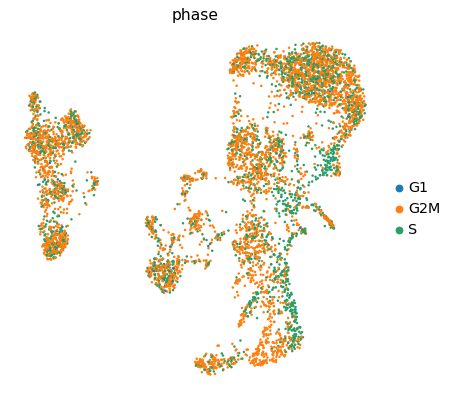

In [99]:
sc.pl.umap(adata_gex, color=['phase'])

In [100]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

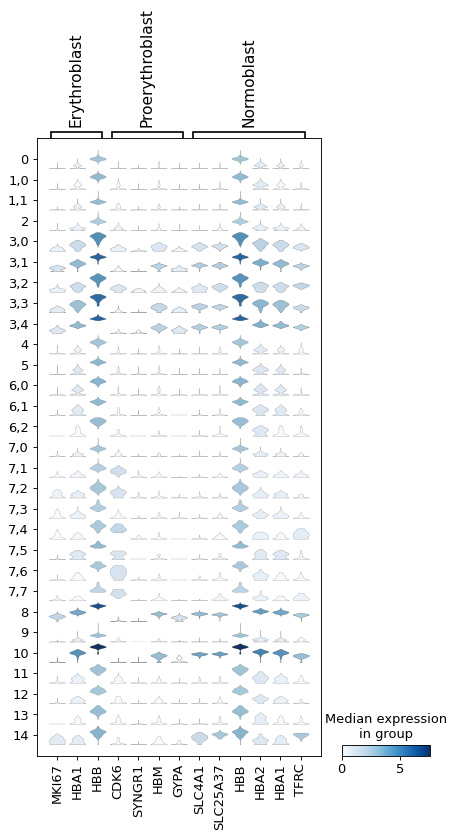

In [101]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Erythroblast', 'Proerythroblast','Normoblast']}, groupby=new_key)
# Note HBM and GYPA are negative markers for proerythroblasts!

#### Summary

- 3,0: Erythroblasts (doublets, high doublet score)
- 3,1: Erythroblast
- 3,2: Proerythroblast
- 3,3: doublets
- 3,4: Erythroblast

comments from ML: All of the cluster 3,0 is doublets.


### Cluster 8

In [102]:
orig_key = 'leiden_res0.5_epsub'
new_key = 'leiden_res0.5_epsub2'
new_rg_key = 'rg_res0.5_epsub2'
sub_key = '8'

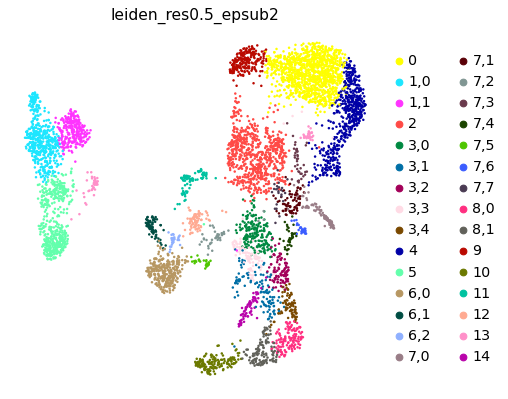

0      1132
2       706
4       541
5       482
1,0     475
6,0     316
1,1     269
9       224
3,0     191
10      153
8,0     131
8,1     126
3,1     117
3,2      97
3,3      94
7,0      94
3,4      87
11       81
12       79
6,1      76
7,1      72
13       66
14       65
7,2      40
7,3      39
7,4      38
7,5      31
7,6      30
6,2      29
7,7      25
Name: leiden_res0.5_epsub2, dtype: int64

In [103]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.3)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

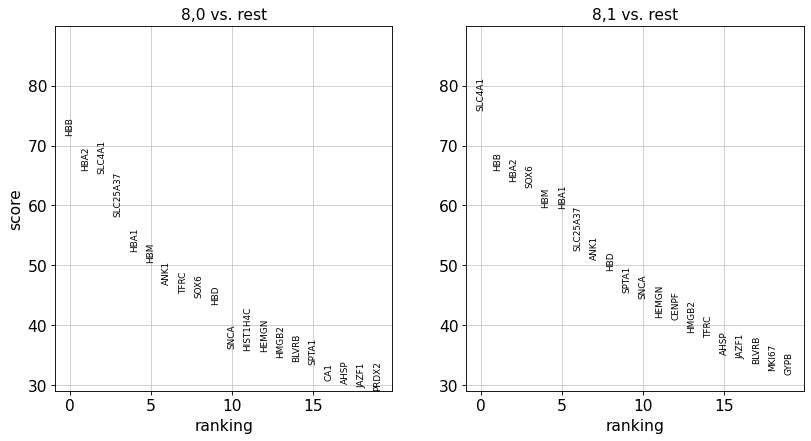

In [104]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

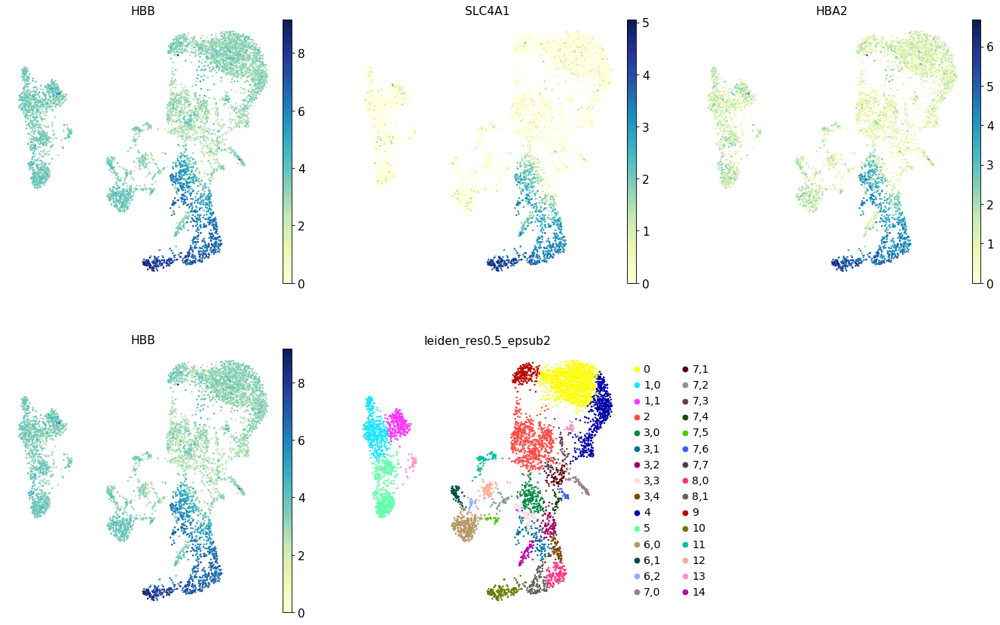

In [105]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

Now, let's check the cell-cycle for each sub-cluster.

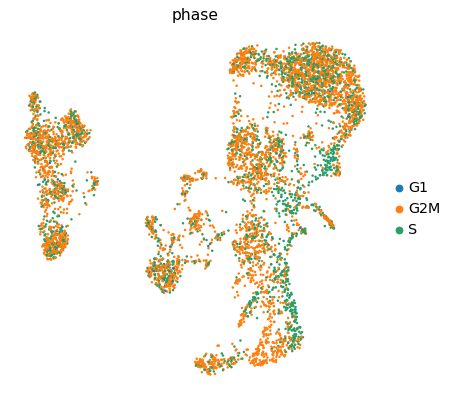

In [106]:
sc.pl.umap(adata_gex, color=['phase'])

It seems that the 2,1 subcluster contains cells with mostly at S phase.

In [107]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

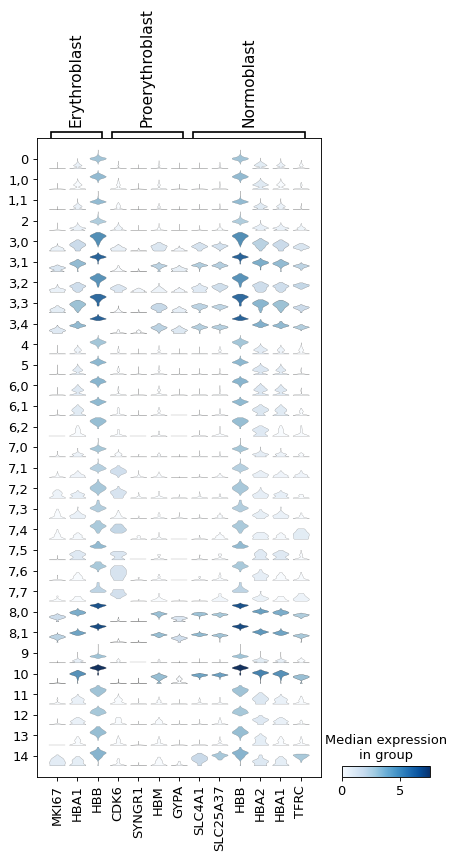

In [108]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Erythroblast', 'Proerythroblast','Normoblast']}, groupby=new_key)
# Note HBM and GYPA are negative markers for proerythroblasts!

#### Summary

**YJK to ML**: Not sure what to do with the subtle presence of Erythroblast here...

8,0 and 8,1 are very similar, thus we will not sub-cluster.
- 8: Erythroblast


### Cluster 10

In [109]:
orig_key = 'leiden_res0.5_epsub'
new_key = 'leiden_res0.5_epsub2'
new_rg_key = 'rg_res0.5_epsub2'
sub_key = '10'

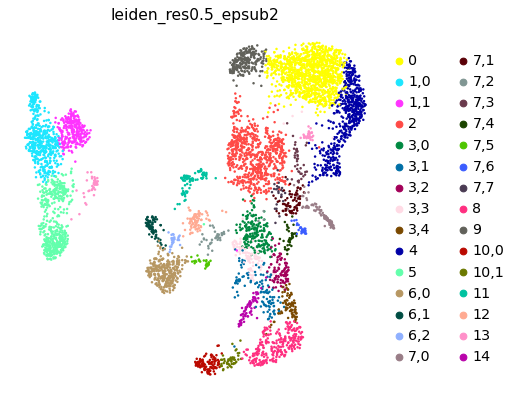

0       1132
2        706
4        541
5        482
1,0      475
6,0      316
1,1      269
8        257
9        224
3,0      191
3,1      117
10,0     105
3,2       97
3,3       94
7,0       94
3,4       87
11        81
12        79
6,1       76
7,1       72
13        66
14        65
10,1      48
7,2       40
7,3       39
7,4       38
7,5       31
7,6       30
6,2       29
7,7       25
Name: leiden_res0.5_epsub2, dtype: int64

In [110]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.3)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

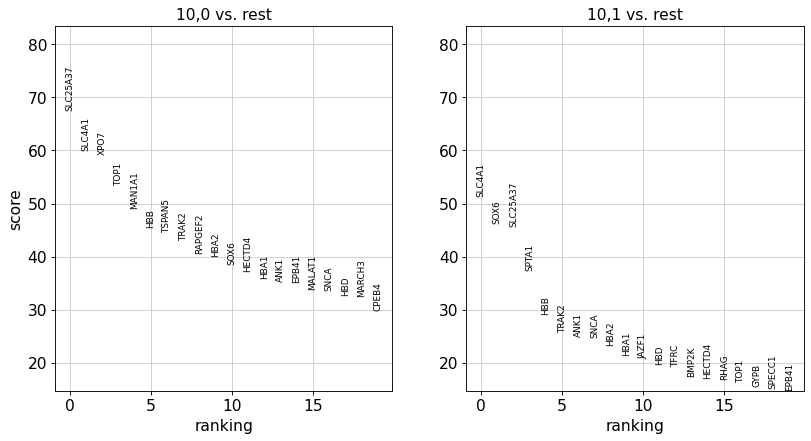

In [111]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

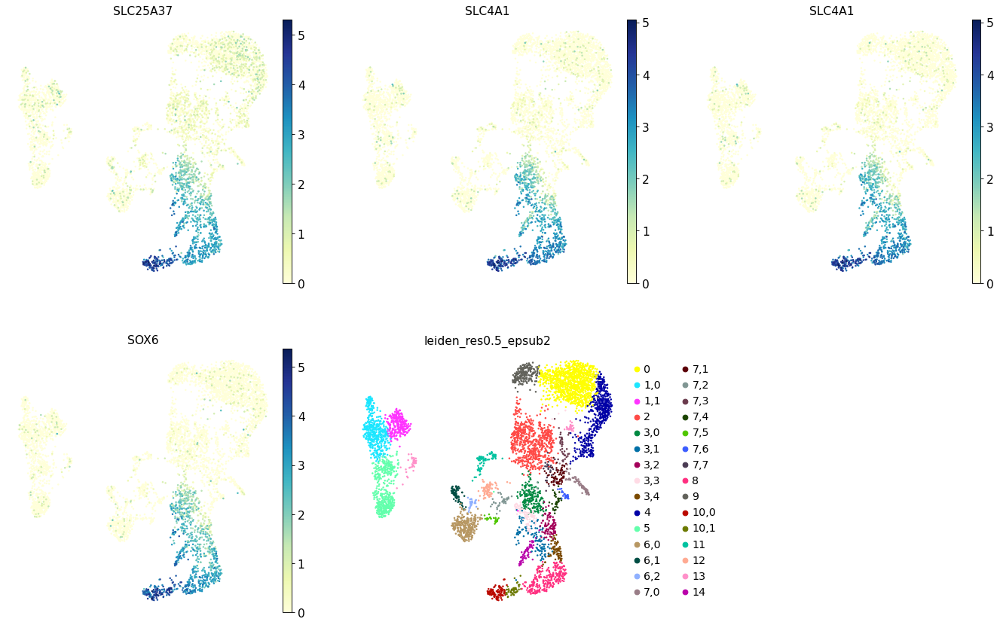

In [112]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

Now, let's check the cell-cycle for each sub-cluster.

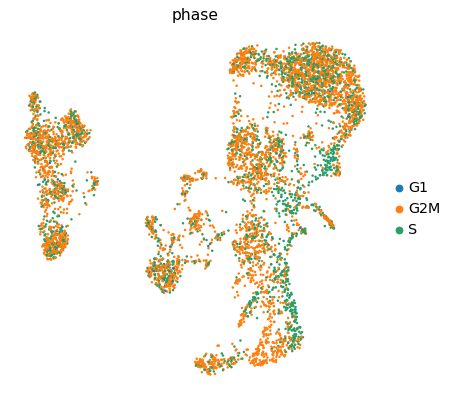

In [113]:
sc.pl.umap(adata_gex, color=['phase'])

It seems that the 2,1 subcluster contains cells with mostly at S phase.

In [114]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

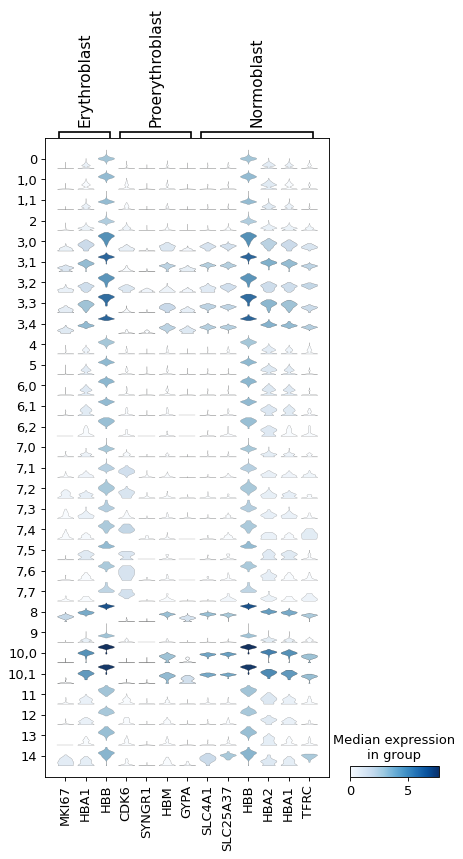

In [115]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Erythroblast', 'Proerythroblast','Normoblast']}, groupby=new_key)
# Note HBM and GYPA are negative markers for proerythroblasts!

#### Summary

10,0 and 10,1 look very similar, thus we will not sub-cluster.

- 10: Normoblast


### Cluster 14

In [116]:
orig_key = 'leiden_res0.5_epsub'
new_key = 'leiden_res0.5_epsub2'
new_rg_key = 'rg_res0.5_epsub2'
sub_key = '14'

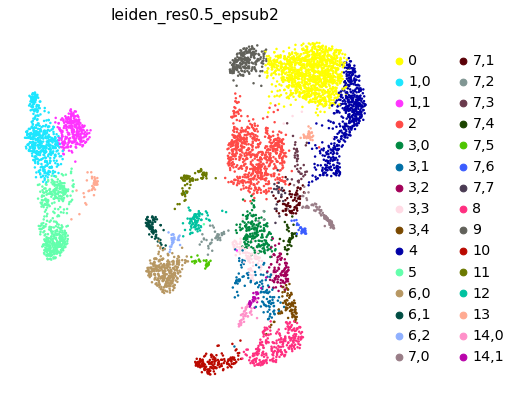

0       1132
2        706
4        541
5        482
1,0      475
6,0      316
1,1      269
8        257
9        224
3,0      191
10       153
3,1      117
3,2       97
3,3       94
7,0       94
3,4       87
11        81
12        79
6,1       76
7,1       72
13        66
7,2       40
7,3       39
14,0      39
7,4       38
7,5       31
7,6       30
6,2       29
14,1      26
7,7       25
Name: leiden_res0.5_epsub2, dtype: int64

In [117]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.3)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

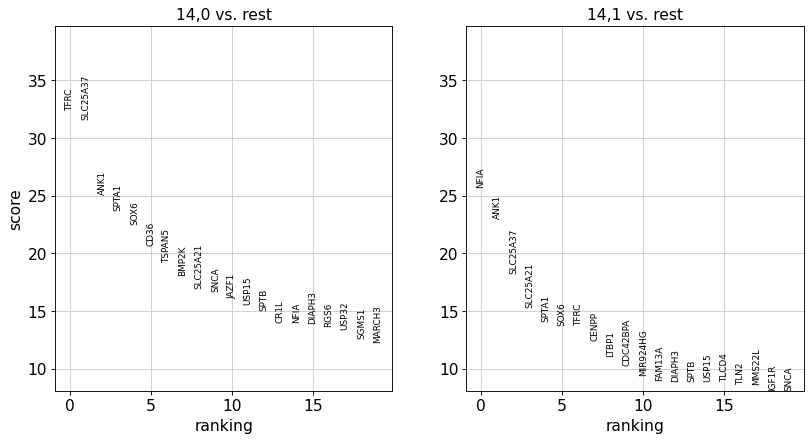

In [118]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

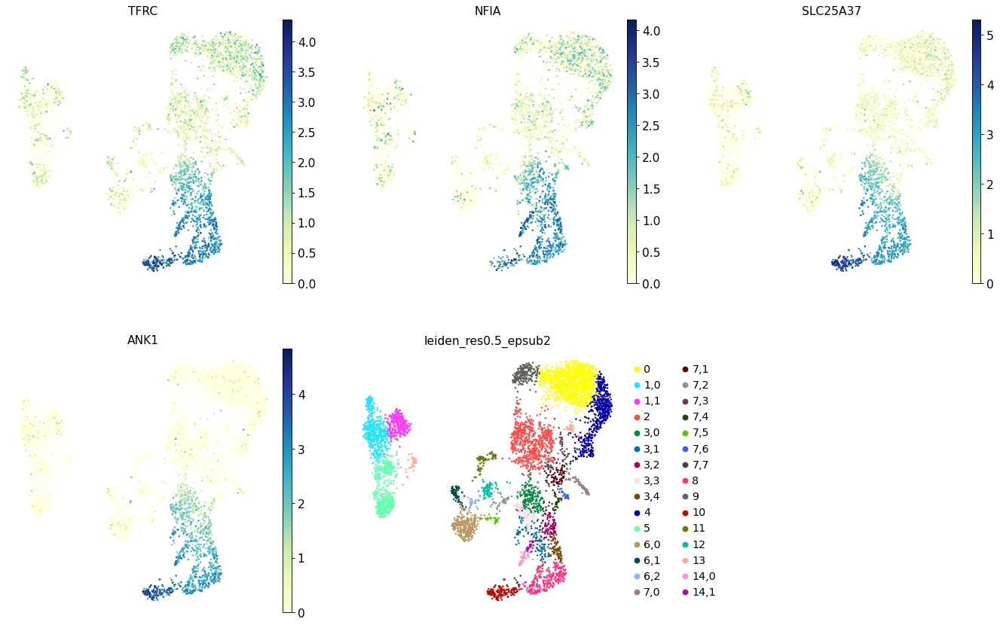

In [119]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

Now, let's check the cell-cycle for each sub-cluster.

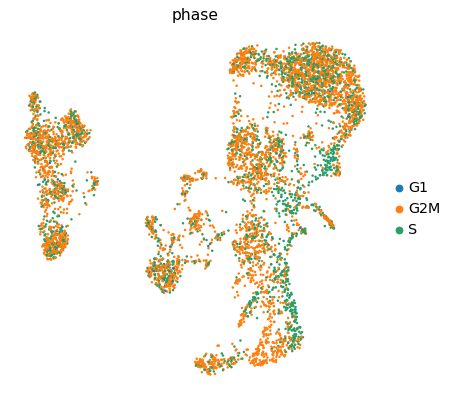

In [120]:
sc.pl.umap(adata_gex, color=['phase'])

It seems that the 2,1 subcluster contains cells with mostly at S phase.

In [121]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

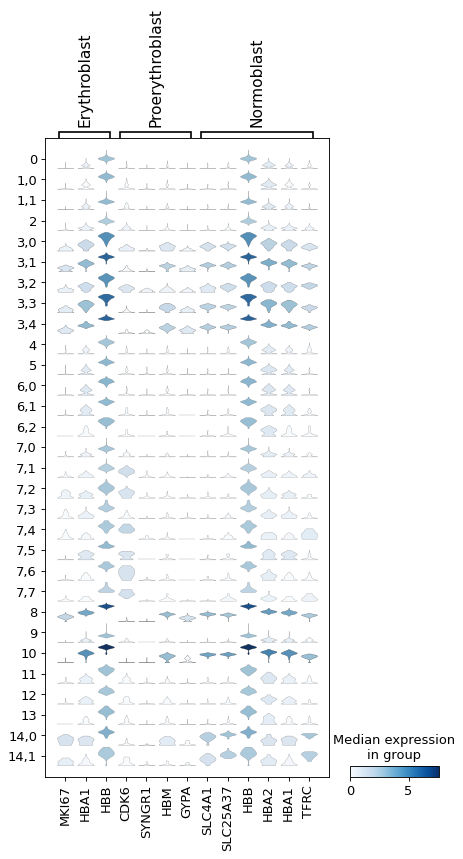

In [122]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Erythroblast', 'Proerythroblast','Normoblast']}, groupby=new_key)
# Note HBM and GYPA are negative markers for proerythroblasts!

#### Summary

- 14: Erythroblast


## NK and ILCs

### Cluster 5

In [123]:
orig_key = 'leiden_res0.5_epsub'
new_key = 'leiden_res0.5_5sub'
new_rg_key = 'rg_res0.5_5sub'
sub_key = '5'

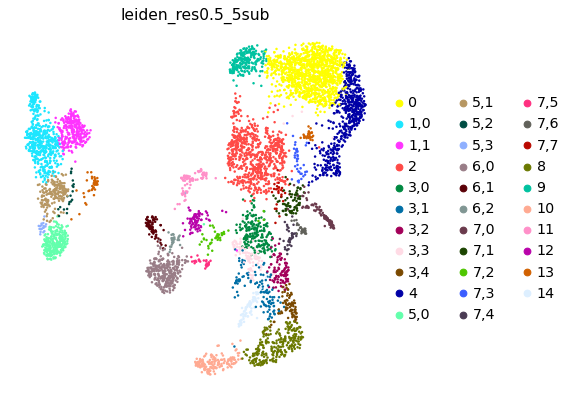

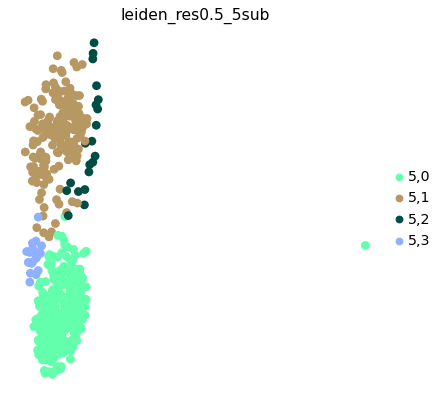

0      1132
2       706
4       541
1,0     475
6,0     316
1,1     269
5,0     265
8       257
9       224
3,0     191
5,1     179
10      153
3,1     117
3,2      97
3,3      94
7,0      94
3,4      87
11       81
12       79
6,1      76
7,1      72
13       66
14       65
7,2      40
7,3      39
7,4      38
7,5      31
7,6      30
6,2      29
7,7      25
5,2      20
5,3      18
Name: leiden_res0.5_5sub, dtype: int64

In [124]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.5)
sc.pl.umap(adata_gex, color=new_key)
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key)
adata_gex.obs[new_key].value_counts()

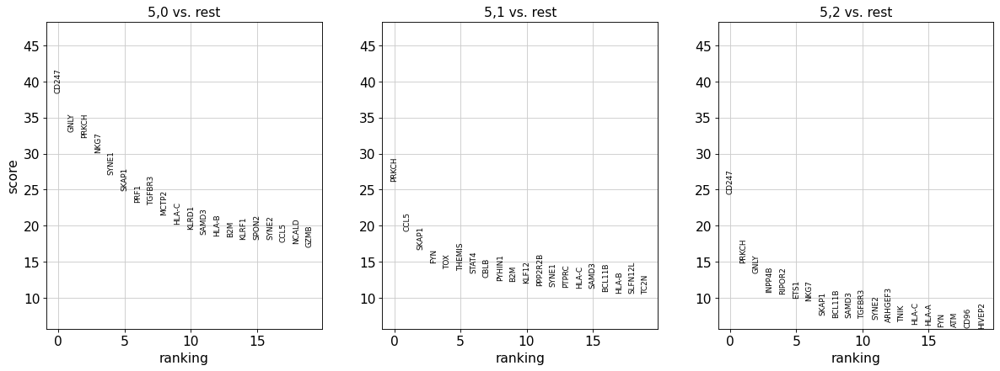

In [125]:
num_subclusts = 3
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

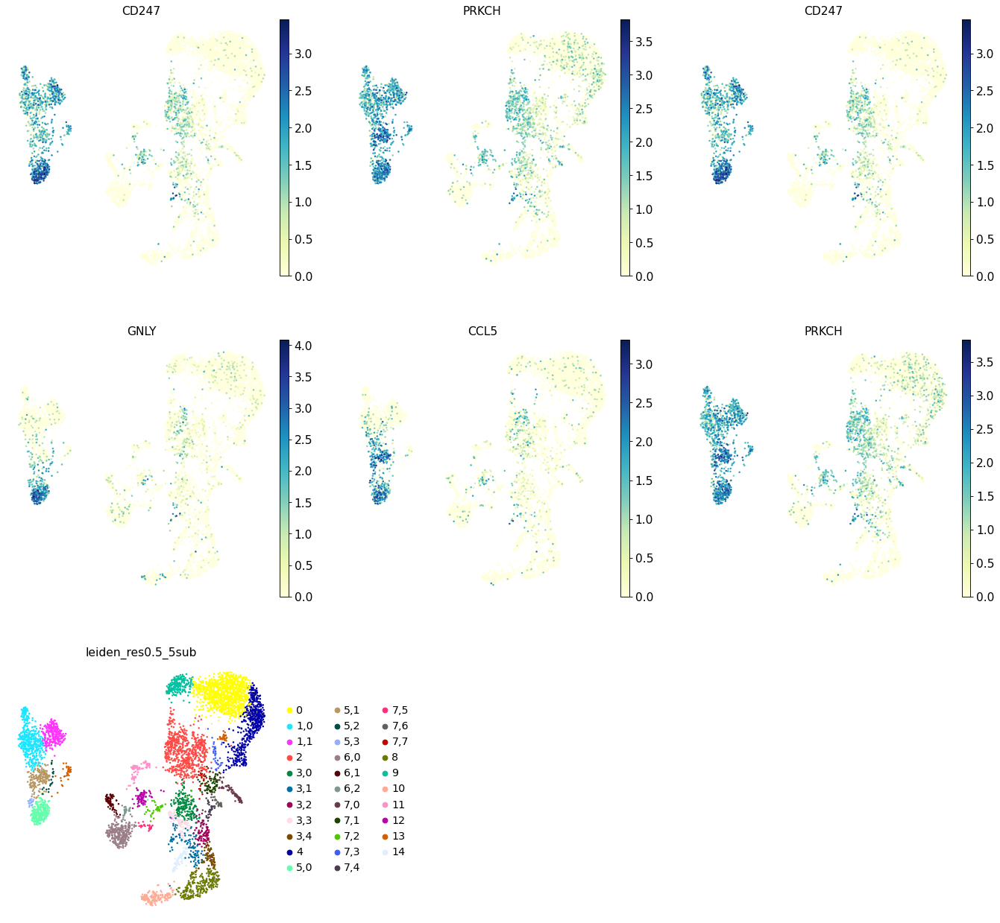

In [126]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [127]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

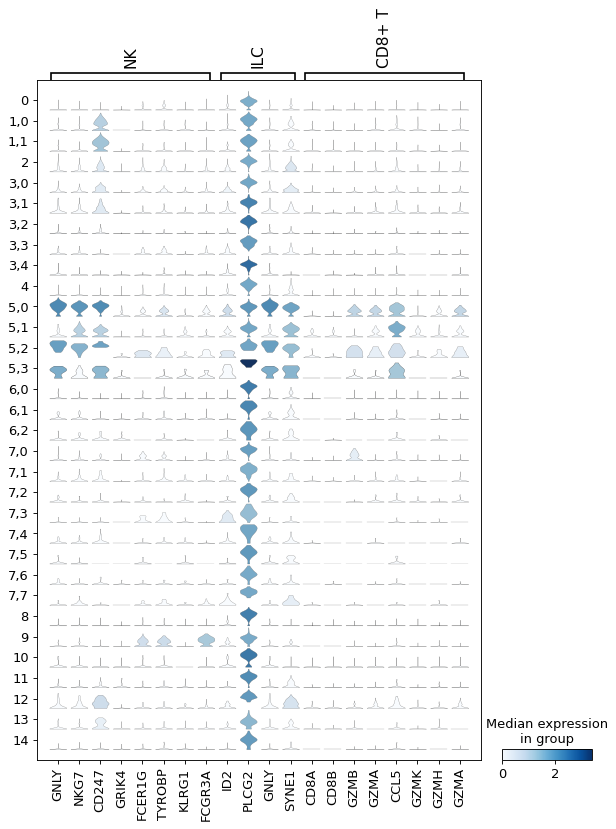

In [128]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['NK', 'ILC','CD8+ T']}, groupby=new_key)

### Summary

- 5,0: NK cells
- 5,1: CD8+ T
- 5,2: NK cells
- 5,3: ILC

## Further clustrering of B cells - cluster 11 and 12

### Cluster 11

In [129]:
orig_key = 'leiden_res0.5_5sub'
new_key = 'leiden_res0.5_bsub3'
new_rg_key = 'rg_res0.5_bsub3'
sub_key = '11'

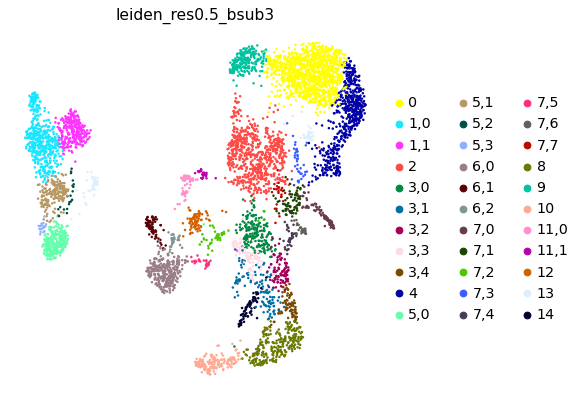

0       1132
2        706
4        541
1,0      475
6,0      316
1,1      269
5,0      265
8        257
9        224
3,0      191
5,1      179
10       153
3,1      117
3,2       97
3,3       94
7,0       94
3,4       87
12        79
6,1       76
7,1       72
13        66
14        65
11,0      53
7,2       40
7,3       39
7,4       38
7,5       31
7,6       30
6,2       29
11,1      28
7,7       25
5,2       20
5,3       18
Name: leiden_res0.5_bsub3, dtype: int64

In [130]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.2)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

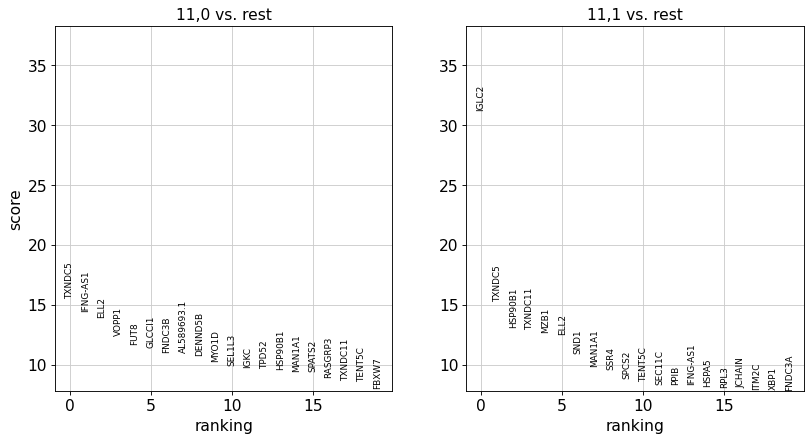

In [131]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

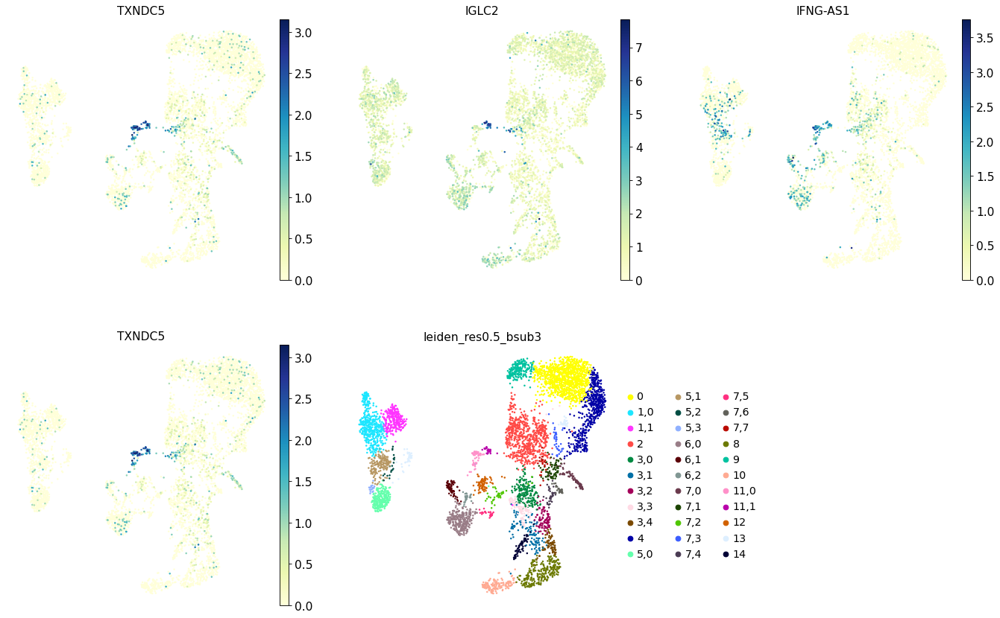

In [132]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [133]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

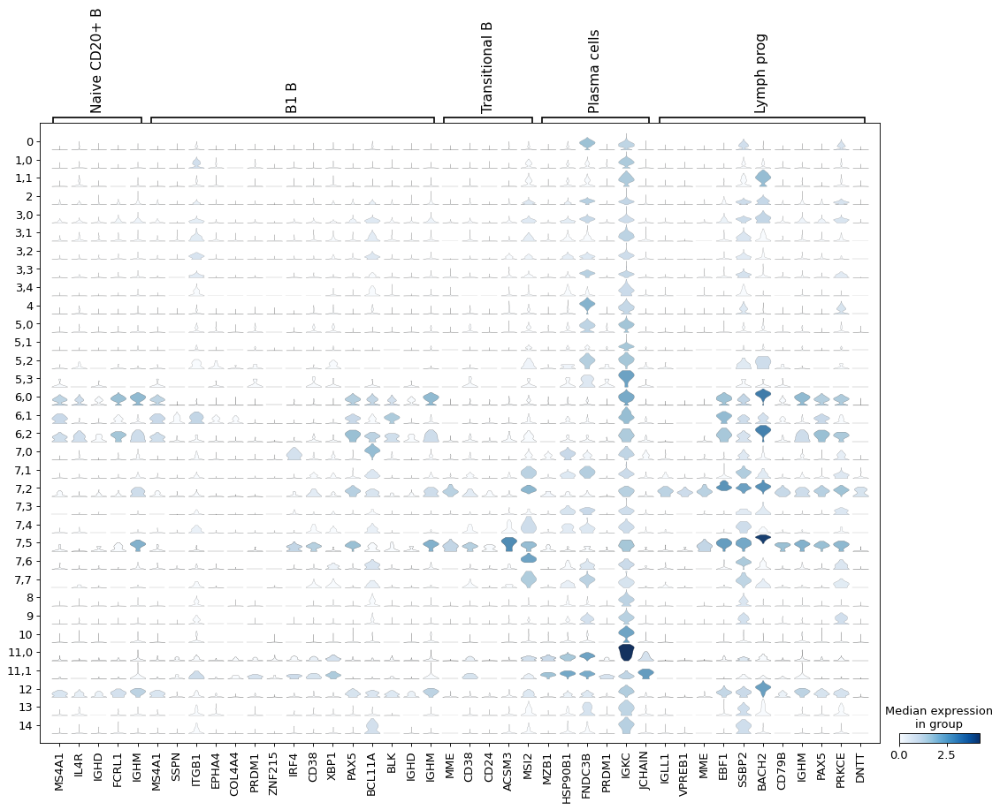

In [134]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Naive CD20+ B', 'B1 B', 
                                                                       'Transitional B', 'Plasma cells','Lymph prog']}, groupby=new_key)

Cluster 11 is a plasma cells population.

### Cluster 12

In [135]:
orig_key = 'leiden_res0.5_5sub'
new_key = 'leiden_res0.5_bsub4'
new_rg_key = 'rg_res0.5_bsub4'
sub_key = '12'

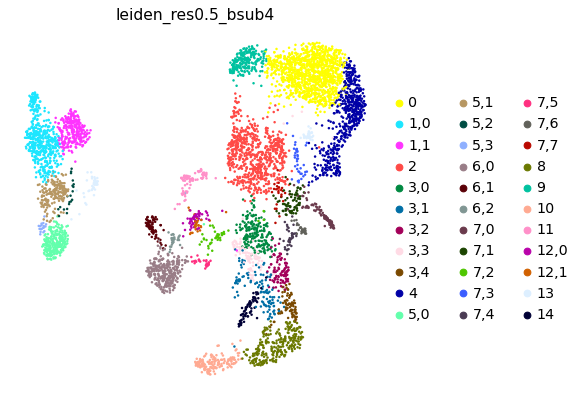

0       1132
2        706
4        541
1,0      475
6,0      316
1,1      269
5,0      265
8        257
9        224
3,0      191
5,1      179
10       153
3,1      117
3,2       97
3,3       94
7,0       94
3,4       87
11        81
6,1       76
7,1       72
13        66
14        65
12,0      53
7,2       40
7,3       39
7,4       38
7,5       31
7,6       30
6,2       29
12,1      26
7,7       25
5,2       20
5,3       18
Name: leiden_res0.5_bsub4, dtype: int64

In [136]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.4)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

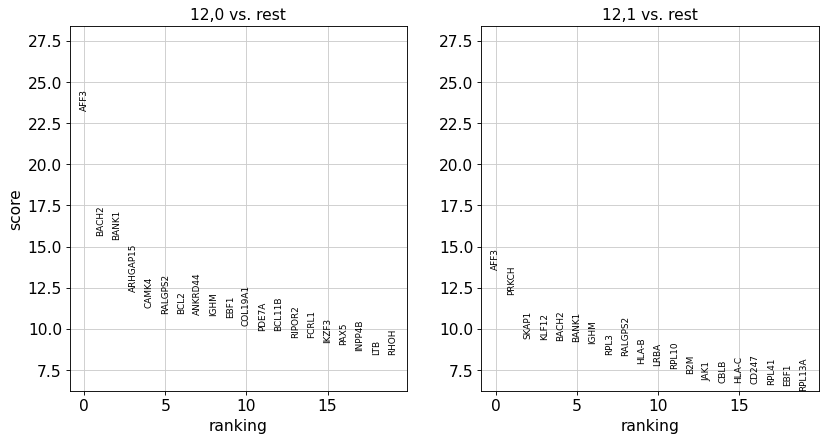

In [137]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

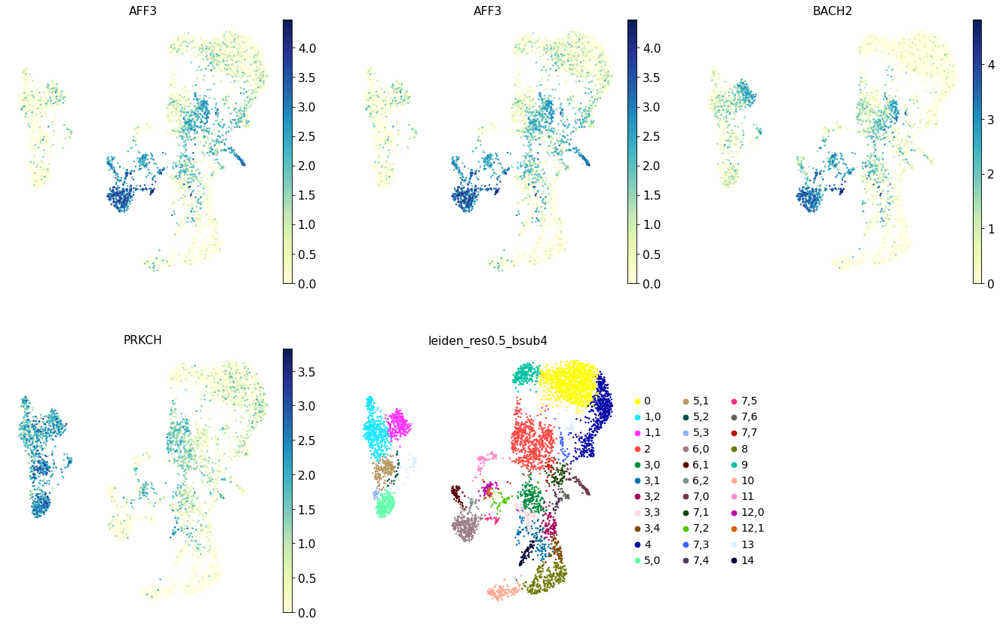

In [138]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [139]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

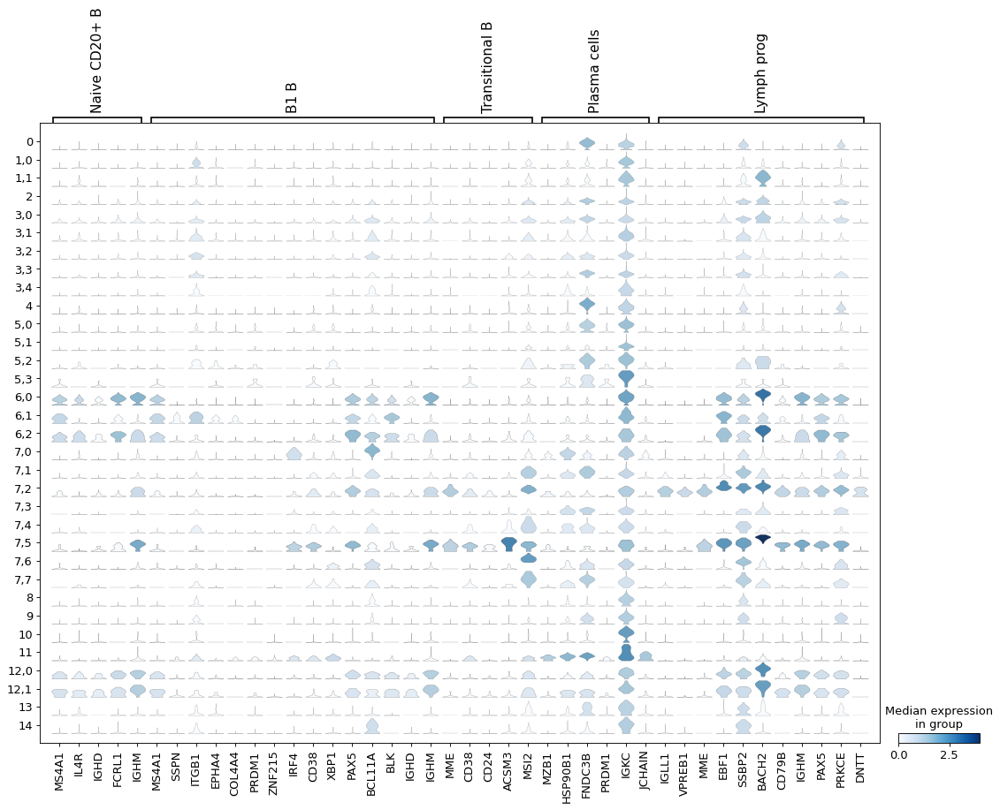

In [140]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Naive CD20+ B', 'B1 B', 
                                                                       'Transitional B', 'Plasma cells','Lymph prog']}, groupby=new_key)

Cluster 12 is Lymph prog.

## The doublet cluster - Cluster 13

### Cluster 13

In [141]:
orig_key = 'leiden_res0.5_5sub'
new_key = 'leiden_res0.5_doubsub'
new_rg_key = 'rg_res0.5_doubsub'
sub_key = '13'

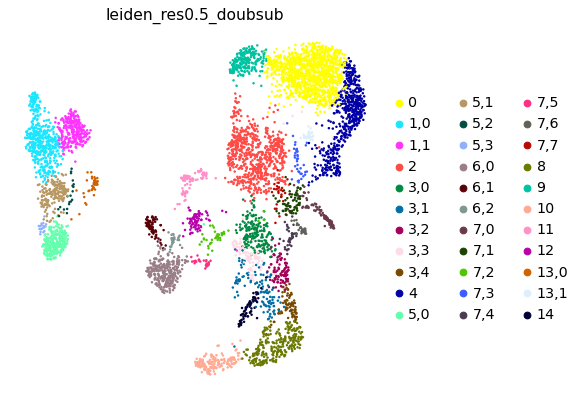

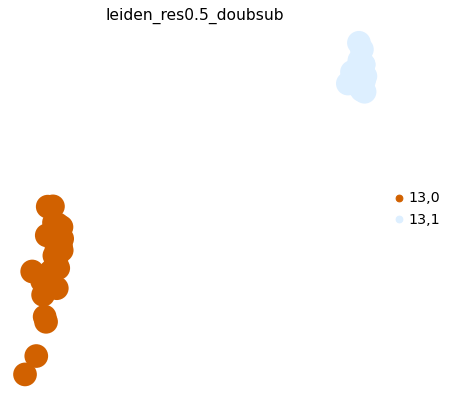

0       1132
2        706
4        541
1,0      475
6,0      316
1,1      269
5,0      265
8        257
9        224
3,0      191
5,1      179
10       153
3,1      117
3,2       97
3,3       94
7,0       94
3,4       87
11        81
12        79
6,1       76
7,1       72
14        65
7,2       40
7,3       39
7,4       38
13,0      38
7,5       31
7,6       30
6,2       29
13,1      28
7,7       25
5,2       20
5,3       18
Name: leiden_res0.5_doubsub, dtype: int64

In [142]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.3)
sc.pl.umap(adata_gex, color=new_key)
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key)
adata_gex.obs[new_key].value_counts()

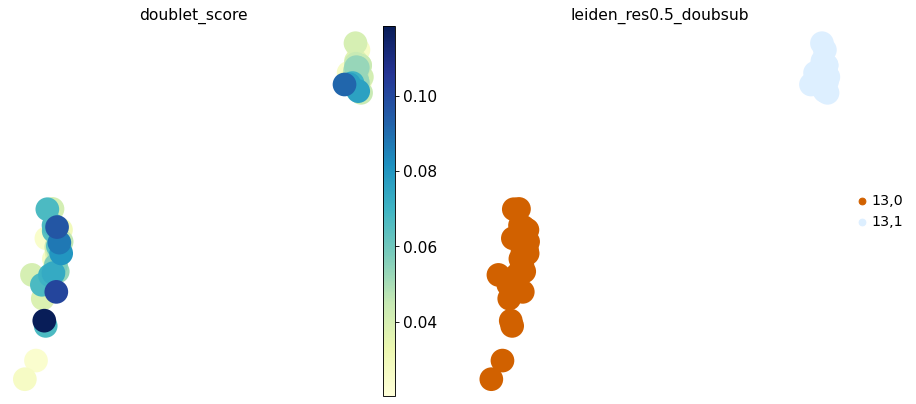

In [143]:
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=['doublet_score', new_key])


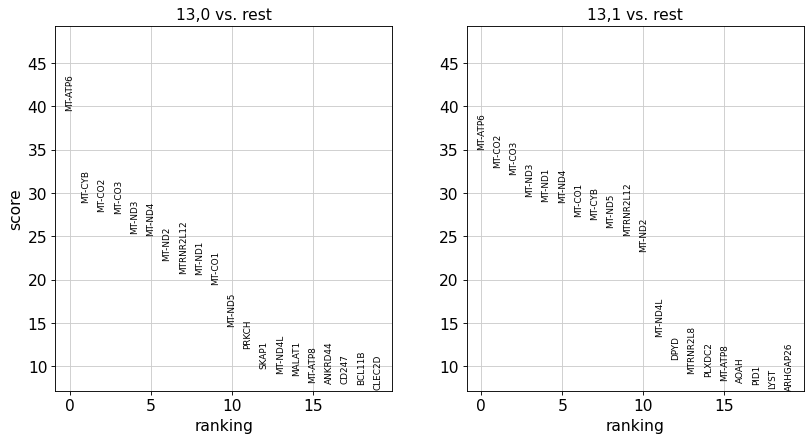

In [144]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

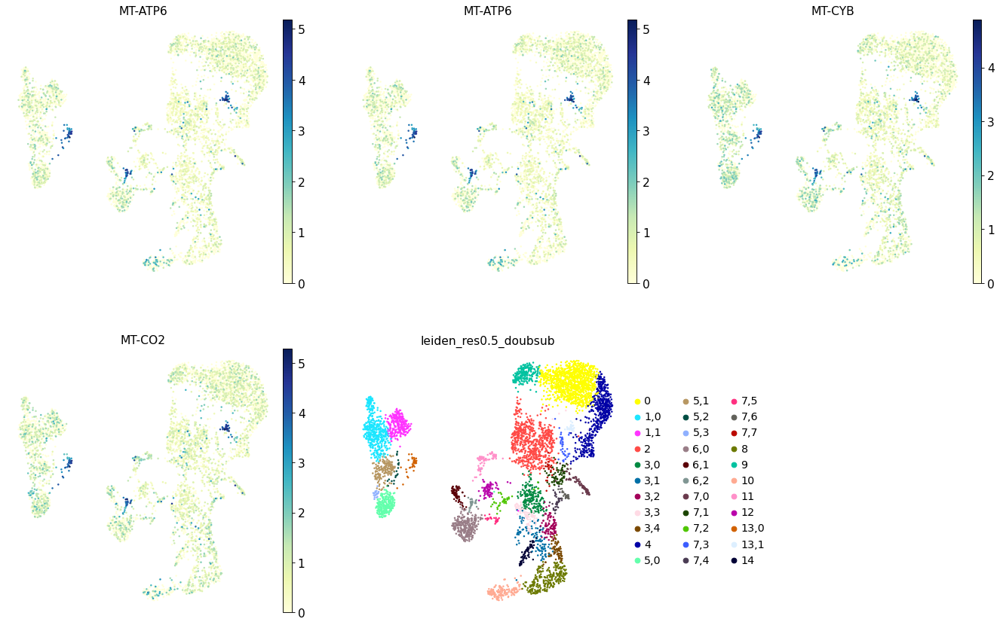

In [145]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [146]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

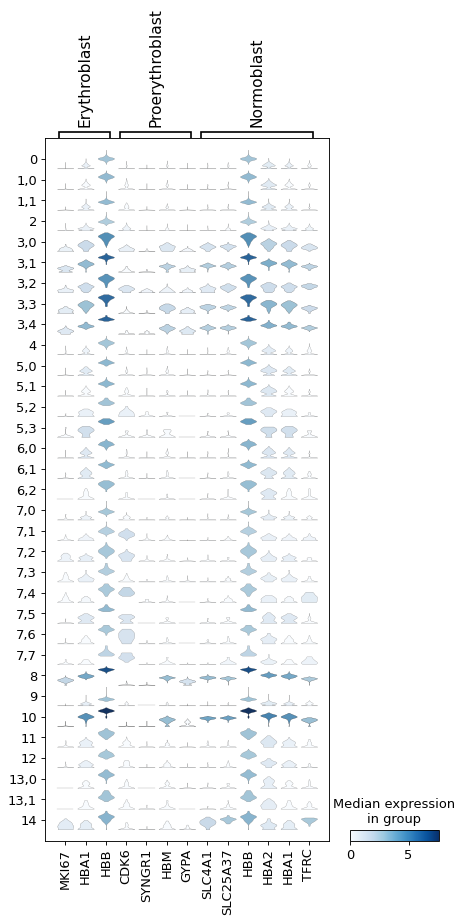

In [147]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Erythroblast', 'Proerythroblast','Normoblast']}, groupby=new_key)
# Note HBM and GYPA are negative markers for proerythroblasts!

### Summary

Cluster 13 seems to be a doublet cluster...let's see the gene expression below.

# Cluster overview

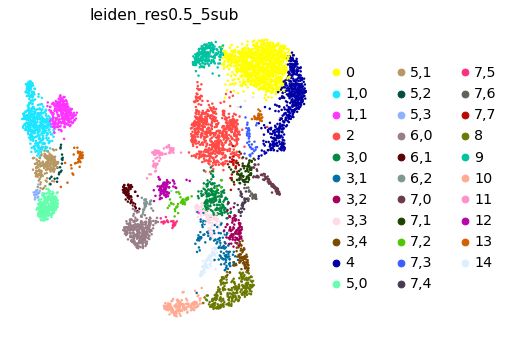

In [148]:
plt.rcParams['figure.figsize'] = (5,5)
sc.pl.umap(adata_gex, color='leiden_res0.5_5sub')
plt.rcParams['figure.figsize'] = (5,5)

## Doublet filtering

In [149]:
adata_gex.obs['leiden_res0.5_5sub'].value_counts()

0      1132
2       706
4       541
1,0     475
6,0     316
1,1     269
5,0     265
8       257
9       224
3,0     191
5,1     179
10      153
3,1     117
3,2      97
3,3      94
7,0      94
3,4      87
11       81
12       79
6,1      76
7,1      72
13       66
14       65
7,2      40
7,3      39
7,4      38
7,5      31
7,6      30
6,2      29
7,7      25
5,2      20
5,3      18
Name: leiden_res0.5_5sub, dtype: int64

In [150]:
np.sum(adata_gex.obs['leiden_res0.5_5sub'].value_counts())

5906

We will take doublet clusters (3,0 and 3,3), as well as low quality cells (with high MT gene counts, such as 13, and 6,2)

In [161]:
(706+191+94+66+29)/5096

0.2131083202511774

Filtered out cells:

=>  21.3%


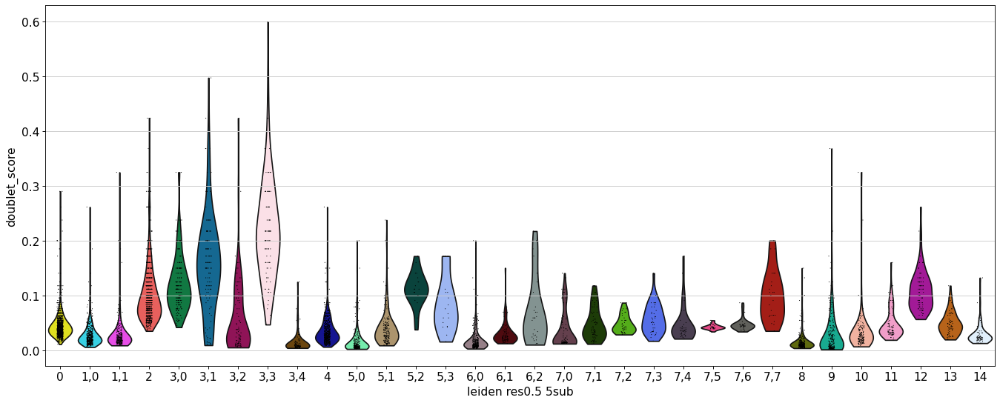

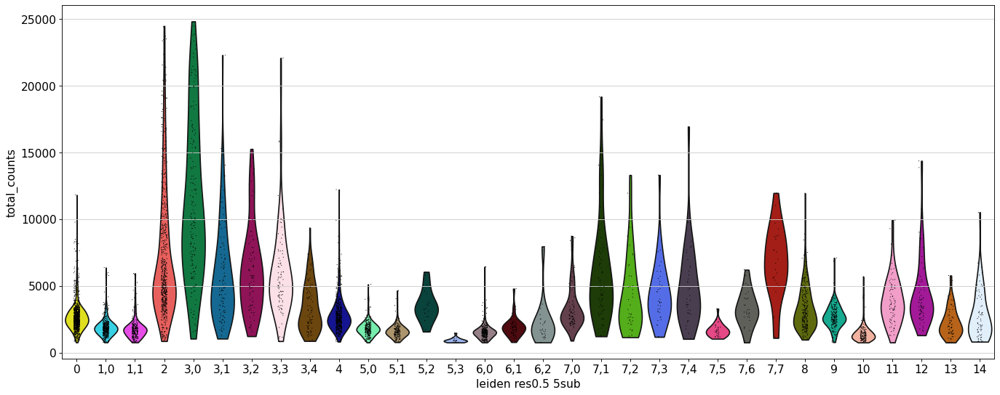

In [152]:
plt.rcParams['figure.figsize']=(16,8)
sc.pl.violin(adata_gex, keys='doublet_score', groupby='leiden_res0.5_5sub')
sc.pl.violin(adata_gex, keys='total_counts', groupby='leiden_res0.5_5sub')
plt.rcParams['figure.figsize']=(8,8)


Doublet clusters: Always lower expression than in their "parent" clusters; all RNA markers!
- B & T: 'CD24', 'CD22', 'ARHGAP24', 'BANK1', 'BACH2', 'AFF3', 'CD247', 'BCL11B', 'INPP4B', 'CAMK4', 'CD3D', 'TRBC2', 'IL7R'
- Erythro+others: 'HBB', 'HBA1', 'ANK1'
- Mono+B: 'PLXDC2', 'ARHGAP26', 'FCN1', 'AFF3', 'EBF1', 'BANK1', 'FCRL1', 'PAX5'
- Mono+T: 'PLXDC2', 'ARHGAP26', 'FCN1', 'BCL11B', 'SKAP1', 'CD247'

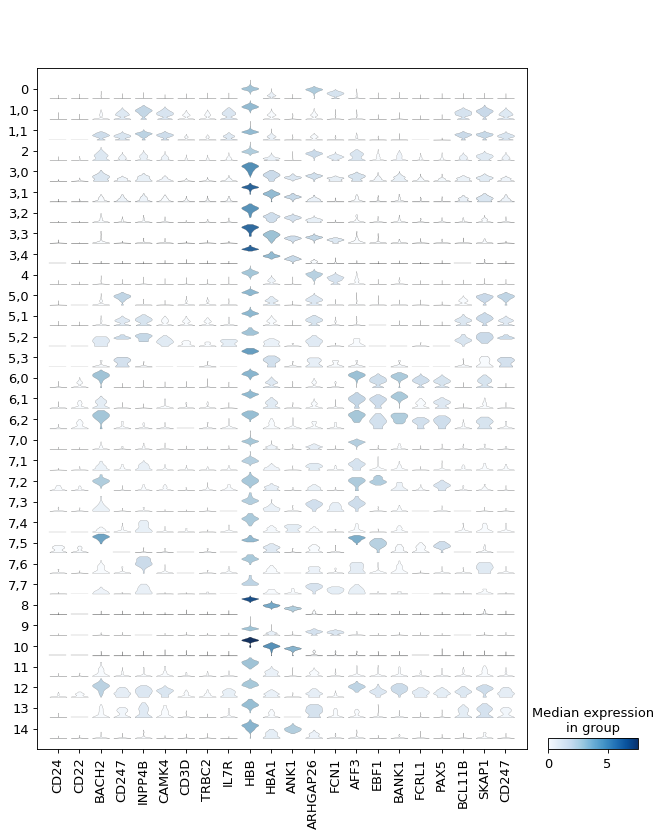

In [160]:
# Check the above markers again to make sure
sc.pl.stacked_violin(adata_gex, var_names=['CD24', 'CD22', 'BACH2', 'CD247', 'INPP4B', 'CAMK4', 'CD3D', 'TRBC2', 'IL7R', 
                                           'HBB', 'HBA1', 'ANK1', 'ARHGAP26', 'FCN1', 'AFF3', 'EBF1', 'BANK1', 'FCRL1', 'PAX5', 
                                           'BCL11B', 'SKAP1', 'CD247'], groupby='leiden_res0.5_5sub')

Indeed the likely doublet clusters have broad expression of all markers, and don't express any marker more highly than any other cell cluster that is not designated as doublet.

In [ ]:
adata_gex_filt = adata_gex[~adata_gex.obs['leiden_res0.5_5sub'].isin(['2','3,0','3,3','13','6,2'])].copy()

## Rename clusters

In [196]:
# Merge 0, 2 and 4
adata_gex_filt.obs['leiden_intermediate1'] = ['0' if c in ['0', '4'] else c for c in adata_gex_filt.obs['leiden_res0.5_5sub']]
# Merge 3,1, 3,4, 8 and 14,0 (Erythroblast)
adata_gex_filt.obs['leiden_intermediate2'] = ['8' if c in ['3,1','3,4','8','14'] else c for c in adata_gex_filt.obs['leiden_intermediate1']]
# Merge 7,2 and 12 (Lymph prog)
adata_gex_filt.obs['leiden_intermediate3'] = ['12' if c in ['7,2', '12'] else c for c in adata_gex_filt.obs['leiden_intermediate2']]
# Merge 7,6 and 7,7 (HSC)
adata_gex_filt.obs['leiden_intermediate4'] = ['7,6' if c in ['7,6', '7,7'] else c for c in adata_gex_filt.obs['leiden_intermediate3']]
# Merge 5,0 and 5,2
adata_gex_filt.obs['leiden_final'] = ['5,0' if c in ['5,0', '5,2'] else c for c in adata_gex_filt.obs['leiden_intermediate4']]

adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].astype('category')
adata_gex_filt.obs['leiden_final'].cat.categories
adata_gex_filt.obs['leiden_final'].value_counts()


0      1673
8       526
1,0     475
6,0     316
5,0     285
1,1     269
9       224
5,1     179
10      153
12      119
3,2      97
7,0      94
11       81
6,1      76
7,1      72
7,6      55
7,3      39
7,4      38
7,5      31
6,2      29
5,3      18
Name: leiden_final, dtype: int64

In [197]:
adata_gex_filt.obs['leiden_final'].cat.categories

Index(['0', '1,0', '1,1', '10', '11', '12', '3,2', '5,0', '5,1', '5,3', '6,0',
       '6,1', '6,2', '7,0', '7,1', '7,3', '7,4', '7,5', '7,6', '8', '9'],
      dtype='object')

In [198]:
rename_clust_dict = {
    '0':'CD14+ Mono', 
    '1,0':'CD4+ T activated',
    '8':'Erythroblast',
    '6,0':'naive CD20+ B', 
    '5,0':'NK', 
    '1,1':'CD4+ T naive',
    '9': 'CD16+ Mono',
    '5,1':'CD8+ T',
    '10':'Normoblast',
    '12':'Lymph prog',
    '3,2':'Proerythroblast',
    '7,0':'pDCs',
    '11':'Plasma cells',
    '6,1':'B1 B',
    '7,1':'G/M prog',
    '7,6':'HSC',
    '7,3':'cDC2',
    '7,4':'MK/E prog',
    '7,5':'Transitional B',
    '6,2':'low quality B cells',
    '5,3':'ILC'

}


In [199]:
# Note: this must be done in the same order as the categories above!
adata_gex_filt.rename_categories('leiden_final', [rename_clust_dict[ct] for ct in adata_gex_filt.obs['leiden_final'].cat.categories])

In [185]:
adata_gex_filt.obs['leiden_final'].cat.categories

Index(['CD14+ Mono', 'CD4+ T activated', 'CD4+ T naive', 'Normoblast',
       'Plasma cells', 'Lymph prog', 'Proerythroblast', 'NK', 'CD8+ T', 'ILC',
       'naive CD20+ B', 'B1 B', 'low quality B cells', 'pDCs', 'G/M prog',
       'cDC2', 'MK/E prog', 'Transitional B', 'HSC', 'Erythroblast',
       'CD16+ Mono'],
      dtype='object')

In [186]:
adata_gex_filt.obs_names

Index(['AAACATGCAACAGGTG-4', 'AAACATGCAGTCTAAT-4', 'AAACATGCAGTCTAGC-4',
       'AAACATGCATAGCTGC-4', 'AAACATGCATTAGCCA-4', 'AAACCGAAGGATCCGC-4',
       'AAACCGAAGGTCATTA-4', 'AAACCGCGTAACGAGG-4', 'AAACCGCGTACCGAAC-4',
       'AAACCGGCAGCAACCT-4',
       ...
       'TTTGTGAAGTGAGCAA-4', 'TTTGTGAAGTTCCTGC-4', 'TTTGTGAAGTTTAACG-4',
       'TTTGTGGCAATTGCGC-4', 'TTTGTGGCAGCTACGT-4', 'TTTGTGTTCAGCACGC-4',
       'TTTGTGTTCGTTATAG-4', 'TTTGTTGGTCCACAAA-4', 'TTTGTTGGTGAGGTAG-4',
       'TTTGTTGGTTTGGGTA-4'],
      dtype='object', length=4762)

In [ ]:
#adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].cat.reorder_categories(['CD14+ Mono', 'pDC', 'cDC2', 'pDC + cDC2' 'naive CD20+ B', 'B1 B', 
                            #'Transitional B', 'Plasma cell', 'HSC', 'G/M prog', 'Lymph prog', 'MK/E prog?', 'MK/E prog', 
                            #'Proerythroblast', 'Erythroblast', 'Reticulocyte', 'CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK'])
#data_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].cat.reorder_categories(['CD4+ T naive', 'CD4+ T activated', 'CD14+ Mono', 'G/M prog',
                            #Lymph prog', 'HSC', 'MK/E prog', 'pDC', 'Proerythroblast + Reticulocyte', 'Erythroblast + Reticulocyte',
                            #cDC2', 'Erythroblast', 'CD8+ T', 'NK', 'ILC',
                            #naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cell',
                            #Reticulocyte'])
#adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].cat.reorder_categories(['ID2-hi myeloid prog','CD14+ Mono','Erythroblast', 
#                'CD4+ T activated','Normoblast',  'naive CD20+ B', 'NK', 
#                'CD4+ T naive','CD16+ Mono','CD8+ T','Lymph prog','cDC2','Plasma cells','B1 B',
#                'G/M prog','pDCs','HSC','MK/E prog','Transitional B','Proerythroblast','ILC'])

... storing 'leiden_intermediate1' as categorical
... storing 'leiden_intermediate2' as categorical
... storing 'leiden_intermediate3' as categorical
... storing 'leiden_intermediate4' as categorical


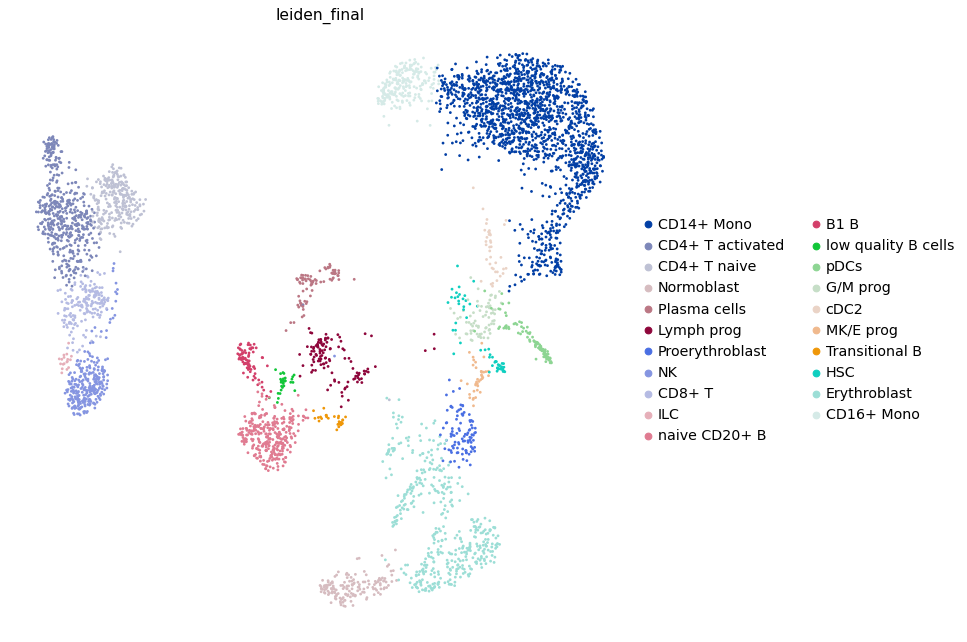

In [187]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_gex_filt, color='leiden_final')
plt.rcParams['figure.figsize'] = (8,8)

# Marker overview

In [188]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Normoblast', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

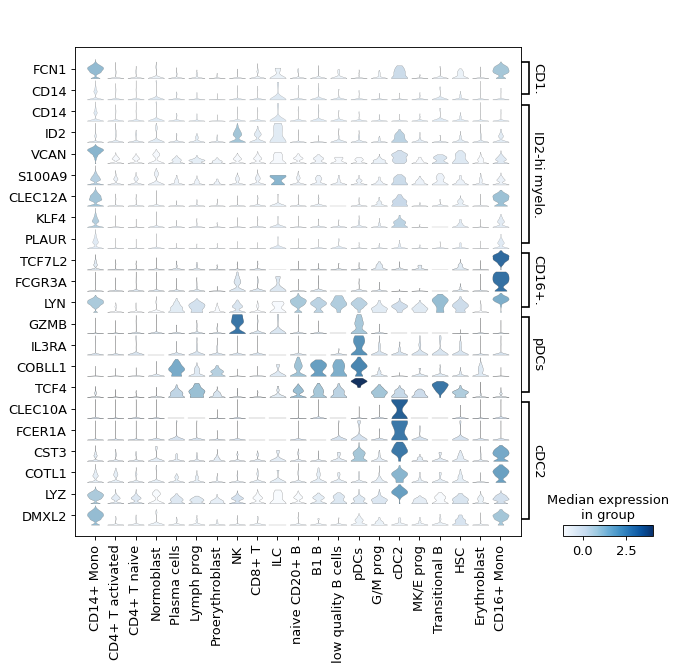

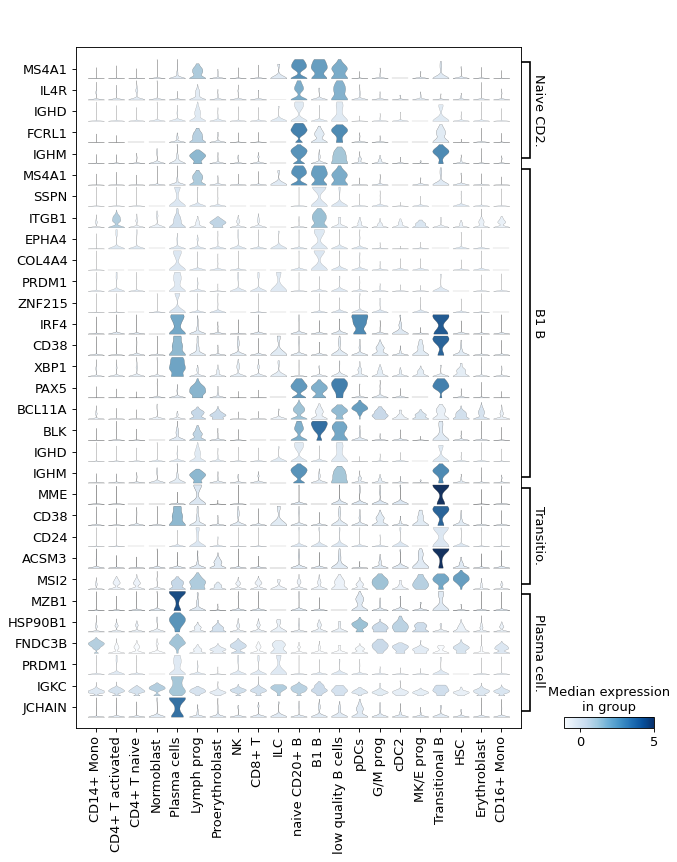

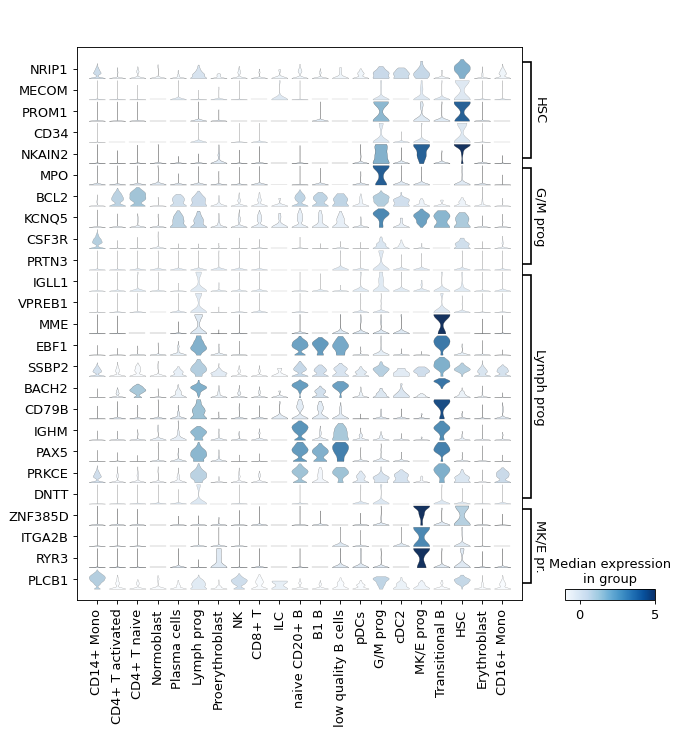

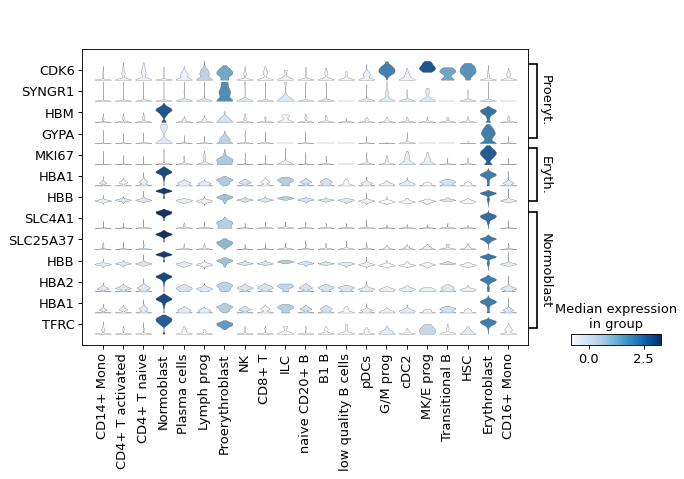

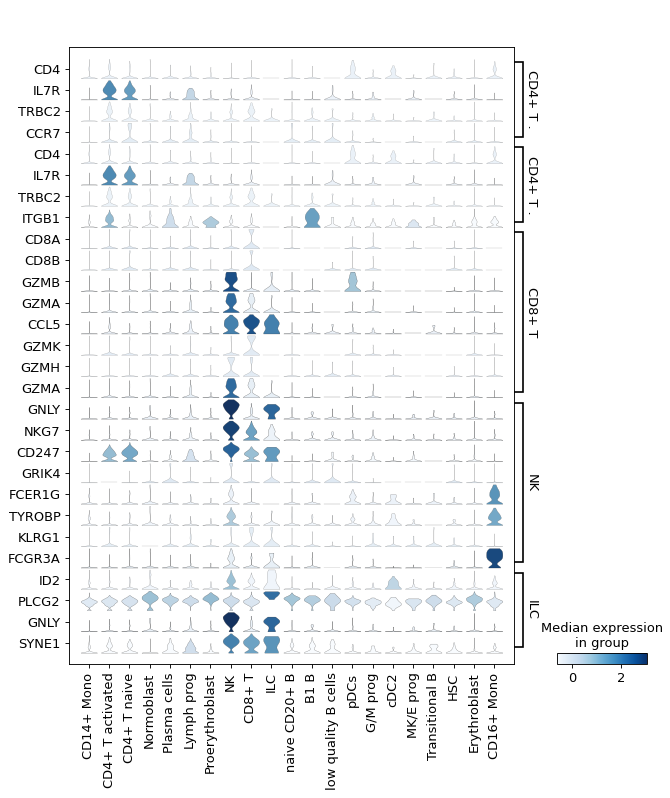

In [189]:
#Overview
adata_plot = adata_gex_filt.copy()
sc.pp.scale(adata_plot, max_value=5)

#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'ID2-hi myeloid prog', 'CD16+ Mono', 'pDCs', 'cDC2']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['HSC', 'G/M prog', 'Lymph prog', 'MK/E prog']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Proerythroblast', 'Erythroblast', 'Normoblast']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK', 'ILC']})



# Write output

In [190]:
adata_gex_filt

AnnData object with n_obs × n_vars = 4762 × 17431
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'S_score', 'G2M_score', 'phase', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_tsub', 'leiden_res0.5_msub', 'leiden_res0.5_msub2', 'leiden_res0.5_msub3', 'leiden_res0.5_msub4', 'leiden_res0.5_bsub', 'leiden_res0.5_bsub2', 'leiden_res0.5_epsub', 'leiden_res0.5_epsub2', 'leiden_res0.5_5sub', 'leiden_res0.5_bsub3', 'leiden_res0.5_bsub4', 'leiden_res0.5_doubsub', 'leiden_intermediate1', 'leiden_intermediate2', 'leiden_intermediate3', 'leiden_intermediate4', 'leiden_intermediate5', 'leiden_intermediate6', 'leiden_final'
    var: 'gene_ids', 'featur

In [193]:
adata_gex_filt_slim = adata_gex_filt.copy()
adata_gex_filt_slim.obs = adata_gex_filt_slim.obs.drop(columns=['log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 
                                                                'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'S_score', 'G2M_score', 
                                                                'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_tsub', 'leiden_res0.5_msub',  
                                                                'leiden_res0.5_msub2', 'leiden_res0.5_bsub', 'leiden_res0.5_epsub'])
adata_gex_filt_slim.var = adata_gex_filt_slim.var.drop(columns=['mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'means', 'dispersions', 'dispersions_norm'])

for i in ['phase_colors', 'leiden', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_genes_res0.5', 
           'rg_res0.5_msub', 'rg_res0.5_msub2', 'leiden_res0.5_bsub_colors', 'rg_res0.5_bsub', 
           'rg_res0.5_epsub', 
           'leiden_final_colors']:
    del adata_gex_filt_slim.uns[i]
    
adata_gex_filt_slim

AnnData object with n_obs × n_vars = 4762 × 17431
    obs: 'sample', 'n_genes_by_counts', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'phase', 'leiden_res0.5_msub3', 'leiden_res0.5_msub4', 'leiden_res0.5_bsub2', 'leiden_res0.5_epsub2', 'leiden_res0.5_5sub', 'leiden_res0.5_bsub3', 'leiden_res0.5_bsub4', 'leiden_res0.5_doubsub', 'leiden_intermediate1', 'leiden_intermediate2', 'leiden_intermediate3', 'leiden_intermediate4', 'leiden_intermediate5', 'leiden_intermediate6', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden_res0.5_tsub_colors', 'rg_res0.5_tsub', 'leiden_res0.5_msub_colors', 'leiden_res0.5_msub2_colors', 'leiden_res0.5_msub3_colors', 'rg_res0.5_msub3', 'leiden_res0.5_msub4_colors', 'rg_res0.5_msub4', 'leiden_res0.5_bsub2_colors', 'rg_res0.5_bsub2', 'leiden_res0.5_epsub_colors', 'leiden_res0.5_epsub2_colors', 'rg_res0.5_epsub2', 'leiden_res0.5_5sub_colors', 'rg_res

In [194]:
adata_gex_filt_slim.write('project/proc_data/s2d1/donor1_gex.h5ad')